In [1]:
import sys
sys.path.append('D:/s.velut/Documents/Thèse/Protheus_PHD/Scripts')
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
import seaborn as sns
import mne
from pyriemann.utils.viz import plot_waveforms
import sklearn
from sklearn import metrics
from sklearn.cluster import AffinityPropagation
from sklearn.preprocessing import normalize
from Alignments.covariance import compute_covariances
from scipy import stats
from skimage.measure import block_reduce
from pyriemann.utils.mean import mean_covariance
from pyriemann.utils.distance import distance
from Alignments.covariance import compute_covariances


c:\Users\s.velut\AppData\Local\anaconda3\Lib\site-packages\paramiko\transport.py:219: CryptographyDeprecationWarning: Blowfish has been deprecated and will be removed in a future release
  "class": algorithms.Blowfish,


# Load all the results

In [2]:
files_path = "D:/s.velut/Documents/Thèse/Protheus_PHD/Data/STL/ws0.35/frame/results/"
# participants = np.array(["P1","P17","P21","P15","P19","P23"])
participants = np.array(["P22","P17","P21","P15","P19","P2"]
)

name = ["tps_preproc", "tps_train", "tps_pred", "tps_acc", "score", "recall", "f1", "score_code"]
clf_name = "green"

tps_preproc = np.load(files_path+"tps_preproc_"+clf_name+".npy")
tps_train = np.load(files_path+"tps_train_"+clf_name+".npy")
tps_pred = np.load(files_path+"tps_pred_"+clf_name+".npy")
tps_acc = np.load(files_path+"tps_acc_"+clf_name+".npy")
score = np.load(files_path+"score_"+clf_name+"_SiSu.npy")
recall = np.load(files_path+"recall_"+clf_name+".npy")
f1 = np.load(files_path+"f1_"+clf_name+".npy")
score_code = np.load(files_path+"score_code_"+clf_name+".npy")


## Score accuracy

<Axes: >

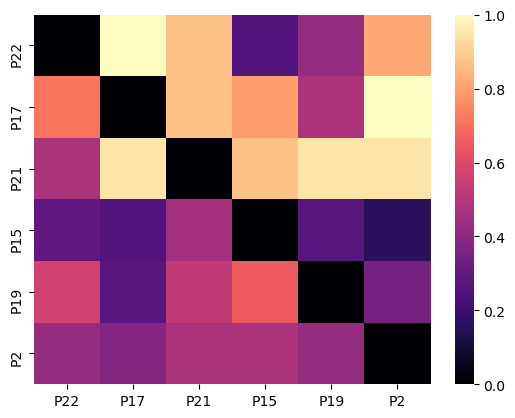

In [3]:
sns.heatmap(score_code, cmap='magma', xticklabels=participants,yticklabels=participants)


<Axes: >

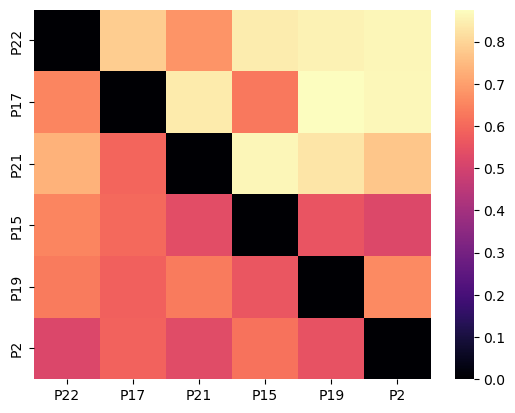

In [33]:
sns.heatmap(score, cmap='magma', xticklabels=participants,yticklabels=participants)


## Similarity

In [21]:
similarity = np.load(files_path+"similarity_"+clf_name+".npy",allow_pickle=True).item()

### Spearman correlation

In [22]:
spearman_sim_0 = np.zeros((len(participants),len(participants)))
spearman_sim_1 = np.zeros((len(participants),len(participants)))

for i,pt in enumerate(participants):
    for j,ps in enumerate(participants):
        if pt!=ps:
            sim = similarity[pt][ps]['Spearman Correlation']

            # calcul to change
            spearman_sim_0[i][j] = np.mean(sim[1])
            spearman_sim_1[i][j] = np.mean(sim[0])

Text(0.5, 1.0, 'Spearman correlation label 0')

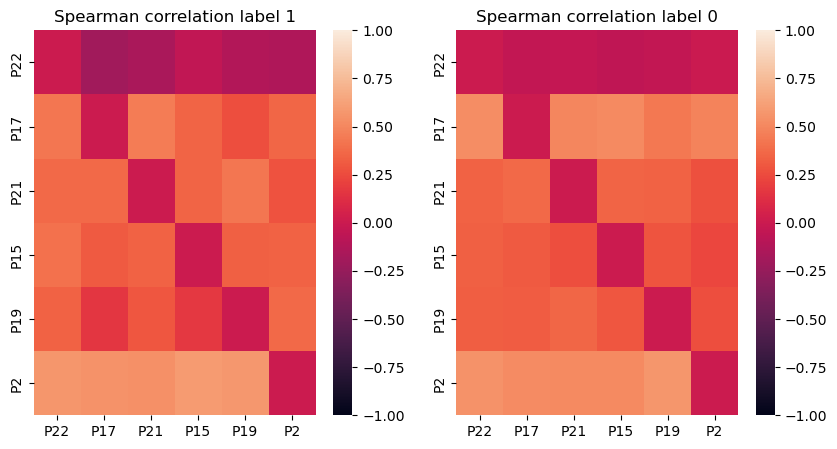

In [23]:
plt.figure(figsize=(10,5))
plt.subplot(1,2,1)
sns.heatmap(spearman_sim_1,xticklabels=participants,yticklabels=participants, vmin=-1, vmax=1)
plt.title("Spearman correlation label 1")
plt.subplot(1,2,2)
sns.heatmap(spearman_sim_0,xticklabels=participants,yticklabels=participants, vmin=-1, vmax=1)
plt.title("Spearman correlation label 0")


### Pearson correlation

In [24]:
pearson_sim_0 = np.zeros((len(participants),len(participants)))
pearson_sim_1 = np.zeros((len(participants),len(participants)))

for i,pt in enumerate(participants):
    for j,ps in enumerate(participants):

        if pt!=ps:
            sim = similarity[pt][ps]['Pearson Correlation']

            # calcul to change
            pearson_sim_0[i][j] = np.mean(sim[1][:,0])
            pearson_sim_1[i][j] = np.mean(sim[0][:,0])

Text(0.5, 1.0, 'pearson correlation label 0')

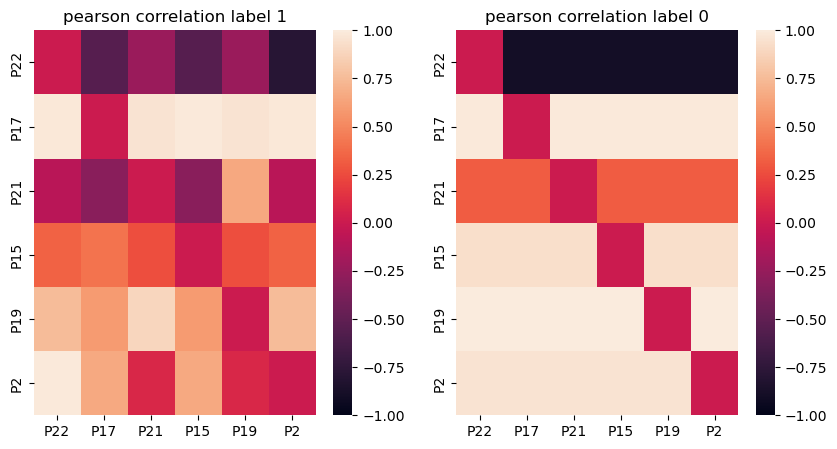

In [25]:
plt.figure(figsize=(10,5))
plt.subplot(1,2,1)
sns.heatmap(pearson_sim_1,xticklabels=participants,yticklabels=participants, vmin=-1, vmax=1)
plt.title("pearson correlation label 1")
plt.subplot(1,2,2)
sns.heatmap(pearson_sim_0,xticklabels=participants,yticklabels=participants, vmin=-1, vmax=1)
plt.title("pearson correlation label 0")


### Cosine similarity

In [26]:
cosine_sim_0 = np.zeros((len(participants),len(participants)))
cosine_sim_1 = np.zeros((len(participants),len(participants)))

for i,pt in enumerate(participants):
    for j,ps in enumerate(participants):

        if pt!=ps:
            sim = similarity[pt][ps]['Cosine Similarity']

            # calcul to change
            cosine_sim_0[i][j] = np.mean(np.diagonal(sim[1]))
            cosine_sim_1[i][j] = np.mean(np.diagonal(sim[0]))

In [27]:
cosine_sim_1

array([[  0.        , -36.71454854, -36.72962208, -36.88481262,
        -36.6376134 , -36.49676757],
       [ 38.17362136,   0.        ,  38.31419011,  37.94370949,
         37.96650373,  37.99924318],
       [ 41.51962908,  41.5848409 ,   0.        ,  41.65983911,
         41.67111261,  41.35973425],
       [ 33.36859147,  33.20261089,  33.3044072 ,   0.        ,
         33.21905418,  33.20231186],
       [ 37.88041028,  37.38488338,  37.61939558,  37.51100547,
          0.        ,  37.78688359],
       [ 61.82842722,  61.89329334,  61.76311135,  61.78821239,
         62.27148451,   0.        ]])

Text(0.5, 1.0, 'cosine correlation label 0')

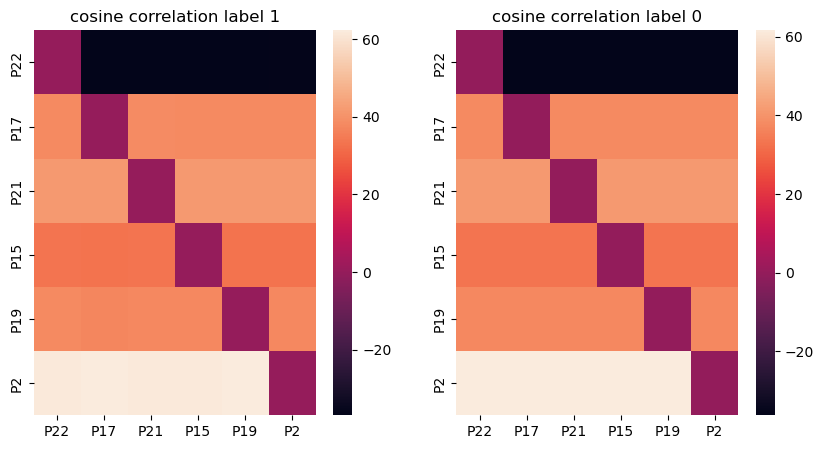

In [28]:
plt.figure(figsize=(10,5))
plt.subplot(1,2,1)
sns.heatmap(cosine_sim_1,xticklabels=participants,yticklabels=participants)
plt.title("cosine correlation label 1")
plt.subplot(1,2,2)
sns.heatmap(cosine_sim_0,xticklabels=participants,yticklabels=participants)
plt.title("cosine correlation label 0")


### Riemannian distance similarity

In [29]:
rieman_sim_0 = np.zeros((len(participants),len(participants)))
rieman_sim_1 = np.zeros((len(participants),len(participants)))

for i,pt in enumerate(participants):
    for j,ps in enumerate(participants):

        if pt!=ps:
            sim = similarity[pt][ps]['Riemannian Similarity']

            # calcul to change
            rieman_sim_0[i][j] = sim[1]
            rieman_sim_1[i][j] = sim[0]

Text(0.5, 1.0, 'rieman correlation label 0')

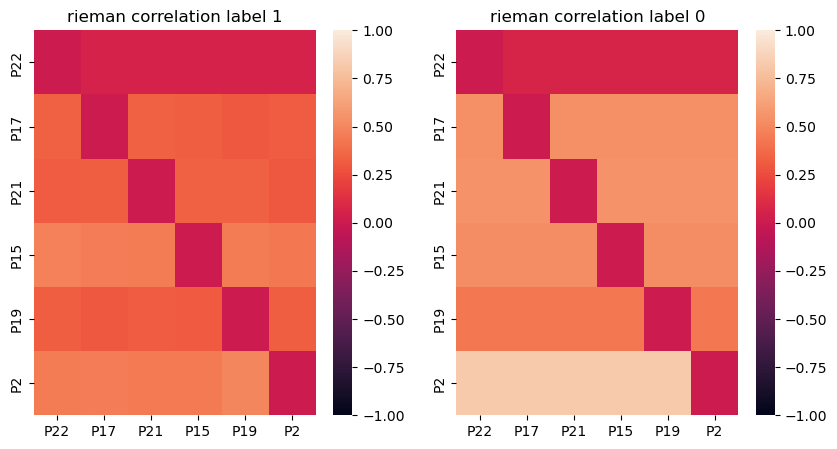

In [30]:
plt.figure(figsize=(10,5))
plt.subplot(1,2,1)
sns.heatmap(rieman_sim_1,xticklabels=participants,yticklabels=participants, vmin=-1, vmax=1)
plt.title("rieman correlation label 1")
plt.subplot(1,2,2)
sns.heatmap(rieman_sim_0,xticklabels=participants,yticklabels=participants, vmin=-1, vmax=1)
plt.title("rieman correlation label 0")


### Euclidian distance similarity

In [31]:
euclid_sim_0 = np.zeros((len(participants),len(participants)))
euclid_sim_1 = np.zeros((len(participants),len(participants)))

for i,pt in enumerate(participants):
    for j,ps in enumerate(participants):

        if pt!=ps:
            sim = similarity[pt][ps]['Euclidian Similarity']

            # calcul to change
            euclid_sim_0[i][j] = sim[1]
            euclid_sim_1[i][j] = sim[0]

Text(0.5, 1.0, 'euclid correlation label 0')

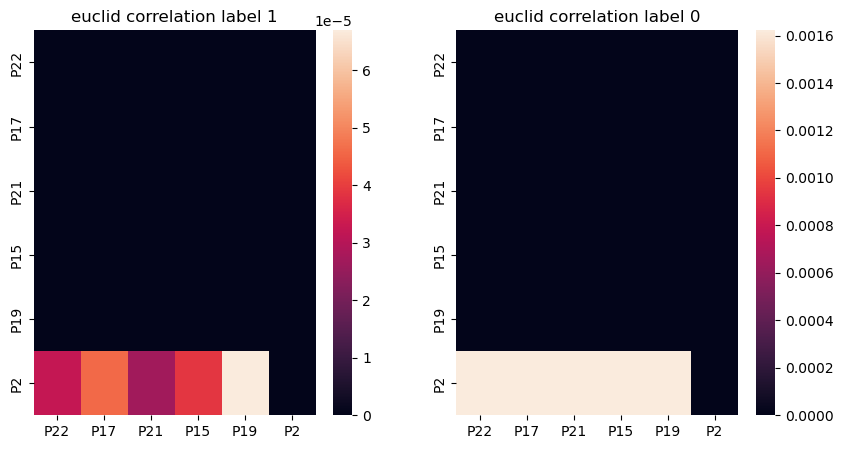

In [32]:
plt.figure(figsize=(10,5))
plt.subplot(1,2,1)
sns.heatmap(euclid_sim_1,xticklabels=participants,yticklabels=participants)
plt.title("euclid correlation label 1")
plt.subplot(1,2,2)
sns.heatmap(euclid_sim_0,xticklabels=participants,yticklabels=participants)
plt.title("euclid correlation label 0")


# Load all the all general results

In [2]:
# files_path = "D:/s.velut/Documents/Thèse/Protheus_PHD/Data/STL/ws0.35/time_sample/results/"
files_path = "D:/s.velut/Documents/Thèse/Protheus_PHD/Data/STL/ws0.35/time_sample/results/cal_2/"

## GREEN

In [3]:
participants = np.array(['P1','P2','P3','P4','P5','P6','P7','P8','P9','P10',
                'P11','P12','P13','P14','P15','P16','P17','P18','P19','P20',
                'P21','P22','P23','P24'])

name = ["tps_preproc", "tps_train", "tps_pred", "tps_acc", "score", "recall", "f1", "score_code"]

tps_preproc_GREENSiSu = np.load(files_path+"tps_preproc_greenSiSu.npy")
tps_train_GREENSiSu = np.load(files_path+"tps_train_greenSiSu.npy")
tps_pred_GREENSiSu = np.load(files_path+"tps_pred_greenSiSu.npy")
tps_acc_GREENSiSu = np.load(files_path+"tps_acc_greenSiSu.npy")
score_GREENSiSu = np.load(files_path+"score_greenSiSu.npy")
recall_GREENSiSu = np.load(files_path+"recall_greenSiSu.npy")
f1_GREENSiSu = np.load(files_path+"f1_greenSiSu.npy")
score_code_GREENSiSu = np.load(files_path+"score_code_greenSiSu.npy")

tps_preproc_GREEN = np.load(files_path+"tps_preproc_1.npy")
tps_train_GREEN = np.load(files_path+"tps_train_1.npy")
tps_pred_GREEN = np.load(files_path+"tps_pred_1.npy")
tps_acc_GREEN = np.load(files_path+"tps_acc_1.npy")
score_GREEN = np.load(files_path+"score_1.npy")
recall_GREEN = np.load(files_path+"recall_1.npy")
f1_GREEN = np.load(files_path+"f1_1.npy")
score_code_GREEN = np.load(files_path+"score_code_1.npy")

# similarity_GREEN = np.load(files_path+"similarity.npy",allow_pickle=True).item()

In [4]:
np.fill_diagonal(tps_preproc_GREEN,np.diagonal(tps_preproc_GREENSiSu))
np.fill_diagonal(tps_train_GREEN,np.diagonal(tps_train_GREENSiSu))
np.fill_diagonal(tps_pred_GREEN,np.diagonal(tps_pred_GREENSiSu))
np.fill_diagonal(tps_acc_GREEN,np.diagonal(tps_acc_GREENSiSu))
np.fill_diagonal(score_GREEN,np.diagonal(score_GREENSiSu))
np.fill_diagonal(recall_GREEN,np.diagonal(recall_GREENSiSu))
np.fill_diagonal(f1_GREEN,np.diagonal(f1_GREENSiSu))
np.fill_diagonal(score_code_GREEN,np.diagonal(score_code_GREENSiSu))

### Score accuracy

Text(0.5, 1.0, 'ordered by giving')

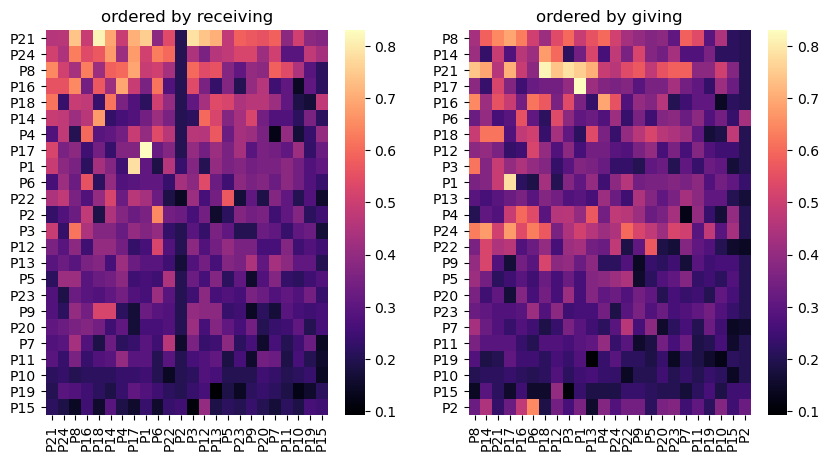

In [5]:
index_GREEN = np.argsort(-score_code_GREEN.sum(axis=1))

plt.figure(figsize=(10,5))
plt.subplot(1,2,1)
sns.heatmap(score_code_GREEN[index_GREEN][:,index_GREEN], cmap='magma', xticklabels=participants[index_GREEN],yticklabels=participants[index_GREEN])
plt.title("ordered by receiving")
index_GREEN = np.argsort(-score_code_GREEN.sum(axis=0))
plt.subplot(1,2,2)
sns.heatmap(score_code_GREEN[index_GREEN][:,index_GREEN], cmap='magma', xticklabels=participants[index_GREEN],yticklabels=participants[index_GREEN])
plt.title("ordered by giving")


<Axes: >

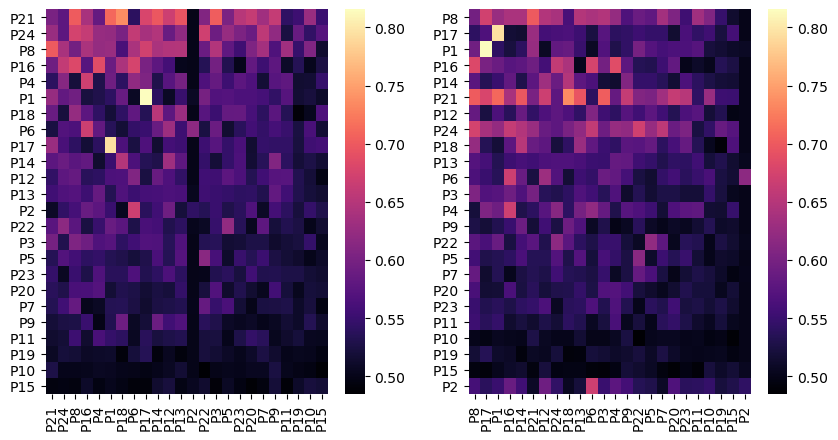

In [6]:
index_GREEN = np.argsort(-score_GREEN.sum(axis=1))

plt.figure(figsize=(10,5))
plt.subplot(1,2,1)
sns.heatmap(score_GREEN[index_GREEN][:,index_GREEN], cmap='magma', xticklabels=participants[index_GREEN],yticklabels=participants[index_GREEN])
index_GREEN = np.argsort(-score_GREEN.sum(axis=0))
plt.subplot(1,2,2)
sns.heatmap(score_GREEN[index_GREEN][:,index_GREEN], cmap='magma', xticklabels=participants[index_GREEN],yticklabels=participants[index_GREEN])


## PretrainedGREEN

In [7]:
# files_path = "D:/s.velut/Documents/Thèse/Protheus_PHD/Data/STL/ws0.35/time_sample/results/"
# files_path = "D:/s.velut/Documents/Thèse/Protheus_PHD/Data/STL/ws0.35/time_sample/results/"
participants = np.array(['P1','P2','P3','P4','P5','P6','P7','P8','P9','P10',
                'P11','P12','P13','P14','P15','P16','P17','P18','P19','P20',
                'P21','P22','P23','P24'])

name = ["tps_preproc", "tps_train", "tps_pred", "tps_acc", "score", "recall", "f1", "score_code"]

tps_preproc_PTGREENSiSu = np.load(files_path+"tps_preproc_PTGREENSiSu.npy")
tps_train_PTGREENSiSu = np.load(files_path+"tps_train_PTGREENSiSu.npy")
tps_pred_PTGREENSiSu = np.load(files_path+"tps_pred_PTGREENSiSu.npy")
tps_acc_PTGREENSiSu = np.load(files_path+"tps_acc_PTGREENSiSu.npy")
score_PTGREENSiSu = np.load(files_path+"score_PTGREENSiSu.npy")
recall_PTGREENSiSu = np.load(files_path+"recall_PTGREENSiSu.npy")
f1_PTGREENSiSu = np.load(files_path+"f1_PTGREENSiSu.npy")
score_code_PTGREENSiSu = np.load(files_path+"score_code_PTGREENSiSu.npy")

tps_preproc_PTGREEN = np.load(files_path+"tps_preproc_9.npy")
tps_train_PTGREEN = np.load(files_path+"tps_train_9.npy")
tps_pred_PTGREEN = np.load(files_path+"tps_pred_9.npy")
tps_acc_PTGREEN = np.load(files_path+"tps_acc_9.npy")
score_PTGREEN = np.load(files_path+"score_9.npy")
recall_PTGREEN = np.load(files_path+"recall_9.npy")
f1_PTGREEN = np.load(files_path+"f1_9.npy")
score_code_PTGREEN = np.load(files_path+"score_code_9.npy")

# similarity_PTGREEN = np.load(files_path+"similarity.npy",allow_pickle=True).item()

In [8]:
np.fill_diagonal(tps_preproc_PTGREEN,np.diagonal(tps_preproc_PTGREENSiSu))
np.fill_diagonal(tps_train_PTGREEN,np.diagonal(tps_train_PTGREENSiSu))
np.fill_diagonal(tps_pred_PTGREEN,np.diagonal(tps_pred_PTGREENSiSu))
np.fill_diagonal(tps_acc_PTGREEN,np.diagonal(tps_acc_PTGREENSiSu))
np.fill_diagonal(score_PTGREEN,np.diagonal(score_PTGREENSiSu))
np.fill_diagonal(recall_PTGREEN,np.diagonal(recall_PTGREENSiSu))
np.fill_diagonal(f1_PTGREEN,np.diagonal(f1_PTGREENSiSu))
np.fill_diagonal(score_code_PTGREEN,np.diagonal(score_code_PTGREENSiSu))

### Score accuracy

Text(0.5, 1.0, 'ordered by giving')

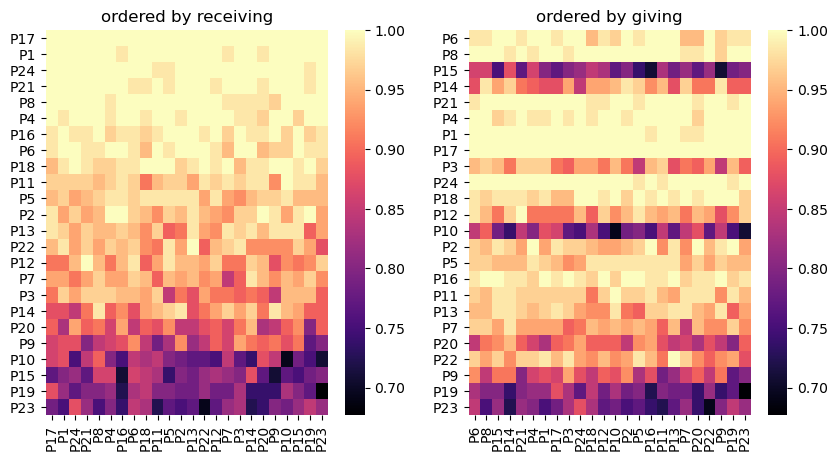

In [9]:
index_PTGREEN = np.argsort(-score_code_PTGREEN.sum(axis=1))

plt.figure(figsize=(10,5))
plt.subplot(1,2,1)
sns.heatmap(score_code_PTGREEN[index_PTGREEN][:,index_PTGREEN], cmap='magma', xticklabels=participants[index_PTGREEN],yticklabels=participants[index_PTGREEN])
plt.title("ordered by receiving")
index_PTGREEN = np.argsort(-score_code_PTGREEN.sum(axis=0))
plt.subplot(1,2,2)
sns.heatmap(score_code_PTGREEN[index_PTGREEN][:,index_PTGREEN], cmap='magma', xticklabels=participants[index_PTGREEN],yticklabels=participants[index_PTGREEN])
plt.title("ordered by giving")


<Axes: >

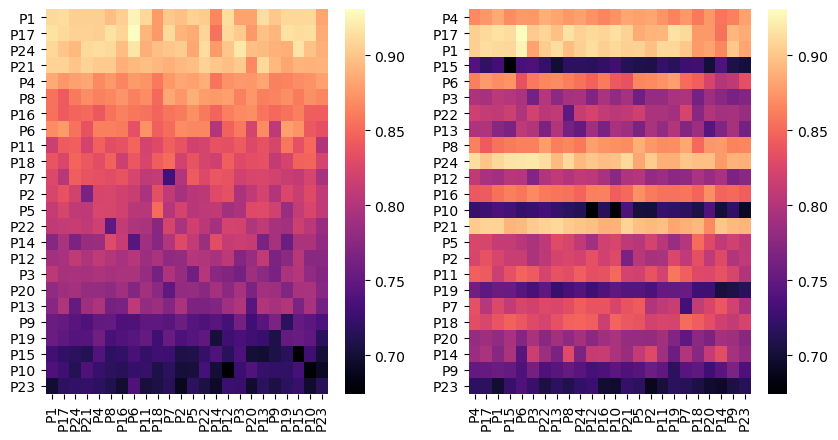

In [10]:
index_PTGREEN = np.argsort(-score_PTGREEN.sum(axis=1))

plt.figure(figsize=(10,5))
plt.subplot(1,2,1)
sns.heatmap(score_PTGREEN[index_PTGREEN][:,index_PTGREEN], cmap='magma', xticklabels=participants[index_PTGREEN],yticklabels=participants[index_PTGREEN])
index_PTGREEN = np.argsort(-score_PTGREEN.sum(axis=0))
plt.subplot(1,2,2)
sns.heatmap(score_PTGREEN[index_PTGREEN][:,index_PTGREEN], cmap='magma', xticklabels=participants[index_PTGREEN],yticklabels=participants[index_PTGREEN])


## CGREEN

In [11]:
# files_path = "D:/s.velut/Documents/Thèse/Protheus_PHD/Data/STL/ws0.35/time_sample/results/"
# files_path = "D:/s.velut/Documents/Thèse/Protheus_PHD/Data/STL/ws0.35/time_sample/full_results_preproc_data/results/"
participants = np.array(['P1','P2','P3','P4','P5','P6','P7','P8','P9','P10',
                'P11','P12','P13','P14','P15','P16','P17','P18','P19','P20',
                'P21','P22','P23','P24'])

name = ["tps_preproc", "tps_train", "tps_pred", "tps_acc", "score", "recall", "f1", "score_code"]

tps_preproc_CGREENSiSu = np.load(files_path+"tps_preproc_CGREENSiSu.npy")
tps_train_CGREENSiSu = np.load(files_path+"tps_train_CGREENSiSu.npy")
tps_pred_CGREENSiSu = np.load(files_path+"tps_pred_CGREENSiSu.npy")
tps_acc_CGREENSiSu = np.load(files_path+"tps_acc_CGREENSiSu.npy")
score_CGREENSiSu = np.load(files_path+"score_CGREENSiSu.npy")
recall_CGREENSiSu = np.load(files_path+"recall_CGREENSiSu.npy")
f1_CGREENSiSu = np.load(files_path+"f1_CGREENSiSu.npy")
score_code_CGREENSiSu = np.load(files_path+"score_code_CGREENSiSu.npy")

tps_preproc_CGREEN = np.load(files_path+"tps_preproc_8.npy")
tps_train_CGREEN = np.load(files_path+"tps_train_8.npy")
tps_pred_CGREEN = np.load(files_path+"tps_pred_8.npy")
tps_acc_CGREEN = np.load(files_path+"tps_acc_8.npy")
score_CGREEN = np.load(files_path+"score_8.npy")
recall_CGREEN = np.load(files_path+"recall_8.npy")
f1_CGREEN = np.load(files_path+"f1_8.npy")
score_code_CGREEN = np.load(files_path+"score_code_8.npy")

# similarity_CGREEN = np.load(files_path+"similarity.npy",allow_pickle=True).item()

In [12]:
np.fill_diagonal(tps_preproc_GREEN,np.diagonal(tps_preproc_GREENSiSu))
np.fill_diagonal(tps_train_GREEN,np.diagonal(tps_train_GREENSiSu))
np.fill_diagonal(tps_pred_GREEN,np.diagonal(tps_pred_GREENSiSu))
np.fill_diagonal(tps_acc_GREEN,np.diagonal(tps_acc_GREENSiSu))
np.fill_diagonal(score_GREEN,np.diagonal(score_GREENSiSu))
np.fill_diagonal(recall_GREEN,np.diagonal(recall_GREENSiSu))
np.fill_diagonal(f1_GREEN,np.diagonal(f1_GREENSiSu))
np.fill_diagonal(score_code_GREEN,np.diagonal(score_code_GREENSiSu))

### Score accuracy

Text(0.5, 1.0, 'ordered by giving')

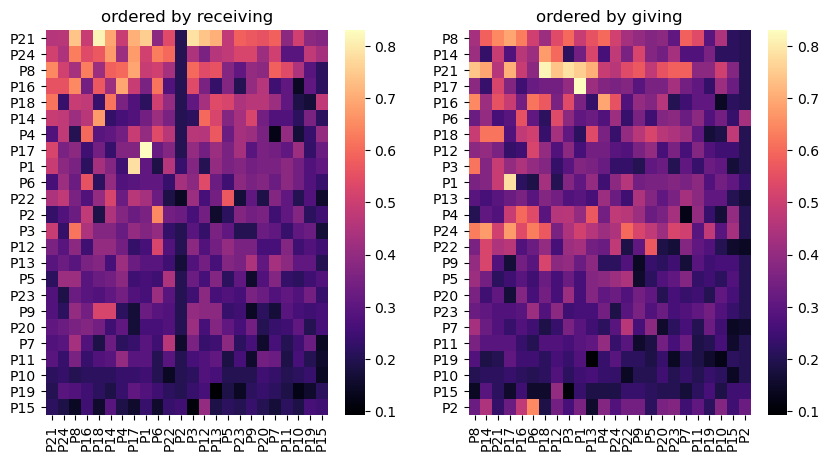

In [13]:
index_GREEN = np.argsort(-score_code_GREEN.sum(axis=1))

plt.figure(figsize=(10,5))
plt.subplot(1,2,1)
sns.heatmap(score_code_GREEN[index_GREEN][:,index_GREEN], cmap='magma', xticklabels=participants[index_GREEN],yticklabels=participants[index_GREEN])
plt.title("ordered by receiving")
index_GREEN = np.argsort(-score_code_GREEN.sum(axis=0))
plt.subplot(1,2,2)
sns.heatmap(score_code_GREEN[index_GREEN][:,index_GREEN], cmap='magma', xticklabels=participants[index_GREEN],yticklabels=participants[index_GREEN])
plt.title("ordered by giving")


<Axes: >

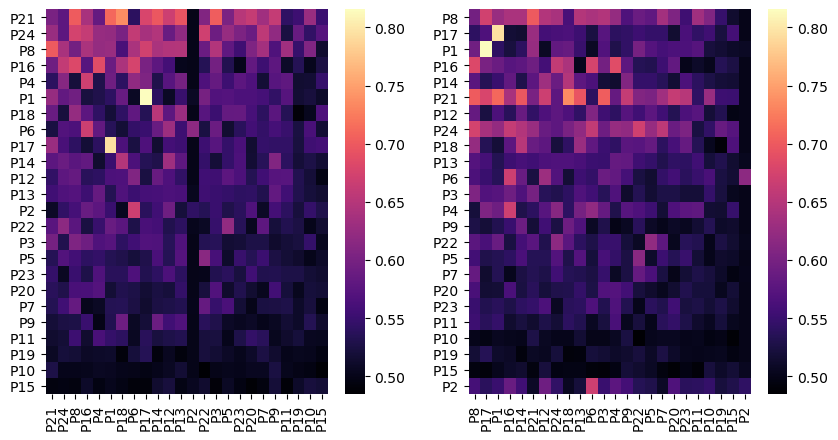

In [14]:
index_GREEN = np.argsort(-score_GREEN.sum(axis=1))

plt.figure(figsize=(10,5))
plt.subplot(1,2,1)
sns.heatmap(score_GREEN[index_GREEN][:,index_GREEN], cmap='magma', xticklabels=participants[index_GREEN],yticklabels=participants[index_GREEN])
index_GREEN = np.argsort(-score_GREEN.sum(axis=0))
plt.subplot(1,2,2)
sns.heatmap(score_GREEN[index_GREEN][:,index_GREEN], cmap='magma', xticklabels=participants[index_GREEN],yticklabels=participants[index_GREEN])


## TS_LDA

In [15]:
# files_path = "D:/s.velut/Documents/Thèse/Protheus_PHD/Data/STL/ws0.35/time_sample/results/"
participants = np.array(['P1','P2','P3','P4','P5','P6','P7','P8','P9','P10',
                'P11','P12','P13','P14','P15','P16','P17','P18','P19','P20',
                'P21','P22','P23','P24'])

name = ["tps_preproc", "tps_train", "tps_pred", "tps_acc", "score", "recall", "f1", "score_code"]

tps_preproc_TSLDA = np.load(files_path+"tps_preproc_2.npy")
tps_train_TSLDA = np.load(files_path+"tps_train_2.npy")
tps_pred_TSLDA = np.load(files_path+"tps_pred_2.npy")
tps_acc_TSLDA = np.load(files_path+"tps_acc_2.npy")
score_TSLDA = np.load(files_path+"score_2.npy")
recall_TSLDA = np.load(files_path+"recall_2.npy")
f1_TSLDA = np.load(files_path+"f1_2.npy")
score_code_TSLDA = np.load(files_path+"score_code_2.npy")

tps_preproc_TSLDASiSu = np.load(files_path+"tps_preproc_TS_LDASiSu.npy")
tps_train_TSLDASiSu = np.load(files_path+"tps_train_TS_LDASiSu.npy")
tps_pred_TSLDASiSu = np.load(files_path+"tps_pred_TS_LDASiSu.npy")
tps_acc_TSLDASiSu = np.load(files_path+"tps_acc_TS_LDASiSu.npy")
score_TSLDASiSu = np.load(files_path+"score_TS_LDASiSu.npy")
recall_TSLDASiSu = np.load(files_path+"recall_TS_LDASiSu.npy")
f1_TSLDASiSu = np.load(files_path+"f1_TS_LDASiSu.npy")
score_code_TSLDASiSu = np.load(files_path+"score_code_TS_LDASiSu.npy")

# similarity = np.load(files_path+"similarity.npy",allow_pickle=True).item()

In [16]:
np.fill_diagonal(tps_preproc_TSLDA,np.diagonal(tps_preproc_TSLDASiSu))
np.fill_diagonal(tps_train_TSLDA,np.diagonal(tps_train_TSLDASiSu))
np.fill_diagonal(tps_pred_TSLDA,np.diagonal(tps_pred_TSLDASiSu))
np.fill_diagonal(tps_acc_TSLDA,np.diagonal(tps_acc_TSLDASiSu))
np.fill_diagonal(score_TSLDA,np.diagonal(score_TSLDASiSu))
np.fill_diagonal(recall_TSLDA,np.diagonal(recall_TSLDASiSu))
np.fill_diagonal(f1_TSLDA,np.diagonal(f1_TSLDASiSu))
np.fill_diagonal(score_code_TSLDA,np.diagonal(score_code_TSLDASiSu))

### Score accuracy

<Axes: >

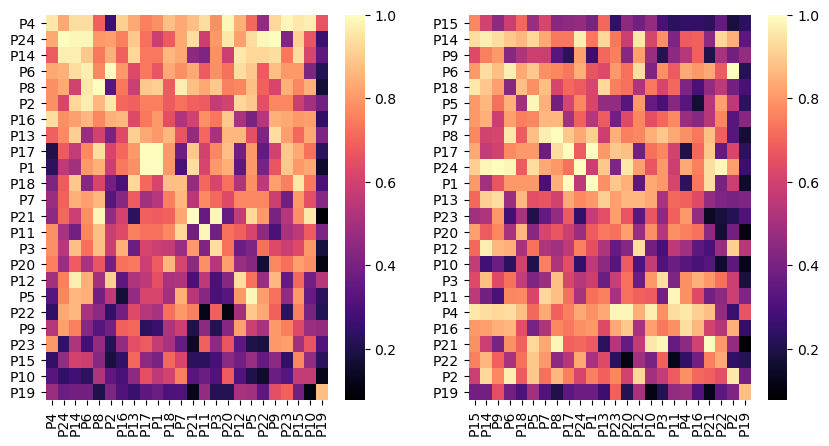

In [17]:
index_TSLDA = np.argsort(-score_code_TSLDA.sum(axis=1))

plt.figure(figsize=(10,5))
plt.subplot(1,2,1)
sns.heatmap(score_code_TSLDA[index_TSLDA][:,index_TSLDA], cmap='magma', xticklabels=participants[index_TSLDA],yticklabels=participants[index_TSLDA])
index_TSLDA = np.argsort(-score_code_TSLDA.sum(axis=0))
plt.subplot(1,2,2)
sns.heatmap(score_code_TSLDA[index_TSLDA][:,index_TSLDA], cmap='magma', xticklabels=participants[index_TSLDA],yticklabels=participants[index_TSLDA])

<Axes: >

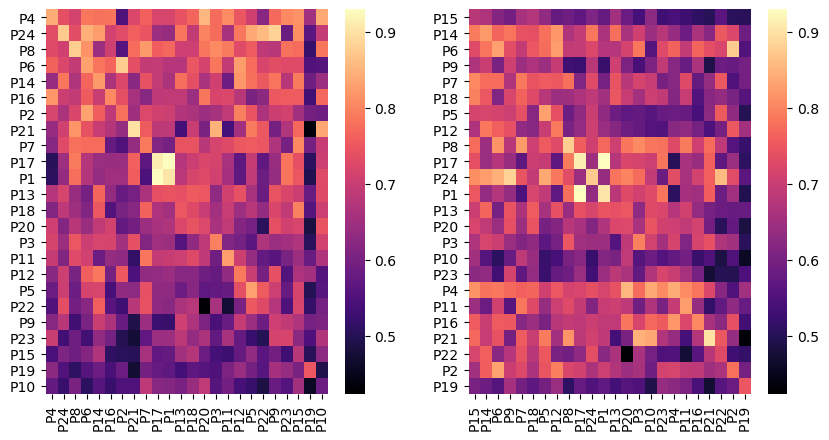

In [18]:
index_TSLDA = np.argsort(-score_TSLDA.sum(axis=1))

plt.figure(figsize=(10,5))
plt.subplot(1,2,1)
sns.heatmap(score_TSLDA[index_TSLDA][:,index_TSLDA], cmap='magma', xticklabels=participants[index_TSLDA],yticklabels=participants[index_TSLDA])
index_TSLDA = np.argsort(-score_TSLDA.sum(axis=0))
plt.subplot(1,2,2)
sns.heatmap(score_TSLDA[index_TSLDA][:,index_TSLDA], cmap='magma', xticklabels=participants[index_TSLDA],yticklabels=participants[index_TSLDA])


## MDM

In [14]:
files_path = "D:/s.velut/Documents/Thèse/Protheus_PHD/Data/STL/ws0.35/time_sample/results/"
participants = np.array(['P1','P2','P3','P4','P5','P6','P7','P8','P9','P10',
                'P11','P12','P13','P14','P15','P16','P17','P18','P19','P20',
                'P21','P22','P23','P24'])

name = ["tps_preproc", "tps_train", "tps_pred", "tps_acc", "score", "recall", "f1", "score_code"]

tps_preproc_MDM = np.load(files_path+"tps_preproc_3.npy")
tps_train_MDM = np.load(files_path+"tps_train_3.npy")
tps_pred_MDM = np.load(files_path+"tps_pred_3.npy")
tps_acc_MDM = np.load(files_path+"tps_acc_3.npy")
score_MDM = np.load(files_path+"score_3.npy")
recall_MDM = np.load(files_path+"recall_3.npy")
f1_MDM = np.load(files_path+"f1_3.npy")
score_code_MDM = np.load(files_path+"score_code_3.npy")

tps_preproc_MDMSiSu = np.load(files_path+"tps_preproc_MDMSiSu.npy")
tps_train_MDMSiSu = np.load(files_path+"tps_train_MDMSiSu.npy")
tps_pred_MDMSiSu = np.load(files_path+"tps_pred_MDMSiSu.npy")
tps_acc_MDMSiSu = np.load(files_path+"tps_acc_MDMSiSu.npy")
score_MDMSiSu = np.load(files_path+"score_MDMSiSu.npy")
recall_MDMSiSu = np.load(files_path+"recall_MDMSiSu.npy")
f1_MDMSiSu = np.load(files_path+"f1_MDMSiSu.npy")
score_code_MDMSiSu = np.load(files_path+"score_code_MDMSiSu.npy")

# similarity_MDM = np.load(files_path+"similarity.npy",allow_pickle=True).item()

In [15]:
np.fill_diagonal(tps_preproc_MDM,np.diagonal(tps_preproc_MDMSiSu))
np.fill_diagonal(tps_train_MDM,np.diagonal(tps_train_MDMSiSu))
np.fill_diagonal(tps_pred_MDM,np.diagonal(tps_pred_MDMSiSu))
np.fill_diagonal(tps_acc_MDM,np.diagonal(tps_acc_MDMSiSu))
np.fill_diagonal(score_MDM,np.diagonal(score_MDMSiSu))
np.fill_diagonal(recall_MDM,np.diagonal(recall_MDMSiSu))
np.fill_diagonal(f1_MDM,np.diagonal(f1_MDMSiSu))
np.fill_diagonal(score_code_MDM,np.diagonal(score_code_MDMSiSu))

### Score accuracy

<Axes: >

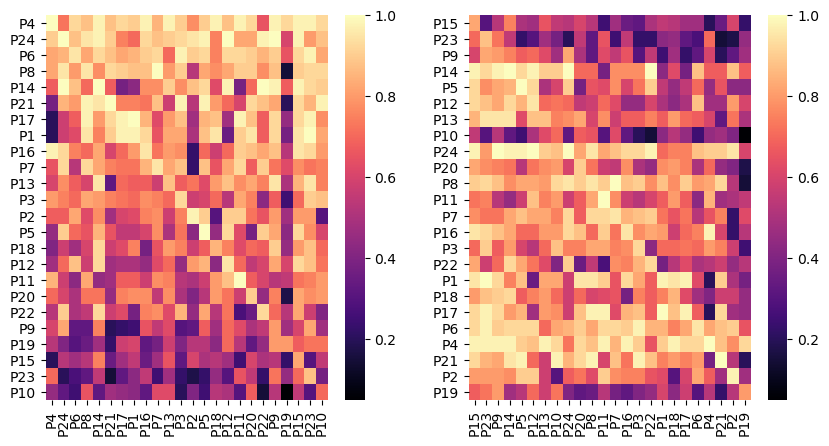

In [16]:
index_MDM = np.argsort(-score_code_MDM.sum(axis=1))

plt.figure(figsize=(10,5))
plt.subplot(1,2,1)
sns.heatmap(score_code_MDM[index_MDM][:,index_MDM], cmap='magma', xticklabels=participants[index_MDM],yticklabels=participants[index_MDM])
index_MDM = np.argsort(-score_code_MDM.sum(axis=0))
plt.subplot(1,2,2)
sns.heatmap(score_code_MDM[index_MDM][:,index_MDM], cmap='magma', xticklabels=participants[index_MDM],yticklabels=participants[index_MDM])

<Axes: >

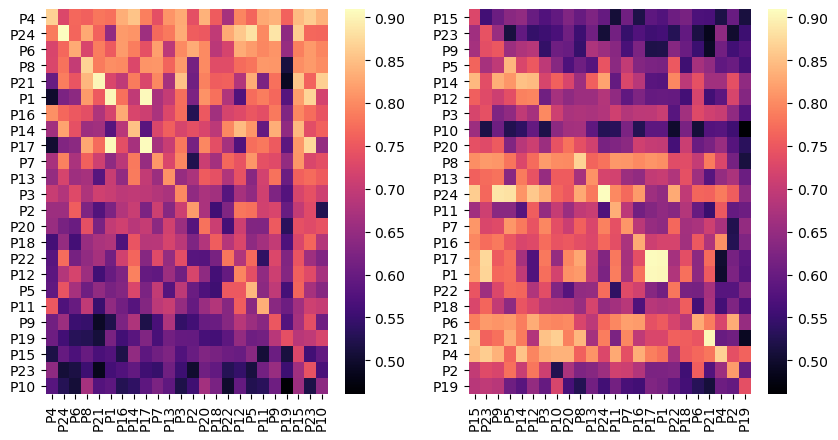

In [17]:
index_MDM = np.argsort(-score_MDM.sum(axis=1))

plt.figure(figsize=(10,5))
plt.subplot(1,2,1)
sns.heatmap(score_MDM[index_MDM][:,index_MDM], cmap='magma', xticklabels=participants[index_MDM],yticklabels=participants[index_MDM])
index_MDM = np.argsort(-score_MDM.sum(axis=0))
plt.subplot(1,2,2)
sns.heatmap(score_MDM[index_MDM][:,index_MDM], cmap='magma', xticklabels=participants[index_MDM],yticklabels=participants[index_MDM])

## SPD

In [20]:
files_path = "D:/s.velut/Documents/Thèse/Protheus_PHD/Data/STL/ws0.35/time_sample/results/"
participants = np.array(['P1','P2','P3','P4','P5','P6','P7','P8','P9','P10',
                'P11','P12','P13','P14','P15','P16','P17','P18','P19','P20',
                'P21','P22','P23','P24'])

name = ["tps_preproc", "tps_train", "tps_pred", "tps_acc", "score", "recall", "f1", "score_code"]

tps_preproc_SPD = np.load(files_path+"tps_preproc_4.npy")
tps_train_SPD = np.load(files_path+"tps_train_4.npy")
tps_pred_SPD = np.load(files_path+"tps_pred_4.npy")
tps_acc_SPD = np.load(files_path+"tps_acc_4.npy")
score_SPD = np.load(files_path+"score_4.npy")
recall_SPD = np.load(files_path+"recall_4.npy")
f1_SPD = np.load(files_path+"f1_4.npy")
score_code_SPD = np.load(files_path+"score_code_4.npy")

tps_preproc_SPDSiSu = np.load(files_path+"tps_preproc_SPDSiSu.npy")
tps_train_SPDSiSu = np.load(files_path+"tps_train_SPDSiSu.npy")
tps_pred_SPDSiSu = np.load(files_path+"tps_pred_SPDSiSu.npy")
tps_acc_SPDSiSu = np.load(files_path+"tps_acc_SPDSiSu.npy")
score_SPDSiSu = np.load(files_path+"score_SPDSiSu.npy")
recall_SPDSiSu = np.load(files_path+"recall_SPDSiSu.npy")
f1_SPDSiSu = np.load(files_path+"f1_SPDSiSu.npy")
score_code_SPDSiSu = np.load(files_path+"score_code_SPDSiSu.npy")

# similarity = np.load(files_path+"similarity_4.npy",allow_pickle=True).item()

FileNotFoundError: [Errno 2] No such file or directory: 'D:/s.velut/Documents/Thèse/Protheus_PHD/Data/STL/ws0.35/time_sample/results/tps_preproc_4.npy'

In [ ]:
np.fill_diagonal(tps_preproc_SPD,np.diagonal(tps_preproc_SPDSiSu))
np.fill_diagonal(tps_train_SPD,np.diagonal(tps_train_SPDSiSu))
np.fill_diagonal(tps_pred_SPD,np.diagonal(tps_pred_SPDSiSu))
np.fill_diagonal(tps_acc_SPD,np.diagonal(tps_acc_SPDSiSu))
np.fill_diagonal(score_SPD,np.diagonal(score_SPDSiSu))
np.fill_diagonal(recall_SPD,np.diagonal(recall_SPDSiSu))
np.fill_diagonal(f1_SPD,np.diagonal(f1_SPDSiSu))
np.fill_diagonal(score_code_SPD,np.diagonal(score_code_SPDSiSu))

NameError: name 'tps_preproc_SPD' is not defined

### Score accuracy

In [ ]:
index_SPD = np.argsort(-score_code_SPD.sum(axis=1))

plt.figure(figsize=(10,5))
plt.subplot(1,2,1)
sns.heatmap(score_code_SPD[index_SPD][:,index_SPD], cmap='magma', xticklabels=participants[index_SPD],yticklabels=participants[index_SPD])
index_SPD = np.argsort(-score_code_SPD.sum(axis=0))
plt.subplot(1,2,2)
sns.heatmap(score_code_SPD[index_SPD][:,index_SPD], cmap='magma', xticklabels=participants[index_SPD],yticklabels=participants[index_SPD])

NameError: name 'score_code_SPD' is not defined

In [94]:
index_SPD = np.argsort(-score_SPD.sum(axis=1))

plt.figure(figsize=(10,5))
plt.subplot(1,2,1)
sns.heatmap(score_SPD[index_SPD][:,index_SPD], cmap='magma', xticklabels=participants[index_SPD],yticklabels=participants[index_SPD])
index_SPD = np.argsort(-score_SPD.sum(axis=0))
plt.subplot(1,2,2)
sns.heatmap(score_SPD[index_SPD][:,index_SPD], cmap='magma', xticklabels=participants[index_SPD],yticklabels=participants[index_SPD])

NameError: name 'score_SPD' is not defined

## TS_SVM

In [21]:
files_path = "D:/s.velut/Documents/Thèse/Protheus_PHD/Data/STL/ws0.35/time_sample/results/"
participants = np.array(['P1','P2','P3','P4','P5','P6','P7','P8','P9','P10',
                'P11','P12','P13','P14','P15','P16','P17','P18','P19','P20',
                'P21','P22','P23','P24'])

name = ["tps_preproc", "tps_train", "tps_pred", "tps_acc", "score", "recall", "f1", "score_code"]

tps_preproc_TSSVM = np.load(files_path+"tps_preproc_5.npy")
tps_train_TSSVM = np.load(files_path+"tps_train_5.npy")
tps_pred_TSSVM = np.load(files_path+"tps_pred_5.npy")
tps_acc_TSSVM = np.load(files_path+"tps_acc_5.npy")
score_TSSVM = np.load(files_path+"score_5.npy")
recall_TSSVM = np.load(files_path+"recall_5.npy")
f1_TSSVM = np.load(files_path+"f1_5.npy")
score_code_TSSVM = np.load(files_path+"score_code_5.npy")

tps_preproc_TSSVMSiSu = np.load(files_path+"tps_preproc_TS_SVMSiSu.npy")
tps_train_TSSVMSiSu = np.load(files_path+"tps_train_TS_SVMSiSu.npy")
tps_pred_TSSVMSiSu = np.load(files_path+"tps_pred_TS_SVMSiSu.npy")
tps_acc_TSSVMSiSu = np.load(files_path+"tps_acc_TS_SVMSiSu.npy")
score_TSSVMSiSu = np.load(files_path+"score_TS_SVMSiSu.npy")
recall_TSSVMSiSu = np.load(files_path+"recall_TS_SVMSiSu.npy")
f1_TSSVMSiSu = np.load(files_path+"f1_TS_SVMSiSu.npy")
score_code_TSSVMSiSu = np.load(files_path+"score_code_TS_SVMSiSu.npy")

# similarity = np.load(files_path+"similarity.npy",allow_pickle=True).item()

In [22]:
np.fill_diagonal(tps_preproc_TSSVM,np.diagonal(tps_preproc_TSSVMSiSu))
np.fill_diagonal(tps_train_TSSVM,np.diagonal(tps_train_TSSVMSiSu))
np.fill_diagonal(tps_pred_TSSVM,np.diagonal(tps_pred_TSSVMSiSu))
np.fill_diagonal(tps_acc_TSSVM,np.diagonal(tps_acc_TSSVMSiSu))
np.fill_diagonal(score_TSSVM,np.diagonal(score_TSSVMSiSu))
np.fill_diagonal(recall_TSSVM,np.diagonal(recall_TSSVMSiSu))
np.fill_diagonal(f1_TSSVM,np.diagonal(f1_TSSVMSiSu))
np.fill_diagonal(score_code_TSSVM,np.diagonal(score_code_TSSVMSiSu))

### Score accuracy

<Axes: >

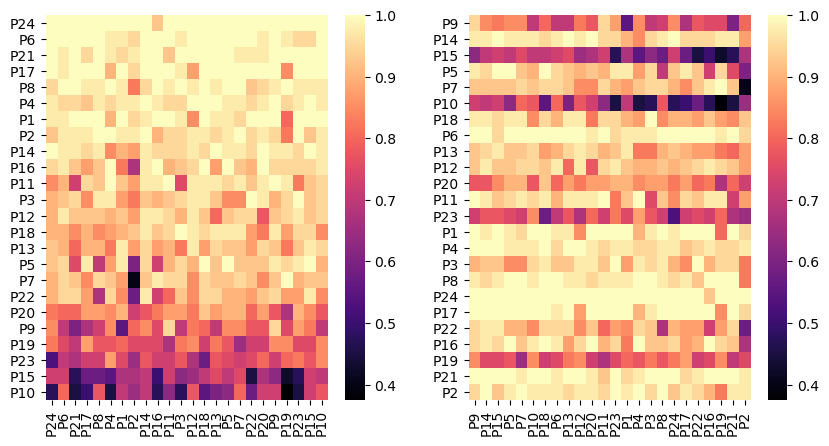

In [23]:
index_TSSVM = np.argsort(-score_code_TSSVM.sum(axis=1))

plt.figure(figsize=(10,5))
plt.subplot(1,2,1)
sns.heatmap(score_code_TSSVM[index_TSSVM][:,index_TSSVM], cmap='magma', xticklabels=participants[index_TSSVM],yticklabels=participants[index_TSSVM])
index_TSSVM = np.argsort(-score_code_TSSVM.sum(axis=0))
plt.subplot(1,2,2)
sns.heatmap(score_code_TSSVM[index_TSSVM][:,index_TSSVM], cmap='magma', xticklabels=participants[index_TSSVM],yticklabels=participants[index_TSSVM])

<Axes: >

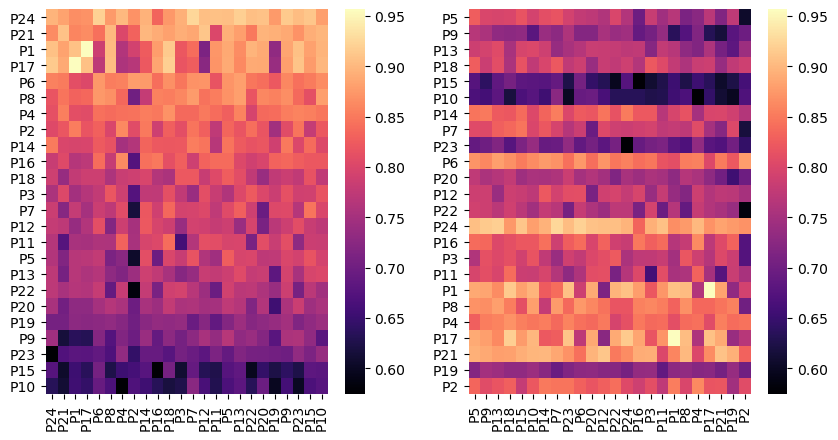

In [24]:
index_TSSVM = np.argsort(-score_TSSVM.sum(axis=1))

plt.figure(figsize=(10,5))
plt.subplot(1,2,1)
sns.heatmap(score_TSSVM[index_TSSVM][:,index_TSSVM], cmap='magma', xticklabels=participants[index_TSSVM],yticklabels=participants[index_TSSVM])
index_TSSVM = np.argsort(-score_TSSVM.sum(axis=0))
plt.subplot(1,2,2)
sns.heatmap(score_TSSVM[index_TSSVM][:,index_TSSVM], cmap='magma', xticklabels=participants[index_TSSVM],yticklabels=participants[index_TSSVM])

In [25]:
print("score",np.mean(np.diagonal(score_GREENSiSu)),np.mean(np.diagonal(score_TSLDASiSu)),np.mean(np.diagonal(score_MDMSiSu)),np.mean(np.diagonal(score_SPDSiSu)),np.mean(np.diagonal(score_TSSVMSiSu)))
print("recall",np.mean(np.diagonal(recall_GREENSiSu)),np.mean(np.diagonal(recall_TSLDASiSu)),np.mean(np.diagonal(recall_MDMSiSu)),np.mean(np.diagonal(recall_SPDSiSu)),np.mean(np.diagonal(recall_TSSVMSiSu)))
print("f1",np.mean(np.diagonal(f1_GREENSiSu)),np.mean(np.diagonal(f1_TSLDASiSu)),np.mean(np.diagonal(f1_MDMSiSu)),np.mean(np.diagonal(f1_SPDSiSu)),np.mean(np.diagonal(f1_TSSVMSiSu)))
print("tps train",np.mean(np.diagonal(tps_train_GREENSiSu)),np.mean(np.diagonal(tps_train_TSLDASiSu)),np.mean(np.diagonal(tps_train_MDMSiSu)),np.mean(np.diagonal(tps_train_SPDSiSu)),np.mean(np.diagonal(tps_train_TSSVMSiSu)))
print("tps pred",np.mean(np.diagonal(tps_pred_GREENSiSu)),np.mean(np.diagonal(tps_pred_TSLDASiSu)),np.mean(np.diagonal(tps_pred_MDMSiSu)),np.mean(np.diagonal(tps_pred_SPDSiSu)),np.mean(np.diagonal(tps_pred_TSSVMSiSu)))

NameError: name 'score_SPDSiSu' is not defined

## CNN

In [19]:
# files_path = "D:/s.velut/Documents/Thèse/Protheus_PHD/Data/STL/ws0.35/time_sample/results/"
participants = np.array(['P1','P2','P3','P4','P5','P6','P7','P8','P9','P10',
                'P11','P12','P13','P14','P15','P16','P17','P18','P19','P20',
                'P21','P22','P23','P24'])

name = ["tps_preproc", "tps_train", "tps_pred", "tps_acc", "score", "recall", "f1", "score_code"]

tps_preproc_CNN = np.load(files_path+"tps_preproc_6.npy")
tps_train_CNN = np.load(files_path+"tps_train_6.npy")
tps_pred_CNN = np.load(files_path+"tps_pred_6.npy")
tps_acc_CNN = np.load(files_path+"tps_acc_6.npy")
score_CNN = np.load(files_path+"score_6.npy")
recall_CNN = np.load(files_path+"recall_6.npy")
f1_CNN = np.load(files_path+"f1_6.npy")
score_code_CNN = np.load(files_path+"score_code_6.npy")

tps_preproc_CNNSiSu = np.load(files_path+"tps_preproc_CNNSiSu.npy")
tps_train_CNNSiSu = np.load(files_path+"tps_train_CNNSiSu.npy")
tps_pred_CNNSiSu = np.load(files_path+"tps_pred_CNNSiSu.npy")
tps_acc_CNNSiSu = np.load(files_path+"tps_acc_CNNSiSu.npy")
score_CNNSiSu = np.load(files_path+"score_CNNSiSu.npy")
recall_CNNSiSu = np.load(files_path+"recall_CNNSiSu.npy")
f1_CNNSiSu = np.load(files_path+"f1_CNNSiSu.npy")
score_code_CNNSiSu = np.load(files_path+"score_code_CNNSiSu.npy")

# similarity = np.load(files_path+"similarity_6.npy",allow_pickle=True).item()

In [20]:
np.fill_diagonal(tps_preproc_CNN,np.diagonal(tps_preproc_CNNSiSu))
np.fill_diagonal(tps_train_CNN,np.diagonal(tps_train_CNNSiSu))
np.fill_diagonal(tps_pred_CNN,np.diagonal(tps_pred_CNNSiSu))
np.fill_diagonal(tps_acc_CNN,np.diagonal(tps_acc_CNNSiSu))
np.fill_diagonal(score_CNN,np.diagonal(score_CNNSiSu))
np.fill_diagonal(recall_CNN,np.diagonal(recall_CNNSiSu))
np.fill_diagonal(f1_CNN,np.diagonal(f1_CNNSiSu))
np.fill_diagonal(score_code_CNN,np.diagonal(score_code_CNNSiSu))

### Score accuracy

<Axes: >

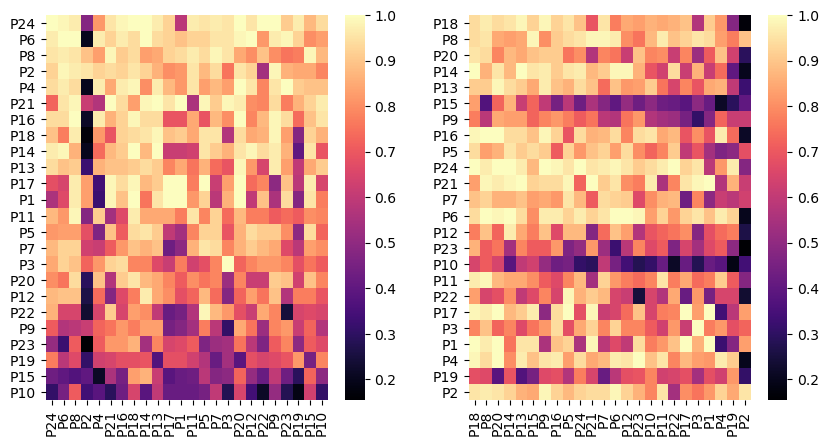

In [21]:
index_CNN = np.argsort(-score_code_CNN.sum(axis=1))

plt.figure(figsize=(10,5))
plt.subplot(1,2,1)
sns.heatmap(score_code_CNN[index_CNN][:,index_CNN], cmap='magma', xticklabels=participants[index_CNN],yticklabels=participants[index_CNN])
index_CNN = np.argsort(-score_code_CNN.sum(axis=0))
plt.subplot(1,2,2)
sns.heatmap(score_code_CNN[index_CNN][:,index_CNN], cmap='magma', xticklabels=participants[index_CNN],yticklabels=participants[index_CNN])

<Axes: >

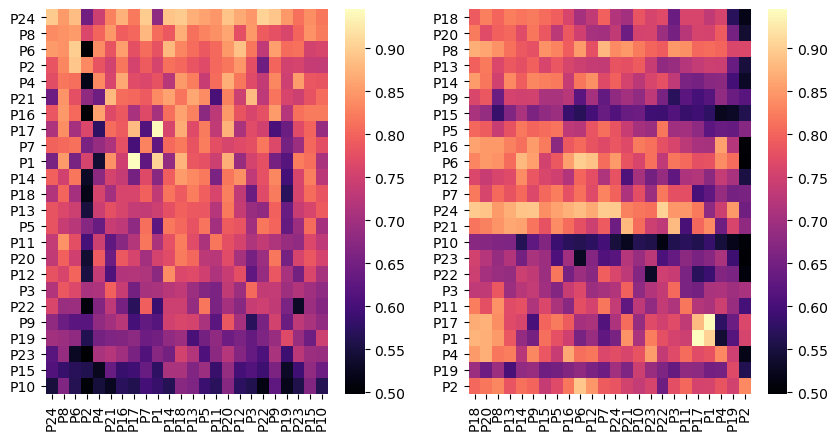

In [22]:
index_CNN = np.argsort(-score_CNN.sum(axis=1))

plt.figure(figsize=(10,5))
plt.subplot(1,2,1)
sns.heatmap(score_CNN[index_CNN][:,index_CNN], cmap='magma', xticklabels=participants[index_CNN],yticklabels=participants[index_CNN])
index_CNN = np.argsort(-score_CNN.sum(axis=0))
plt.subplot(1,2,2)
sns.heatmap(score_CNN[index_CNN][:,index_CNN], cmap='magma', xticklabels=participants[index_CNN],yticklabels=participants[index_CNN])

## Pretrained CNN

In [23]:
# files_path = "D:/s.velut/Documents/Thèse/Protheus_PHD/Data/STL/ws0.35/time_sample/results/"
participants = np.array(['P1','P2','P3','P4','P5','P6','P7','P8','P9','P10',
                'P11','P12','P13','P14','P15','P16','P17','P18','P19','P20',
                'P21','P22','P23','P24'])

name = ["tps_preproc", "tps_train", "tps_pred", "tps_acc", "score", "recall", "f1", "score_code"]

tps_preproc_PTCNN = np.load(files_path+"tps_preproc_10.npy")
tps_train_PTCNN = np.load(files_path+"tps_train_10.npy")
tps_pred_PTCNN = np.load(files_path+"tps_pred_10.npy")
tps_acc_PTCNN = np.load(files_path+"tps_acc_10.npy")
score_PTCNN = np.load(files_path+"score_10.npy")
recall_PTCNN = np.load(files_path+"recall_10.npy")
f1_PTCNN = np.load(files_path+"f1_10.npy")
score_code_PTCNN = np.load(files_path+"score_code_10.npy")

tps_preproc_PTCNNSiSu = np.load(files_path+"tps_preproc_PTCNNSiSu.npy")
tps_train_PTCNNSiSu = np.load(files_path+"tps_train_PTCNNSiSu.npy")
tps_pred_PTCNNSiSu = np.load(files_path+"tps_pred_PTCNNSiSu.npy")
tps_acc_PTCNNSiSu = np.load(files_path+"tps_acc_PTCNNSiSu.npy")
score_PTCNNSiSu = np.load(files_path+"score_PTCNNSiSu.npy")
recall_PTCNNSiSu = np.load(files_path+"recall_PTCNNSiSu.npy")
f1_PTCNNSiSu = np.load(files_path+"f1_PTCNNSiSu.npy")
score_code_PTCNNSiSu = np.load(files_path+"score_code_PTCNNSiSu.npy")

# similarity = np.load(files_path+"similarity_6.npy",allow_pickle=True).item()

In [24]:
np.fill_diagonal(tps_preproc_PTCNN,np.diagonal(tps_preproc_PTCNNSiSu))
np.fill_diagonal(tps_train_PTCNN,np.diagonal(tps_train_PTCNNSiSu))
np.fill_diagonal(tps_pred_PTCNN,np.diagonal(tps_pred_PTCNNSiSu))
np.fill_diagonal(tps_acc_PTCNN,np.diagonal(tps_acc_PTCNNSiSu))
np.fill_diagonal(score_PTCNN,np.diagonal(score_PTCNNSiSu))
np.fill_diagonal(recall_PTCNN,np.diagonal(recall_PTCNNSiSu))
np.fill_diagonal(f1_PTCNN,np.diagonal(f1_PTCNNSiSu))
np.fill_diagonal(score_code_PTCNN,np.diagonal(score_code_PTCNNSiSu))

### Score accuracy

<Axes: >

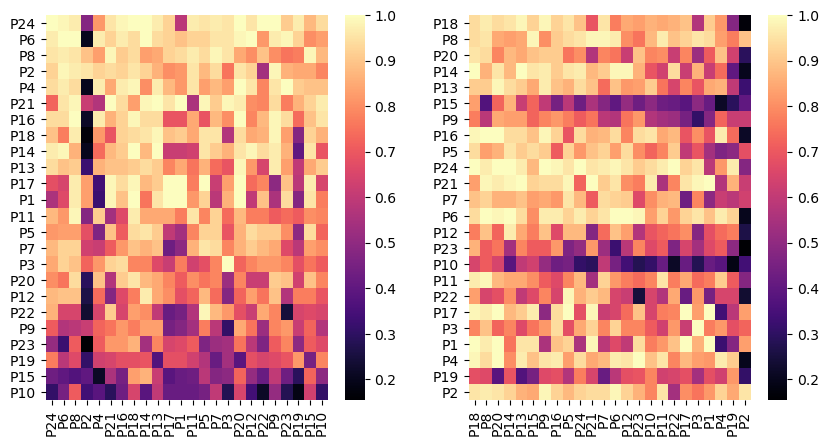

In [25]:
index_CNN = np.argsort(-score_code_CNN.sum(axis=1))

plt.figure(figsize=(10,5))
plt.subplot(1,2,1)
sns.heatmap(score_code_CNN[index_CNN][:,index_CNN], cmap='magma', xticklabels=participants[index_CNN],yticklabels=participants[index_CNN])
index_CNN = np.argsort(-score_code_CNN.sum(axis=0))
plt.subplot(1,2,2)
sns.heatmap(score_code_CNN[index_CNN][:,index_CNN], cmap='magma', xticklabels=participants[index_CNN],yticklabels=participants[index_CNN])

<Axes: >

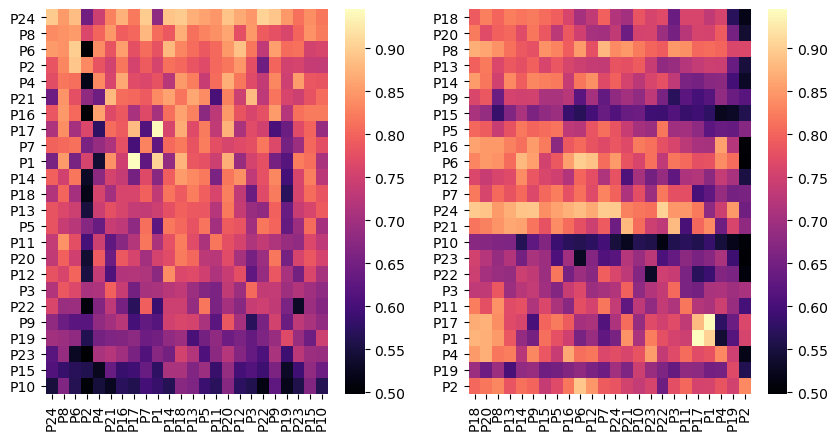

In [26]:
index_CNN = np.argsort(-score_CNN.sum(axis=1))

plt.figure(figsize=(10,5))
plt.subplot(1,2,1)
sns.heatmap(score_CNN[index_CNN][:,index_CNN], cmap='magma', xticklabels=participants[index_CNN],yticklabels=participants[index_CNN])
index_CNN = np.argsort(-score_CNN.sum(axis=0))
plt.subplot(1,2,2)
sns.heatmap(score_CNN[index_CNN][:,index_CNN], cmap='magma', xticklabels=participants[index_CNN],yticklabels=participants[index_CNN])

## Code CNN

In [27]:
# files_path = "D:/s.velut/Documents/Thèse/Protheus_PHD/Data/STL/ws0.35/time_sample/results/"
participants = np.array(['P1','P2','P3','P4','P5','P6','P7','P8','P9','P10',
                'P11','P12','P13','P14','P15','P16','P17','P18','P19','P20',
                'P21','P22','P23','P24'])

name = ["tps_preproc", "tps_train", "tps_pred", "tps_acc", "score", "recall", "f1", "score_code"]

tps_preproc_CCNN = np.load(files_path+"tps_preproc_7.npy")
tps_train_CCNN = np.load(files_path+"tps_train_7.npy")
tps_pred_CCNN = np.load(files_path+"tps_pred_7.npy")
tps_acc_CCNN = np.load(files_path+"tps_acc_7.npy")
score_CCNN = np.load(files_path+"score_7.npy")
recall_CCNN = np.load(files_path+"recall_7.npy")
f1_CCNN = np.load(files_path+"f1_7.npy")
score_code_CCNN = np.load(files_path+"score_code_7.npy")

tps_preproc_CCNNSiSu = np.load(files_path+"tps_preproc_CCNNSiSu.npy")
tps_train_CCNNSiSu = np.load(files_path+"tps_train_CCNNSiSu.npy")
tps_pred_CCNNSiSu = np.load(files_path+"tps_pred_CCNNSiSu.npy")
tps_acc_CCNNSiSu = np.load(files_path+"tps_acc_CCNNSiSu.npy")
score_CCNNSiSu = np.load(files_path+"score_CCNNSiSu.npy")
recall_CCNNSiSu = np.load(files_path+"recall_CCNNSiSu.npy")
f1_CCNNSiSu = np.load(files_path+"f1_CCNNSiSu.npy")
score_code_CCNNSiSu = np.load(files_path+"score_code_CCNNSiSu.npy")

# similarity = np.load(files_path+"similarity_6.npy",allow_pickle=True).item()

In [28]:
np.fill_diagonal(tps_preproc_CCNN,np.diagonal(tps_preproc_CCNNSiSu))
np.fill_diagonal(tps_train_CCNN,np.diagonal(tps_train_CCNNSiSu))
np.fill_diagonal(tps_pred_CCNN,np.diagonal(tps_pred_CCNNSiSu))
np.fill_diagonal(tps_acc_CCNN,np.diagonal(tps_acc_CCNNSiSu))
np.fill_diagonal(score_CCNN,np.diagonal(score_CCNNSiSu))
np.fill_diagonal(recall_CCNN,np.diagonal(recall_CCNNSiSu))
np.fill_diagonal(f1_CCNN,np.diagonal(f1_CCNNSiSu))
np.fill_diagonal(score_code_CCNN,np.diagonal(score_code_CCNNSiSu))

### Score accuracy

<Axes: >

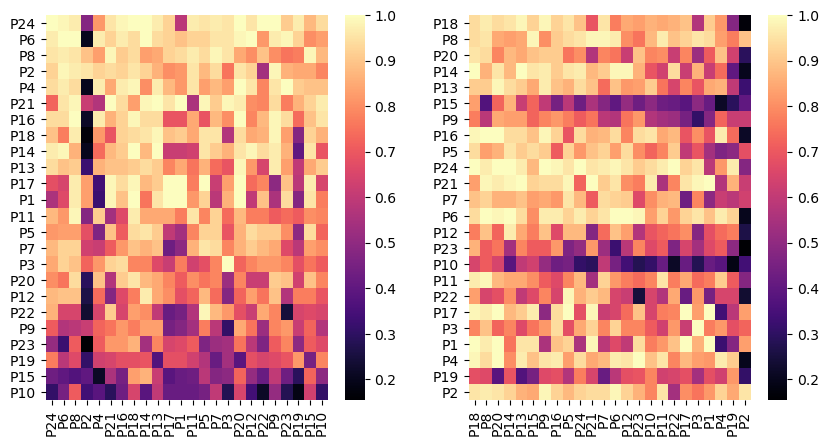

In [29]:
index_CNN = np.argsort(-score_code_CNN.sum(axis=1))

plt.figure(figsize=(10,5))
plt.subplot(1,2,1)
sns.heatmap(score_code_CNN[index_CNN][:,index_CNN], cmap='magma', xticklabels=participants[index_CNN],yticklabels=participants[index_CNN])
index_CNN = np.argsort(-score_code_CNN.sum(axis=0))
plt.subplot(1,2,2)
sns.heatmap(score_code_CNN[index_CNN][:,index_CNN], cmap='magma', xticklabels=participants[index_CNN],yticklabels=participants[index_CNN])

<Axes: >

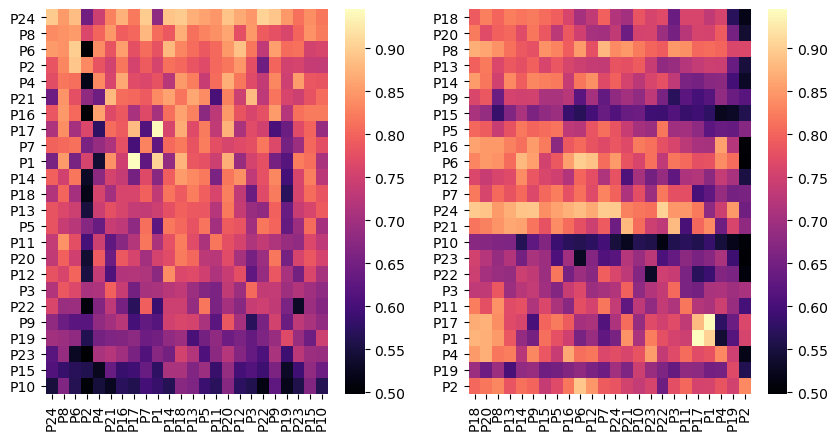

In [30]:
index_CNN = np.argsort(-score_CNN.sum(axis=1))

plt.figure(figsize=(10,5))
plt.subplot(1,2,1)
sns.heatmap(score_CNN[index_CNN][:,index_CNN], cmap='magma', xticklabels=participants[index_CNN],yticklabels=participants[index_CNN])
index_CNN = np.argsort(-score_CNN.sum(axis=0))
plt.subplot(1,2,2)
sns.heatmap(score_CNN[index_CNN][:,index_CNN], cmap='magma', xticklabels=participants[index_CNN],yticklabels=participants[index_CNN])

## COMPARE ALL

In [30]:
print("score",np.mean(np.diagonal(score_GREENSiSu)),np.mean(np.diagonal(score_PTGREENSiSu)),np.mean(np.diagonal(score_TSLDASiSu)),np.mean(np.diagonal(score_MDMSiSu)),np.mean(np.diagonal(score_CNNSiSu)),np.mean(np.diagonal(score_TSSVMSiSu)))
print("recall",np.mean(np.diagonal(recall_GREENSiSu)),np.mean(np.diagonal(recall_PTGREENSiSu)),np.mean(np.diagonal(recall_TSLDASiSu)),np.mean(np.diagonal(recall_MDMSiSu)),np.mean(np.diagonal(recall_CNNSiSu)),np.mean(np.diagonal(recall_TSSVMSiSu)))
print("f1",np.mean(np.diagonal(f1_GREENSiSu)),np.mean(np.diagonal(f1_PTGREENSiSu)),np.mean(np.diagonal(f1_TSLDASiSu)),np.mean(np.diagonal(f1_MDMSiSu)),np.mean(np.diagonal(f1_CNNSiSu)),np.mean(np.diagonal(f1_TSSVMSiSu)))
print("tps train",np.mean(np.diagonal(tps_train_GREENSiSu)),np.mean(np.diagonal(tps_train_PTGREENSiSu)),np.mean(np.diagonal(tps_train_TSLDASiSu)),np.mean(np.diagonal(tps_train_MDMSiSu)),np.mean(np.diagonal(tps_train_CNNSiSu)),np.mean(np.diagonal(tps_train_TSSVMSiSu)))
print("tps pred",np.mean(np.diagonal(tps_pred_GREENSiSu)),np.mean(np.diagonal(tps_pred_PTGREENSiSu)),np.mean(np.diagonal(tps_pred_TSLDASiSu)),np.mean(np.diagonal(tps_pred_MDMSiSu)),np.mean(np.diagonal(tps_pred_CNNSiSu)),np.mean(np.diagonal(tps_pred_TSSVMSiSu)))

NameError: name 'score_MDMSiSu' is not defined

In [31]:
print("score",np.mean(score_GREEN),np.mean(score_PTGREEN),np.mean(score_TSLDA),np.mean(score_MDM),np.mean(score_CNN),np.mean(score_TSSVM))
print("recall",np.mean(recall_GREEN),np.mean(recall_PTGREEN),np.mean(recall_TSLDA),np.mean(recall_MDM),np.mean(recall_CNN),np.mean(recall_TSSVM))
print("f1",np.mean(f1_GREEN),np.mean(f1_PTGREEN),np.mean(f1_TSLDA),np.mean(f1_MDM),np.mean(f1_CNN),np.mean(f1_TSSVM))
print("tps train",np.mean(tps_train_GREEN),np.mean(tps_train_PTGREEN),np.mean(tps_train_TSLDA),np.mean(tps_train_MDM),np.mean(tps_train_CNN),np.mean(tps_train_TSSVM))
print("tps pred",np.mean(tps_pred_GREEN),np.mean(tps_pred_PTGREEN),np.mean(tps_pred_TSLDA),np.mean(tps_pred_MDM),np.mean(tps_pred_CNN),np.mean(tps_pred_TSSVM))

NameError: name 'score_MDM' is not defined

In [32]:
def create_fig(fig,x,y,title,marg_max=None):
    ax = fig.add_gridspec(top=1, right=1).subplots()
    ax.set(aspect=1)
    ax_x = ax.inset_axes([0, 1.13, 1, 0.25], sharex=ax)
    ax_y = ax.inset_axes([1.13, 0, 0.25, 1], sharey=ax)
    index_GREEN = np.argsort(-x.sum(axis=1))
    sns.heatmap(x[index_GREEN][:,index_GREEN], cmap='magma', xticklabels=y[index_GREEN],yticklabels=y[index_GREEN],vmin=0.2,vmax=1.0,cbar=False)
    plt.colorbar(ax.collections[0], pad=0.25, shrink=0.75)
    ax_x.bar(y,x.sum(axis=0)[index_GREEN],align="edge",width=1)
    ax_y.barh(y,x.sum(axis=1)[index_GREEN],align="edge",height=1,)
    plt.title(title)
    ax_x.xaxis.set_tick_params(labelsize=8,labelrotation=90)
    ax_y.yaxis.set_tick_params(labelsize=8)

    if marg_max is not None:
        ax_x.set_ylim(top=marg_max)
        ax_y.set_xlim(right=marg_max)


### Score code

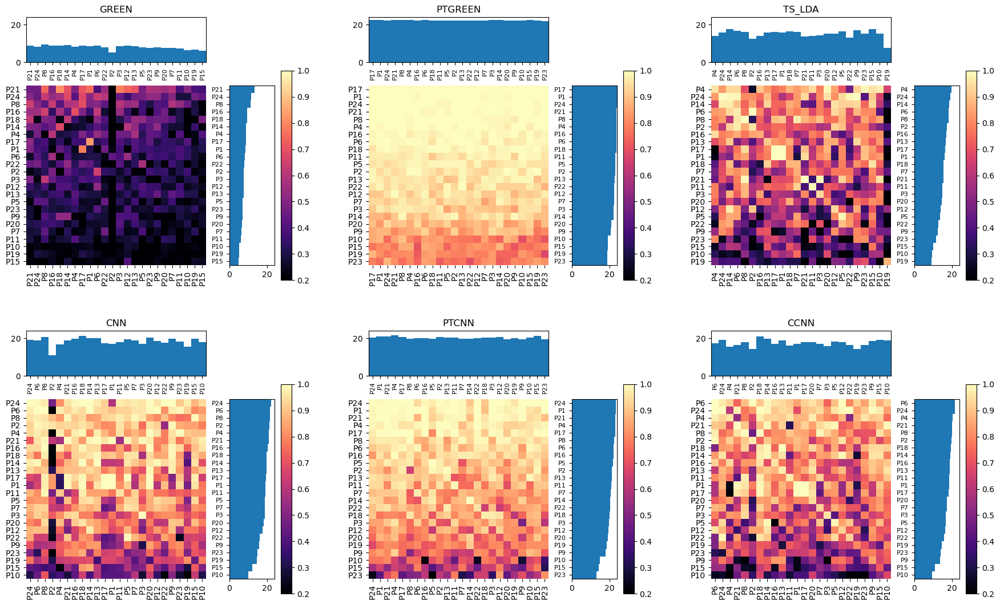

In [33]:
fig = plt.figure(figsize=(18,11))
figs = fig.subfigures(2, 3)
create_fig(figs[0,0],score_code_GREEN,participants,"GREEN",marg_max=24)
create_fig(figs[0,1],score_code_PTGREEN,participants,"PTGREEN",marg_max=24)
create_fig(figs[0,2],score_code_TSLDA,participants,"TS_LDA",marg_max=24)
create_fig(figs[1,0],score_code_CNN,participants,"CNN",marg_max=24)
create_fig(figs[1,1],score_code_PTCNN,participants,"PTCNN",marg_max=24)
create_fig(figs[1,2],score_code_CCNN,participants,"CCNN",marg_max=24)
# create_fig(figs[1,2],score_code_MDM,participants,"MDM",marg_max=24)
# create_fig(figs[1,0],score_code_SPD,participants,"SPD",marg_max=24)
# create_fig(figs[1,1],score_code_TSSVM,participants,"TS_SVM",marg_max=24)

# plt.subplot(2,3,1)
# index_GREEN = np.argsort(-score_code_GREEN.sum(axis=1))
# sns.heatmap(score_code_GREEN[index_GREEN][:,index_GREEN], cmap='magma', xticklabels=participants[index_GREEN],yticklabels=participants[index_GREEN],vmin=0.2,vmax=1.0)
# plt.title("GREEN")
# plt.subplot(2,3,2)
# index_TSLDA = np.argsort(-score_code_TSLDA.sum(axis=1))
# sns.heatmap(score_code_TSLDA[index_TSLDA][:,index_TSLDA], cmap='magma', xticklabels=participants[index_TSLDA],yticklabels=participants[index_TSLDA],vmin=0.2,vmax=1.0)
# plt.title("TS_LDA")
# plt.subplot(2,3,3)
# index_MDM = np.argsort(-score_code_MDM.sum(axis=1))
# sns.heatmap(score_code_MDM[index_MDM][:,index_MDM], cmap='magma', xticklabels=participants[index_MDM],yticklabels=participants[index_MDM],vmin=0.2,vmax=1.0)
# plt.title("MDM")
# plt.subplot(2,3,4)
# index_SPD = np.argsort(-score_code_SPD.sum(axis=1))
# sns.heatmap(score_code_SPD[index_SPD][:,index_SPD], cmap='magma', xticklabels=participants[index_SPD],yticklabels=participants[index_SPD],vmin=0.2,vmax=1.0)
# plt.title("SPD")
# plt.subplot(2,3,5)
# index_TSSVM = np.argsort(-score_code_TSSVM.sum(axis=1))
# sns.heatmap(score_code_TSSVM[index_TSSVM][:,index_TSSVM], cmap='magma', xticklabels=participants[index_TSSVM],yticklabels=participants[index_TSSVM],vmin=0.2,vmax=1.0)
# plt.title("TS_SVM")

In [34]:
np.median(score_code_GREEN),np.median(score_code_CNN)

(0.3076923076923077, 0.8153846153846155)

### Score

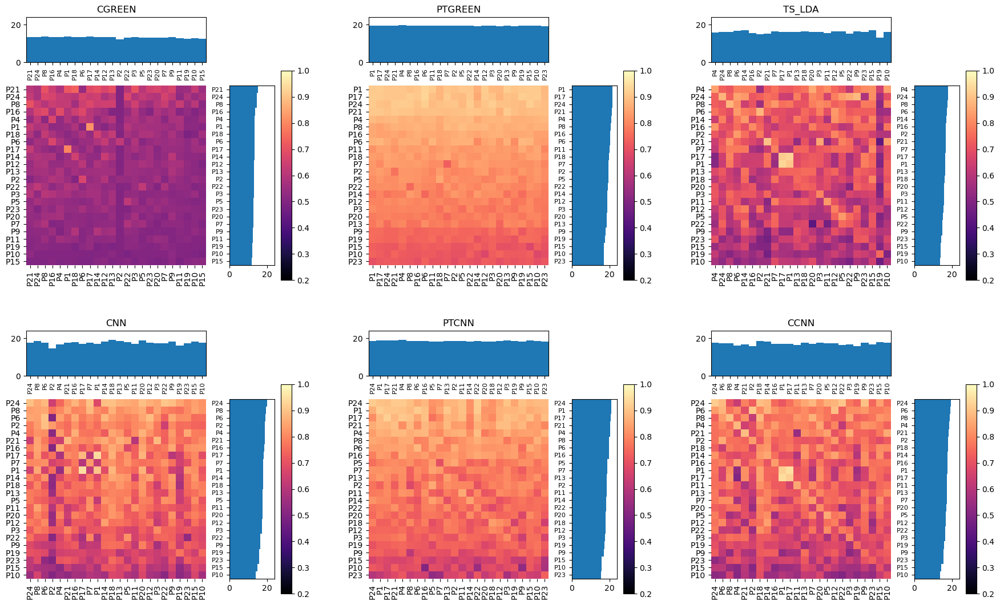

In [35]:
fig = plt.figure(0,figsize=(18,11))
figs = fig.subfigures(2, 3)
create_fig(figs[0,0],score_GREEN,participants,"CGREEN",marg_max=24)
create_fig(figs[0,1],score_PTGREEN,participants,"PTGREEN",marg_max=24)
create_fig(figs[0,2],score_TSLDA,participants,"TS_LDA",marg_max=24)
create_fig(figs[1,0],score_CNN,participants,"CNN",marg_max=24)
create_fig(figs[1,1],score_PTCNN,participants,"PTCNN",marg_max=24)
create_fig(figs[1,2],score_CCNN,participants,"CCNN",marg_max=24)
# create_fig(figs[1,2],score_MDM,participants,"MDM")
# create_fig(figs[1,0],score_SPD,participants,"SPD")
# create_fig(figs[1,1],score_TSSVM,participants,"TS_SVM")

# plt.figure(figsize=(15,9))
# plt.subplot(2,3,1)
# index_GREEN = np.argsort(-score_GREEN.sum(axis=1))
# sns.heatmap(score_GREEN[index_GREEN][:,index_GREEN], cmap='magma', xticklabels=participants[index_GREEN],yticklabels=participants[index_GREEN],vmin=0.5,vmax=1.0)
# plt.title("GREEN")
# plt.subplot(2,3,2)
# index_TSLDA = np.argsort(-score_TSLDA.sum(axis=1))
# sns.heatmap(score_TSLDA[index_TSLDA][:,index_TSLDA], cmap='magma', xticklabels=participants[index_TSLDA],yticklabels=participants[index_TSLDA],vmin=0.5,vmax=1.0)
# plt.title("TS_LDA")
# plt.subplot(2,3,3)
# index_MDM = np.argsort(-score_MDM.sum(axis=1))
# sns.heatmap(score_MDM[index_MDM][:,index_MDM], cmap='magma', xticklabels=participants[index_MDM],yticklabels=participants[index_MDM],vmin=0.5,vmax=1.0)
# plt.title("MDM")
# plt.subplot(2,3,4)
# index_SPD = np.argsort(-score_SPD.sum(axis=1))
# sns.heatmap(score_SPD[index_SPD][:,index_SPD], cmap='magma', xticklabels=participants[index_SPD],yticklabels=participants[index_SPD],vmin=0.5,vmax=1.0)
# plt.title("SPD")
# plt.subplot(2,3,5)
# index_TSSVM = np.argsort(-score_TSSVM.sum(axis=1))
# sns.heatmap(score_TSSVM[index_TSSVM][:,index_TSSVM], cmap='magma', xticklabels=participants[index_TSSVM],yticklabels=participants[index_TSSVM],vmin=0.5,vmax=1.0)
# plt.title("TS_SVM")

### Recall

NameError: name 'recall_MDM' is not defined

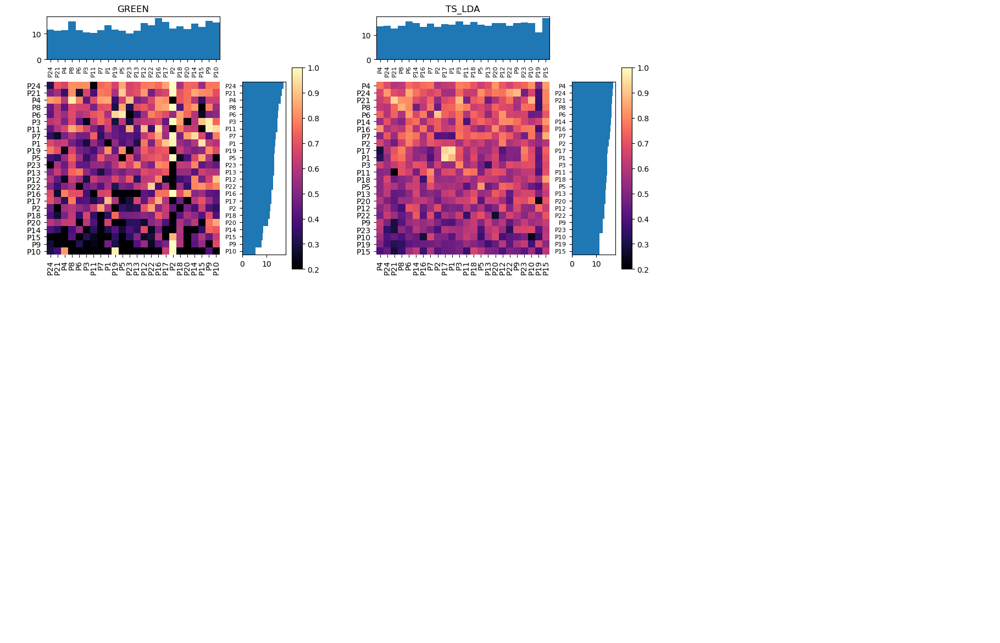

In [36]:
fig = plt.figure(figsize=(18,11))
figs = fig.subfigures(2, 3)
create_fig(figs[0,0],recall_GREEN,participants,"GREEN")
create_fig(figs[0,1],recall_TSLDA,participants,"TS_LDA")
create_fig(figs[0,2],recall_MDM,participants,"MDM")
create_fig(figs[1,0],recall_SPD,participants,"SPD")
create_fig(figs[1,1],recall_TSSVM,participants,"TS_SVM")

# plt.figure(figsize=(15,9))
# plt.subplot(2,3,1)
# index_GREEN = np.argsort(-recall_GREEN.sum(axis=1))
# sns.heatmap(recall_GREEN[index_GREEN][:,index_GREEN], cmap='magma', xticklabels=participants[index_GREEN],yticklabels=participants[index_GREEN],vmin=0.2,vmax=1.0)
# plt.title("GREEN")
# plt.subplot(2,3,2)
# index_TSLDA = np.argsort(-recall_TSLDA.sum(axis=1))
# sns.heatmap(recall_TSLDA[index_TSLDA][:,index_TSLDA], cmap='magma', xticklabels=participants[index_TSLDA],yticklabels=participants[index_TSLDA],vmin=0.2,vmax=1.0)
# plt.title("TS_LDA")
# plt.subplot(2,3,3)
# index_MDM = np.argsort(-recall_MDM.sum(axis=1))
# sns.heatmap(recall_MDM[index_MDM][:,index_MDM], cmap='magma', xticklabels=participants[index_MDM],yticklabels=participants[index_MDM],vmin=0.2,vmax=1.0)
# plt.title("MDM")
# plt.subplot(2,3,4)
# index_SPD = np.argsort(-recall_SPD.sum(axis=1))
# sns.heatmap(recall_SPD[index_SPD][:,index_SPD], cmap='magma', xticklabels=participants[index_SPD],yticklabels=participants[index_SPD],vmin=0.2,vmax=1.0)
# plt.title("SPD")
# plt.subplot(2,3,5)
# index_TSSVM = np.argsort(-recall_TSSVM.sum(axis=1))
# sns.heatmap(recall_TSSVM[index_TSSVM][:,index_TSSVM], cmap='magma', xticklabels=participants[index_TSSVM],yticklabels=participants[index_TSSVM],vmin=0.2,vmax=1.0)
# plt.title("TS_SVM")

### Training time

Text(0.5, 1.0, 'TS_SVM')

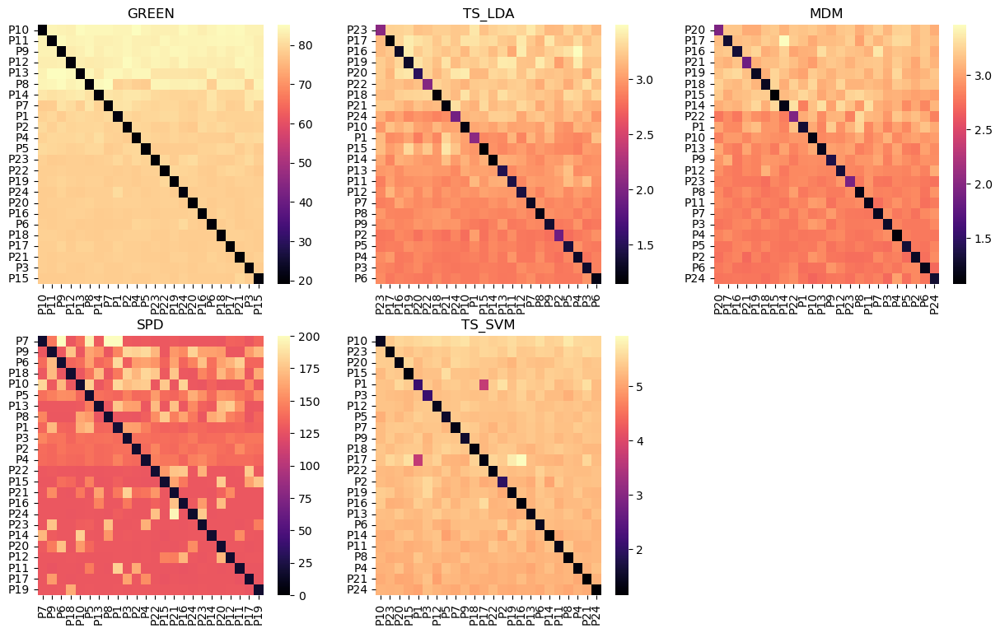

In [ ]:
plt.figure(figsize=(15,9))
plt.subplot(2,3,1)
index_GREEN = np.argsort(-tps_train_GREEN.sum(axis=1))
sns.heatmap(tps_train_GREEN[index_GREEN][:,index_GREEN], cmap='magma', xticklabels=participants[index_GREEN],yticklabels=participants[index_GREEN])
plt.title("GREEN")
plt.subplot(2,3,2)
index_TSLDA = np.argsort(-tps_train_TSLDA.sum(axis=1))
sns.heatmap(tps_train_TSLDA[index_TSLDA][:,index_TSLDA], cmap='magma', xticklabels=participants[index_TSLDA],yticklabels=participants[index_TSLDA])
plt.title("TS_LDA")
plt.subplot(2,3,3)
index_MDM = np.argsort(-tps_train_MDM.sum(axis=1))
sns.heatmap(tps_train_MDM[index_MDM][:,index_MDM], cmap='magma', xticklabels=participants[index_MDM],yticklabels=participants[index_MDM])
plt.title("MDM")
plt.subplot(2,3,4)
index_SPD = np.argsort(-tps_train_SPD.sum(axis=1))
sns.heatmap(tps_train_SPD[index_SPD][:,index_SPD], cmap='magma', xticklabels=participants[index_SPD],yticklabels=participants[index_SPD],vmin=0,vmax=200)
plt.title("SPD")
plt.subplot(2,3,5)
index_TSSVM = np.argsort(-tps_train_TSSVM.sum(axis=1))
sns.heatmap(tps_train_TSSVM[index_TSSVM][:,index_TSSVM], cmap='magma', xticklabels=participants[index_TSSVM],yticklabels=participants[index_TSSVM])
plt.title("TS_SVM")

### Prediction time

Text(0.5, 1.0, 'TS_SVM')

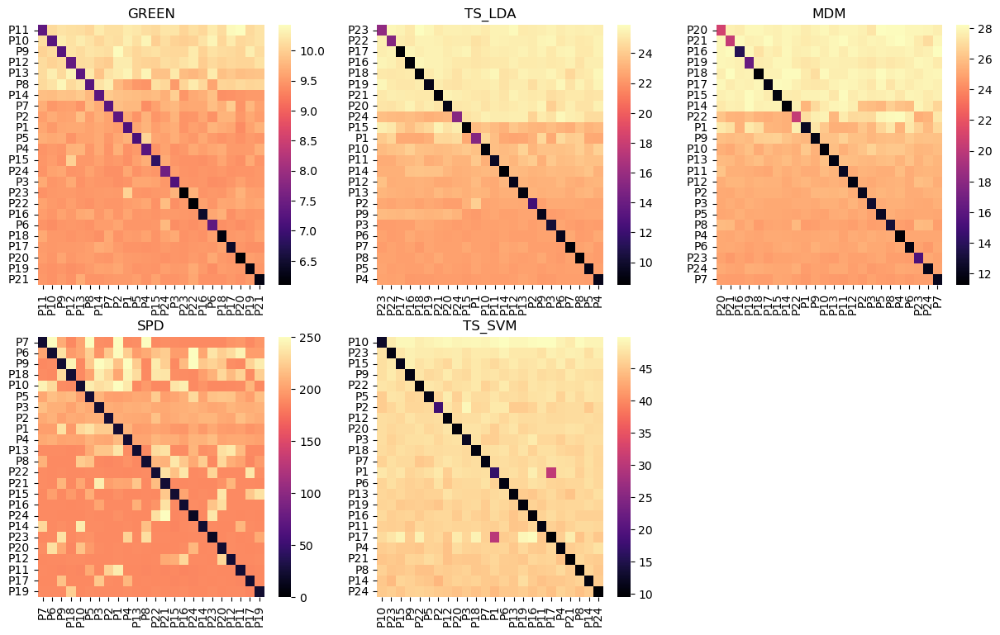

In [ ]:
plt.figure(figsize=(15,9))
plt.subplot(2,3,1)
index_GREEN = np.argsort(-tps_pred_GREEN.sum(axis=1))
sns.heatmap(tps_pred_GREEN[index_GREEN][:,index_GREEN], cmap='magma', xticklabels=participants[index_GREEN],yticklabels=participants[index_GREEN])
plt.title("GREEN")
plt.subplot(2,3,2)
index_TSLDA = np.argsort(-tps_pred_TSLDA.sum(axis=1))
sns.heatmap(tps_pred_TSLDA[index_TSLDA][:,index_TSLDA], cmap='magma', xticklabels=participants[index_TSLDA],yticklabels=participants[index_TSLDA])
plt.title("TS_LDA")
plt.subplot(2,3,3)
index_MDM = np.argsort(-tps_pred_MDM.sum(axis=1))
sns.heatmap(tps_pred_MDM[index_MDM][:,index_MDM], cmap='magma', xticklabels=participants[index_MDM],yticklabels=participants[index_MDM])
plt.title("MDM")
plt.subplot(2,3,4)
index_SPD = np.argsort(-tps_pred_SPD.sum(axis=1))
sns.heatmap(tps_pred_SPD[index_SPD][:,index_SPD], cmap='magma', xticklabels=participants[index_SPD],yticklabels=participants[index_SPD],vmin=0,vmax=250)
plt.title("SPD")
plt.subplot(2,3,5)
index_TSSVM = np.argsort(-tps_pred_TSSVM.sum(axis=1))
sns.heatmap(tps_pred_TSSVM[index_TSSVM][:,index_TSSVM], cmap='magma', xticklabels=participants[index_TSSVM],yticklabels=participants[index_TSSVM])
plt.title("TS_SVM")

### F1

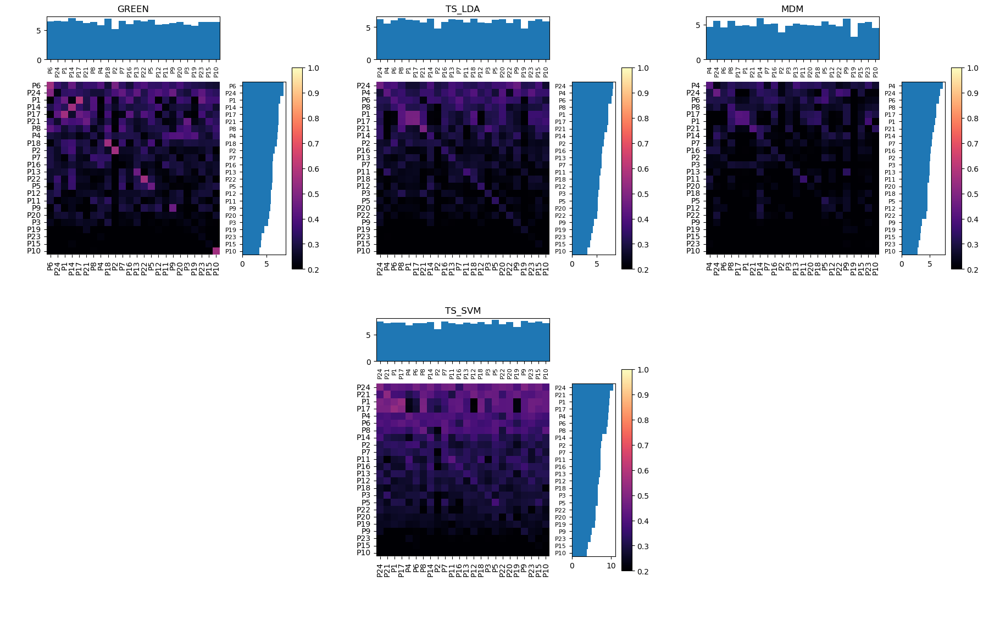

In [ ]:
fig = plt.figure(figsize=(18,11))
figs = fig.subfigures(2, 3)
create_fig(figs[0,0],f1_GREEN,participants,"GREEN")
create_fig(figs[0,1],f1_TSLDA,participants,"TS_LDA")
create_fig(figs[0,2],f1_MDM,participants,"MDM")
# create_fig(figs[1,0],f1_SPD,participants,"SPD")
create_fig(figs[1,1],f1_TSSVM,participants,"TS_SVM")

# plt.figure(figsize=(15,9))
# plt.subplot(2,3,1)
# index_GREEN = np.argsort(-f1_GREEN.sum(axis=1))
# sns.heatmap(f1_GREEN[index_GREEN][:,index_GREEN], cmap='magma', xticklabels=participants[index_GREEN],yticklabels=participants[index_GREEN])
# plt.title("GREEN")
# plt.subplot(2,3,2)
# index_TSLDA = np.argsort(-f1_TSLDA.sum(axis=1))
# sns.heatmap(f1_TSLDA[index_TSLDA][:,index_TSLDA], cmap='magma', xticklabels=participants[index_TSLDA],yticklabels=participants[index_TSLDA])
# plt.title("TS_LDA")
# plt.subplot(2,3,3)
# index_MDM = np.argsort(-f1_MDM.sum(axis=1))
# sns.heatmap(f1_MDM[index_MDM][:,index_MDM], cmap='magma', xticklabels=participants[index_MDM],yticklabels=participants[index_MDM])
# plt.title("MDM")
# plt.subplot(2,3,4)
# index_SPD = np.argsort(-f1_SPD.sum(axis=1))
# sns.heatmap(f1_SPD[index_SPD][:,index_SPD], cmap='magma', xticklabels=participants[index_SPD],yticklabels=participants[index_SPD])
# plt.title("SPD")
# plt.subplot(2,3,5)
# index_TSSVM = np.argsort(-f1_TSSVM.sum(axis=1))
# sns.heatmap(f1_TSSVM[index_TSSVM][:,index_TSSVM], cmap='magma', xticklabels=participants[index_TSSVM],yticklabels=participants[index_TSSVM])
# plt.title("TS_SVM")

## Graph

In [31]:
df_score = pd.DataFrame({"dataset":"RickerBCVEP","subject":np.repeat(np.linspace(1,24,24),23),"pipeline":"CGREEN","score":np.ndarray.flatten(score_CGREEN[~np.eye(score_CGREEN.shape[0],dtype=bool)].reshape(score_CGREEN.shape[0],-1)),"mode":"DA"})
df_score = pd.concat([df_score,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.repeat(np.linspace(1,24,24),23),"pipeline":"GREEN","score":np.ndarray.flatten(np.ndarray.flatten(score_GREEN[~np.eye(score_GREEN.shape[0],dtype=bool)].reshape(score_GREEN.shape[0],-1))),"mode":"DA"})],ignore_index=True)
df_score = pd.concat([df_score,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.repeat(np.linspace(1,24,24),23),"pipeline":"PTGREEN","score":np.ndarray.flatten(np.ndarray.flatten(score_PTGREEN[~np.eye(score_PTGREEN.shape[0],dtype=bool)].reshape(score_PTGREEN.shape[0],-1))),"mode":"DA"})],ignore_index=True)
df_score = pd.concat([df_score,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.repeat(np.linspace(1,24,24),23),"pipeline":"TSLDA","score":np.ndarray.flatten(np.ndarray.flatten(score_TSLDA[~np.eye(score_TSLDA.shape[0],dtype=bool)].reshape(score_TSLDA.shape[0],-1))),"mode":"DA"})],ignore_index=True)
df_score = pd.concat([df_score,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.repeat(np.linspace(1,24,24),23),"pipeline":"CCNN","score":np.ndarray.flatten(np.ndarray.flatten(score_CCNN[~np.eye(score_CCNN.shape[0],dtype=bool)].reshape(score_CCNN.shape[0],-1))),"mode":"DA"})],ignore_index=True)
df_score = pd.concat([df_score,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.repeat(np.linspace(1,24,24),23),"pipeline":"CNN","score":np.ndarray.flatten(np.ndarray.flatten(score_CNN[~np.eye(score_CNN.shape[0],dtype=bool)].reshape(score_CNN.shape[0],-1))),"mode":"DA"})],ignore_index=True)
df_score = pd.concat([df_score,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.repeat(np.linspace(1,24,24),23),"pipeline":"PTCNN","score":np.ndarray.flatten(np.ndarray.flatten(score_PTCNN[~np.eye(score_PTCNN.shape[0],dtype=bool)].reshape(score_PTCNN.shape[0],-1))),"mode":"DA"})],ignore_index=True)
df_score = pd.concat([df_score,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.linspace(1,24,24),"pipeline":"CGREEN","score":np.diagonal(score_CGREENSiSu),"mode":"SiSu"})],ignore_index=True)
df_score = pd.concat([df_score,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.linspace(1,24,24),"pipeline":"GREEN","score":np.diagonal(score_GREENSiSu),"mode":"SiSu"})],ignore_index=True)
df_score = pd.concat([df_score,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.linspace(1,24,24),"pipeline":"PTGREEN","score":np.diagonal(score_PTGREENSiSu),"mode":"SiSu"})],ignore_index=True)
df_score = pd.concat([df_score,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.linspace(1,24,24),"pipeline":"TSLDA","score":np.diagonal(score_TSLDASiSu),"mode":"SiSu"})],ignore_index=True)
df_score = pd.concat([df_score,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.linspace(1,24,24),"pipeline":"CCNN","score":np.diagonal(score_CCNNSiSu),"mode":"SiSu"})],ignore_index=True)
df_score = pd.concat([df_score,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.linspace(1,24,24),"pipeline":"CNN","score":np.diagonal(score_CNNSiSu),"mode":"SiSu"})],ignore_index=True)
df_score = pd.concat([df_score,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.linspace(1,24,24),"pipeline":"PTCNN","score":np.diagonal(score_PTCNNSiSu),"mode":"SiSu"})],ignore_index=True)

df_score_code = pd.DataFrame({"dataset":"RickerBCVEP","subject":np.repeat(np.linspace(1,24,24),23),"pipeline":"CGREEN","score":np.ndarray.flatten(score_code_CGREEN[~np.eye(score_code_CGREEN.shape[0],dtype=bool)].reshape(score_code_CGREEN.shape[0],-1)),"mode":"DA"})
df_score_code = pd.concat([df_score_code,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.repeat(np.linspace(1,24,24),23),"pipeline":"GREEN","score":np.ndarray.flatten(np.ndarray.flatten(score_code_GREEN[~np.eye(score_code_GREEN.shape[0],dtype=bool)].reshape(score_code_GREEN.shape[0],-1))),"mode":"DA"})],ignore_index=True)
df_score_code = pd.concat([df_score_code,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.repeat(np.linspace(1,24,24),23),"pipeline":"PTGREEN","score":np.ndarray.flatten(np.ndarray.flatten(score_code_PTGREEN[~np.eye(score_code_PTGREEN.shape[0],dtype=bool)].reshape(score_code_PTGREEN.shape[0],-1))),"mode":"DA"})],ignore_index=True)
df_score_code = pd.concat([df_score_code,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.repeat(np.linspace(1,24,24),23),"pipeline":"TSLDA","score":np.ndarray.flatten(np.ndarray.flatten(score_code_TSLDA[~np.eye(score_code_TSLDA.shape[0],dtype=bool)].reshape(score_code_TSLDA.shape[0],-1))),"mode":"DA"})],ignore_index=True)
df_score_code = pd.concat([df_score_code,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.repeat(np.linspace(1,24,24),23),"pipeline":"CCNN","score":np.ndarray.flatten(np.ndarray.flatten(score_code_CCNN[~np.eye(score_code_CCNN.shape[0],dtype=bool)].reshape(score_code_CCNN.shape[0],-1))),"mode":"DA"})],ignore_index=True)
df_score_code = pd.concat([df_score_code,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.repeat(np.linspace(1,24,24),23),"pipeline":"CNN","score":np.ndarray.flatten(np.ndarray.flatten(score_code_CNN[~np.eye(score_code_CNN.shape[0],dtype=bool)].reshape(score_code_CNN.shape[0],-1))),"mode":"DA"})],ignore_index=True)
df_score_code = pd.concat([df_score_code,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.repeat(np.linspace(1,24,24),23),"pipeline":"PTCNN","score":np.ndarray.flatten(np.ndarray.flatten(score_code_PTCNN[~np.eye(score_code_PTCNN.shape[0],dtype=bool)].reshape(score_code_PTCNN.shape[0],-1))),"mode":"DA"})],ignore_index=True)
df_score_code = pd.concat([df_score_code,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.linspace(1,24,24),"pipeline":"CGREEN","score":np.diagonal(score_code_CGREENSiSu),"mode":"SiSu"})],ignore_index=True)
df_score_code = pd.concat([df_score_code,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.linspace(1,24,24),"pipeline":"GREEN","score":np.diagonal(score_code_GREENSiSu),"mode":"SiSu"})],ignore_index=True)
df_score_code = pd.concat([df_score_code,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.linspace(1,24,24),"pipeline":"PTGREEN","score":np.diagonal(score_code_PTGREENSiSu),"mode":"SiSu"})],ignore_index=True)
df_score_code = pd.concat([df_score_code,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.linspace(1,24,24),"pipeline":"TSLDA","score":np.diagonal(score_code_TSLDASiSu),"mode":"SiSu"})],ignore_index=True)
df_score_code = pd.concat([df_score_code,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.linspace(1,24,24),"pipeline":"CCNN","score":np.diagonal(score_code_CCNNSiSu),"mode":"SiSu"})],ignore_index=True)
df_score_code = pd.concat([df_score_code,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.linspace(1,24,24),"pipeline":"CNN","score":np.diagonal(score_code_CNNSiSu),"mode":"SiSu"})],ignore_index=True)
df_score_code = pd.concat([df_score_code,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.linspace(1,24,24),"pipeline":"PTCNN","score":np.diagonal(score_code_PTCNNSiSu),"mode":"SiSu"})],ignore_index=True)

df_tps_train = pd.DataFrame({"dataset":"RickerBCVEP","subject":np.repeat(np.linspace(1,24,24),23),"pipeline":"CGREEN","score":np.ndarray.flatten(tps_train_CGREEN[~np.eye(tps_train_CGREEN.shape[0],dtype=bool)].reshape(tps_train_CGREEN.shape[0],-1)),"mode":"DA"})
df_tps_train = pd.concat([df_tps_train,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.repeat(np.linspace(1,24,24),23),"pipeline":"GREEN","score":np.ndarray.flatten(np.ndarray.flatten(tps_train_GREEN[~np.eye(tps_train_GREEN.shape[0],dtype=bool)].reshape(tps_train_GREEN.shape[0],-1))),"mode":"DA"})],ignore_index=True)
df_tps_train = pd.concat([df_tps_train,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.repeat(np.linspace(1,24,24),23),"pipeline":"PTGREEN","score":np.ndarray.flatten(np.ndarray.flatten(tps_train_PTGREEN[~np.eye(tps_train_PTGREEN.shape[0],dtype=bool)].reshape(tps_train_PTGREEN.shape[0],-1))),"mode":"DA"})],ignore_index=True)
df_tps_train = pd.concat([df_tps_train,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.repeat(np.linspace(1,24,24),23),"pipeline":"TSLDA","score":np.ndarray.flatten(np.ndarray.flatten(tps_train_TSLDA[~np.eye(tps_train_TSLDA.shape[0],dtype=bool)].reshape(tps_train_TSLDA.shape[0],-1))),"mode":"DA"})],ignore_index=True)
df_tps_train = pd.concat([df_tps_train,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.repeat(np.linspace(1,24,24),23),"pipeline":"CCNN","score":np.ndarray.flatten(np.ndarray.flatten(tps_train_CCNN[~np.eye(tps_train_CCNN.shape[0],dtype=bool)].reshape(tps_train_CCNN.shape[0],-1))),"mode":"DA"})],ignore_index=True)
df_tps_train = pd.concat([df_tps_train,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.repeat(np.linspace(1,24,24),23),"pipeline":"CNN","score":np.ndarray.flatten(np.ndarray.flatten(tps_train_CNN[~np.eye(tps_train_CNN.shape[0],dtype=bool)].reshape(tps_train_CNN.shape[0],-1))),"mode":"DA"})],ignore_index=True)
df_tps_train = pd.concat([df_tps_train,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.repeat(np.linspace(1,24,24),23),"pipeline":"PTCNN","score":np.ndarray.flatten(np.ndarray.flatten(tps_train_PTCNN[~np.eye(tps_train_PTCNN.shape[0],dtype=bool)].reshape(tps_train_PTCNN.shape[0],-1))),"mode":"DA"})],ignore_index=True)
df_tps_train = pd.concat([df_tps_train,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.linspace(1,24,24),"pipeline":"CGREEN","score":np.diagonal(tps_train_CGREENSiSu),"mode":"SiSu"})],ignore_index=True)
df_tps_train = pd.concat([df_tps_train,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.linspace(1,24,24),"pipeline":"GREEN","score":np.diagonal(tps_train_GREENSiSu),"mode":"SiSu"})],ignore_index=True)
df_tps_train = pd.concat([df_tps_train,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.linspace(1,24,24),"pipeline":"PTGREEN","score":np.diagonal(tps_train_PTGREENSiSu),"mode":"SiSu"})],ignore_index=True)
df_tps_train = pd.concat([df_tps_train,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.linspace(1,24,24),"pipeline":"TSLDA","score":np.diagonal(tps_train_TSLDASiSu),"mode":"SiSu"})],ignore_index=True)
df_tps_train = pd.concat([df_tps_train,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.linspace(1,24,24),"pipeline":"CCNN","score":np.diagonal(tps_train_CCNNSiSu),"mode":"SiSu"})],ignore_index=True)
df_tps_train = pd.concat([df_tps_train,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.linspace(1,24,24),"pipeline":"CNN","score":np.diagonal(tps_train_CNNSiSu),"mode":"SiSu"})],ignore_index=True)
df_tps_train = pd.concat([df_tps_train,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.linspace(1,24,24),"pipeline":"PTCNN","score":np.diagonal(tps_train_PTCNNSiSu),"mode":"SiSu"})],ignore_index=True)

df_tps_pred = pd.DataFrame({"dataset":"RickerBCVEP","subject":np.repeat(np.linspace(1,24,24),23),"pipeline":"CGREEN","score":np.ndarray.flatten(tps_pred_CGREEN[~np.eye(tps_pred_CGREEN.shape[0],dtype=bool)].reshape(tps_pred_CGREEN.shape[0],-1)),"mode":"DA"})
df_tps_pred = pd.concat([df_tps_pred,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.repeat(np.linspace(1,24,24),23),"pipeline":"GREEN","score":np.ndarray.flatten(np.ndarray.flatten(tps_pred_GREEN[~np.eye(tps_pred_GREEN.shape[0],dtype=bool)].reshape(tps_pred_GREEN.shape[0],-1))),"mode":"DA"})],ignore_index=True)
df_tps_pred = pd.concat([df_tps_pred,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.repeat(np.linspace(1,24,24),23),"pipeline":"PTGREEN","score":np.ndarray.flatten(np.ndarray.flatten(tps_pred_PTGREEN[~np.eye(tps_pred_PTGREEN.shape[0],dtype=bool)].reshape(tps_pred_PTGREEN.shape[0],-1))),"mode":"DA"})],ignore_index=True)
df_tps_pred = pd.concat([df_tps_pred,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.repeat(np.linspace(1,24,24),23),"pipeline":"TSLDA","score":np.ndarray.flatten(np.ndarray.flatten(tps_pred_TSLDA[~np.eye(tps_pred_TSLDA.shape[0],dtype=bool)].reshape(tps_pred_TSLDA.shape[0],-1))),"mode":"DA"})],ignore_index=True)
df_tps_pred = pd.concat([df_tps_pred,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.repeat(np.linspace(1,24,24),23),"pipeline":"CCNN","score":np.ndarray.flatten(np.ndarray.flatten(tps_pred_CCNN[~np.eye(tps_pred_CCNN.shape[0],dtype=bool)].reshape(tps_pred_CCNN.shape[0],-1))),"mode":"DA"})],ignore_index=True)
df_tps_pred = pd.concat([df_tps_pred,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.repeat(np.linspace(1,24,24),23),"pipeline":"CNN","score":np.ndarray.flatten(np.ndarray.flatten(tps_pred_CNN[~np.eye(tps_pred_CNN.shape[0],dtype=bool)].reshape(tps_pred_CNN.shape[0],-1))),"mode":"DA"})],ignore_index=True)
df_tps_pred = pd.concat([df_tps_pred,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.repeat(np.linspace(1,24,24),23),"pipeline":"PTCNN","score":np.ndarray.flatten(np.ndarray.flatten(tps_pred_PTCNN[~np.eye(tps_pred_PTCNN.shape[0],dtype=bool)].reshape(tps_pred_PTCNN.shape[0],-1))),"mode":"DA"})],ignore_index=True)
df_tps_pred = pd.concat([df_tps_pred,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.linspace(1,24,24),"pipeline":"CGREEN","score":np.diagonal(tps_pred_CGREENSiSu),"mode":"SiSu"})],ignore_index=True)
df_tps_pred = pd.concat([df_tps_pred,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.linspace(1,24,24),"pipeline":"GREEN","score":np.diagonal(tps_pred_GREENSiSu),"mode":"SiSu"})],ignore_index=True)
df_tps_pred = pd.concat([df_tps_pred,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.linspace(1,24,24),"pipeline":"PTGREEN","score":np.diagonal(tps_pred_PTGREENSiSu),"mode":"SiSu"})],ignore_index=True)
df_tps_pred = pd.concat([df_tps_pred,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.linspace(1,24,24),"pipeline":"TSLDA","score":np.diagonal(tps_pred_TSLDASiSu),"mode":"SiSu"})],ignore_index=True)
df_tps_pred = pd.concat([df_tps_pred,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.linspace(1,24,24),"pipeline":"CCNN","score":np.diagonal(tps_pred_CCNNSiSu),"mode":"SiSu"})],ignore_index=True)
df_tps_pred = pd.concat([df_tps_pred,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.linspace(1,24,24),"pipeline":"CNN","score":np.diagonal(tps_pred_CNNSiSu),"mode":"SiSu"})],ignore_index=True)
df_tps_pred = pd.concat([df_tps_pred,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.linspace(1,24,24),"pipeline":"PTCNN","score":np.diagonal(tps_pred_PTCNNSiSu),"mode":"SiSu"})],ignore_index=True)

df_recall = pd.DataFrame({"dataset":"RickerBCVEP","subject":np.repeat(np.linspace(1,24,24),23),"pipeline":"CGREEN","score":np.ndarray.flatten(recall_CGREEN[~np.eye(recall_CGREEN.shape[0],dtype=bool)].reshape(recall_CGREEN.shape[0],-1)),"mode":"DA"})
df_recall = pd.concat([df_recall,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.repeat(np.linspace(1,24,24),23),"pipeline":"GREEN","score":np.ndarray.flatten(np.ndarray.flatten(recall_GREEN[~np.eye(recall_GREEN.shape[0],dtype=bool)].reshape(recall_GREEN.shape[0],-1))),"mode":"DA"})],ignore_index=True)
df_recall = pd.concat([df_recall,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.repeat(np.linspace(1,24,24),23),"pipeline":"PTGREEN","score":np.ndarray.flatten(np.ndarray.flatten(recall_PTGREEN[~np.eye(recall_PTGREEN.shape[0],dtype=bool)].reshape(recall_PTGREEN.shape[0],-1))),"mode":"DA"})],ignore_index=True)
df_recall = pd.concat([df_recall,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.repeat(np.linspace(1,24,24),23),"pipeline":"TSLDA","score":np.ndarray.flatten(np.ndarray.flatten(recall_TSLDA[~np.eye(recall_TSLDA.shape[0],dtype=bool)].reshape(recall_TSLDA.shape[0],-1))),"mode":"DA"})],ignore_index=True)
df_recall = pd.concat([df_recall,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.repeat(np.linspace(1,24,24),23),"pipeline":"CCNN","score":np.ndarray.flatten(np.ndarray.flatten(recall_CCNN[~np.eye(recall_CCNN.shape[0],dtype=bool)].reshape(recall_CCNN.shape[0],-1))),"mode":"DA"})],ignore_index=True)
df_recall = pd.concat([df_recall,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.repeat(np.linspace(1,24,24),23),"pipeline":"CNN","score":np.ndarray.flatten(np.ndarray.flatten(recall_CNN[~np.eye(recall_CNN.shape[0],dtype=bool)].reshape(recall_CNN.shape[0],-1))),"mode":"DA"})],ignore_index=True)
df_recall = pd.concat([df_recall,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.repeat(np.linspace(1,24,24),23),"pipeline":"PTCNN","score":np.ndarray.flatten(np.ndarray.flatten(recall_PTCNN[~np.eye(recall_PTCNN.shape[0],dtype=bool)].reshape(recall_PTCNN.shape[0],-1))),"mode":"DA"})],ignore_index=True)
df_recall = pd.concat([df_recall,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.linspace(1,24,24),"pipeline":"CGREEN","score":np.diagonal(recall_CGREENSiSu),"mode":"SiSu"})],ignore_index=True)
df_recall = pd.concat([df_recall,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.linspace(1,24,24),"pipeline":"GREEN","score":np.diagonal(recall_GREENSiSu),"mode":"SiSu"})],ignore_index=True)
df_recall = pd.concat([df_recall,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.linspace(1,24,24),"pipeline":"PTGREEN","score":np.diagonal(recall_PTGREENSiSu),"mode":"SiSu"})],ignore_index=True)
df_recall = pd.concat([df_recall,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.linspace(1,24,24),"pipeline":"TSLDA","score":np.diagonal(recall_TSLDASiSu),"mode":"SiSu"})],ignore_index=True)
df_recall = pd.concat([df_recall,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.linspace(1,24,24),"pipeline":"CCNN","score":np.diagonal(recall_CCNNSiSu),"mode":"SiSu"})],ignore_index=True)
df_recall = pd.concat([df_recall,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.linspace(1,24,24),"pipeline":"CNN","score":np.diagonal(recall_CNNSiSu),"mode":"SiSu"})],ignore_index=True)
df_recall = pd.concat([df_recall,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.linspace(1,24,24),"pipeline":"PTCNN","score":np.diagonal(recall_PTCNNSiSu),"mode":"SiSu"})],ignore_index=True)

df_f1 = pd.DataFrame({"dataset":"RickerBCVEP","subject":np.repeat(np.linspace(1,24,24),23),"pipeline":"CGREEN","score":np.ndarray.flatten(f1_CGREEN[~np.eye(f1_CGREEN.shape[0],dtype=bool)].reshape(f1_CGREEN.shape[0],-1)),"mode":"DA"})
df_f1 = pd.concat([df_f1,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.repeat(np.linspace(1,24,24),23),"pipeline":"GREEN","score":np.ndarray.flatten(np.ndarray.flatten(f1_GREEN[~np.eye(f1_GREEN.shape[0],dtype=bool)].reshape(f1_GREEN.shape[0],-1))),"mode":"DA"})],ignore_index=True)
df_f1 = pd.concat([df_f1,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.repeat(np.linspace(1,24,24),23),"pipeline":"PTGREEN","score":np.ndarray.flatten(np.ndarray.flatten(f1_PTGREEN[~np.eye(f1_PTGREEN.shape[0],dtype=bool)].reshape(f1_PTGREEN.shape[0],-1))),"mode":"DA"})],ignore_index=True)
df_f1 = pd.concat([df_f1,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.repeat(np.linspace(1,24,24),23),"pipeline":"TSLDA","score":np.ndarray.flatten(np.ndarray.flatten(f1_TSLDA[~np.eye(f1_TSLDA.shape[0],dtype=bool)].reshape(f1_TSLDA.shape[0],-1))),"mode":"DA"})],ignore_index=True)
df_f1 = pd.concat([df_f1,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.repeat(np.linspace(1,24,24),23),"pipeline":"CCNN","score":np.ndarray.flatten(np.ndarray.flatten(f1_CCNN[~np.eye(f1_CCNN.shape[0],dtype=bool)].reshape(f1_CCNN.shape[0],-1))),"mode":"DA"})],ignore_index=True)
df_f1 = pd.concat([df_f1,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.repeat(np.linspace(1,24,24),23),"pipeline":"CNN","score":np.ndarray.flatten(np.ndarray.flatten(f1_CNN[~np.eye(f1_CNN.shape[0],dtype=bool)].reshape(f1_CNN.shape[0],-1))),"mode":"DA"})],ignore_index=True)
df_f1 = pd.concat([df_f1,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.repeat(np.linspace(1,24,24),23),"pipeline":"PTCNN","score":np.ndarray.flatten(np.ndarray.flatten(f1_PTCNN[~np.eye(f1_PTCNN.shape[0],dtype=bool)].reshape(f1_PTCNN.shape[0],-1))),"mode":"DA"})],ignore_index=True)
df_f1 = pd.concat([df_f1,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.linspace(1,24,24),"pipeline":"CGREEN","score":np.diagonal(f1_CGREENSiSu),"mode":"SiSu"})],ignore_index=True)
df_f1 = pd.concat([df_f1,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.linspace(1,24,24),"pipeline":"GREEN","score":np.diagonal(f1_GREENSiSu),"mode":"SiSu"})],ignore_index=True)
df_f1 = pd.concat([df_f1,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.linspace(1,24,24),"pipeline":"PTGREEN","score":np.diagonal(f1_PTGREENSiSu),"mode":"SiSu"})],ignore_index=True)
df_f1 = pd.concat([df_f1,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.linspace(1,24,24),"pipeline":"TSLDA","score":np.diagonal(f1_TSLDASiSu),"mode":"SiSu"})],ignore_index=True)
df_f1 = pd.concat([df_f1,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.linspace(1,24,24),"pipeline":"CCNN","score":np.diagonal(f1_CCNNSiSu),"mode":"SiSu"})],ignore_index=True)
df_f1 = pd.concat([df_f1,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.linspace(1,24,24),"pipeline":"CNN","score":np.diagonal(f1_CNNSiSu),"mode":"SiSu"})],ignore_index=True)
df_f1 = pd.concat([df_f1,pd.DataFrame({"dataset":"RickerBCVEP","subject":np.linspace(1,24,24),"pipeline":"PTCNN","score":np.diagonal(f1_PTCNNSiSu),"mode":"SiSu"})],ignore_index=True)


In [32]:
import PtitPrince as pt
import matplotlib.patches as mpatches

def raincloud_graph(results,title,xlim=None):

    x = "mode"
    y = "score"
    hue = "pipeline"

    boxplot_lw = 1.0
    boxplot_props = {'linewidth': boxplot_lw}

    temp = results.copy()
    # temp.insert(1,"procedure",np.repeat(["DG","DA","SS","DG","DA","SS"],12*1),True)

    n_pi = 3
    palette = dict(zip(["CGREEN","GREEN","PTGREEN","TSLDA","CCNN","CNN","PTCNN"]*579, sns.color_palette('Set2', 7)*579))
    fig, ax = plt.subplots(1, 1, figsize=(10,10))
    pt.RainCloud(
        data=results, y=y, x=x,
        hue=hue,
        bw='scott',
        width_viol=0, width_box=0.8, point_size=5,
        dodge=True, orient='h',
        linewidth=0, box_linewidth=boxplot_lw,
        box_whiskerprops=boxplot_props,
        box_medianprops=boxplot_props,
        alpha=0.7, palette=palette,
        box_showfliers=False,
        ax=ax, pointplot=True,
        point_linestyles="none",
        point_markers='D',)



    # ax.set_yticks([])

    for i in range(n_pi):
        ax.axhline(y=i + 0.5, xmin=0, xmax=1.02, color='black', linestyle=':', alpha=0.3)
    if xlim is not None:
        ax.set_xlim(left=0,right=xlim)
    # GREEN_patch = mpatches.Patch(color=sns.color_palette('Set2', 5)[0], label='Domain Generalization')
    # PTGREEN_patch = mpatches.Patch(color=sns.color_palette('Set2', 5)[1], label='Domain Adaptation')
    # SS_patch = mpatches.Patch(color=sns.color_palette('Set2', 5)[2], label='Single Subject')
    # SS_patch = mpatches.Patch(color=sns.color_palette('Set2', 5)[3], label='Single Subject')
    # SS_patch = mpatches.Patch(color=sns.color_palette('Set2', 5)[4], label='Single Subject')

    ax.set(xlabel="Accuracy score")
    ax.set_title(title)
    # ax.legend(['Domain Generalization', 'Domain Adaptation', 'Single Subject'],
    #         handles=[DG_patch,DA_patch,SS_patch],
    #             loc=(0.05, 1.01), ncols=n_pi)



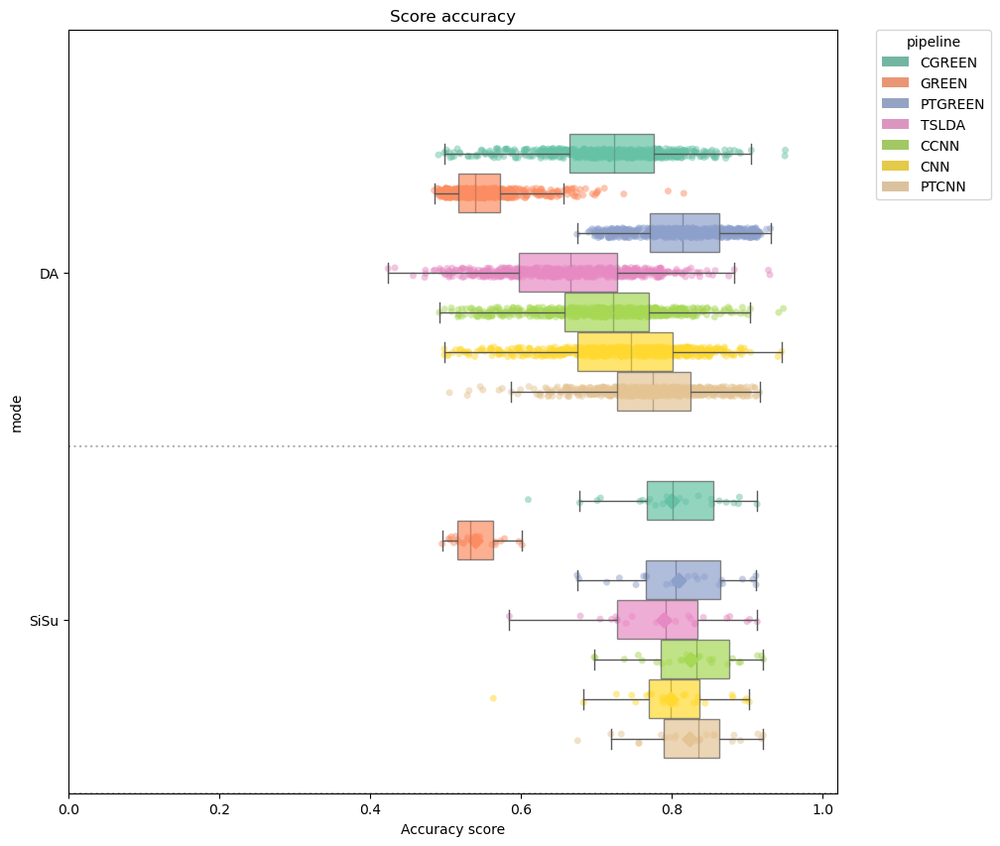

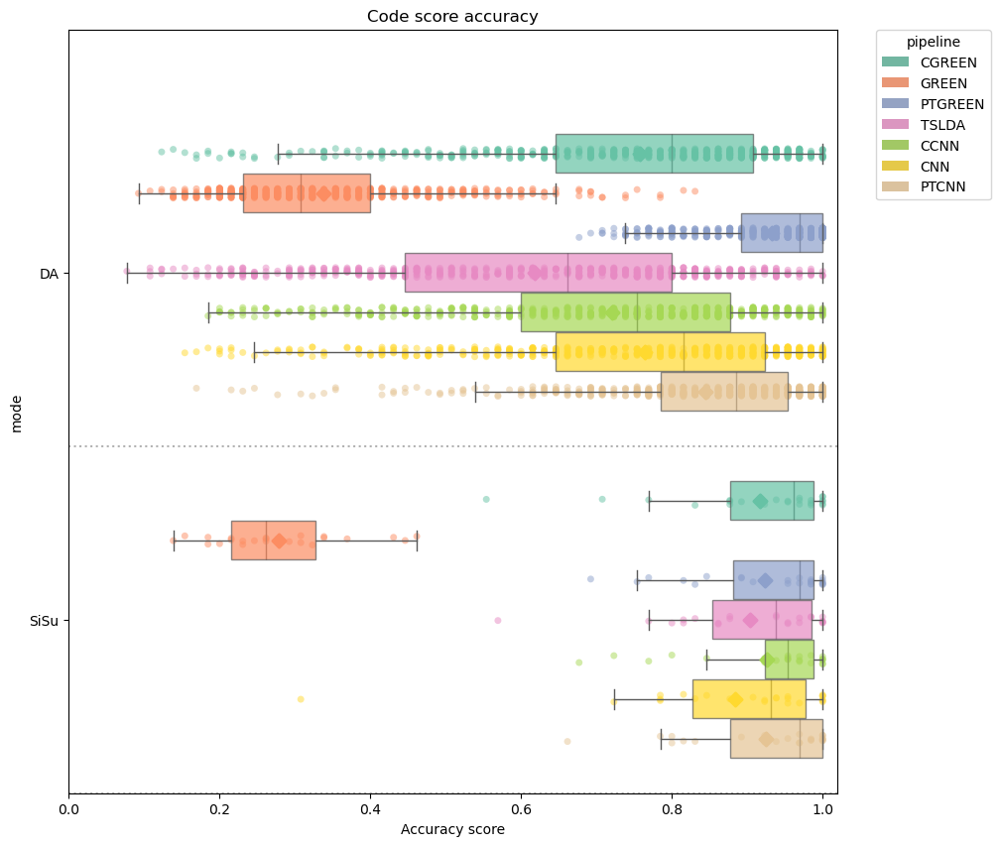

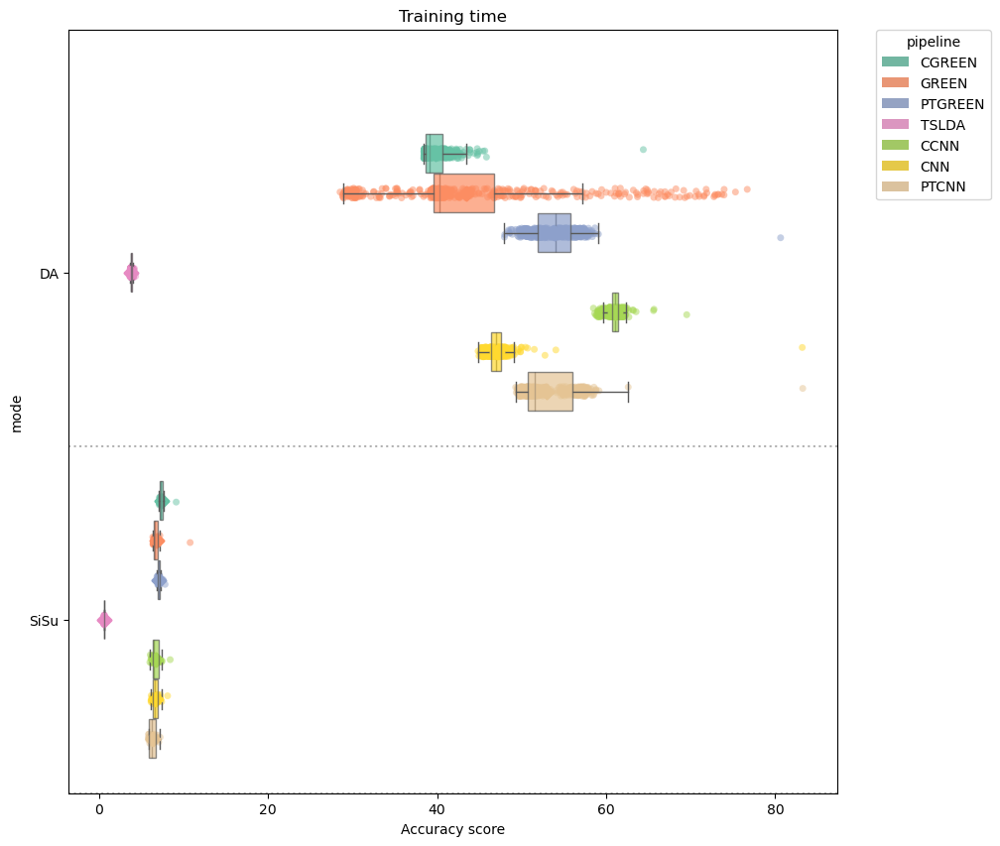

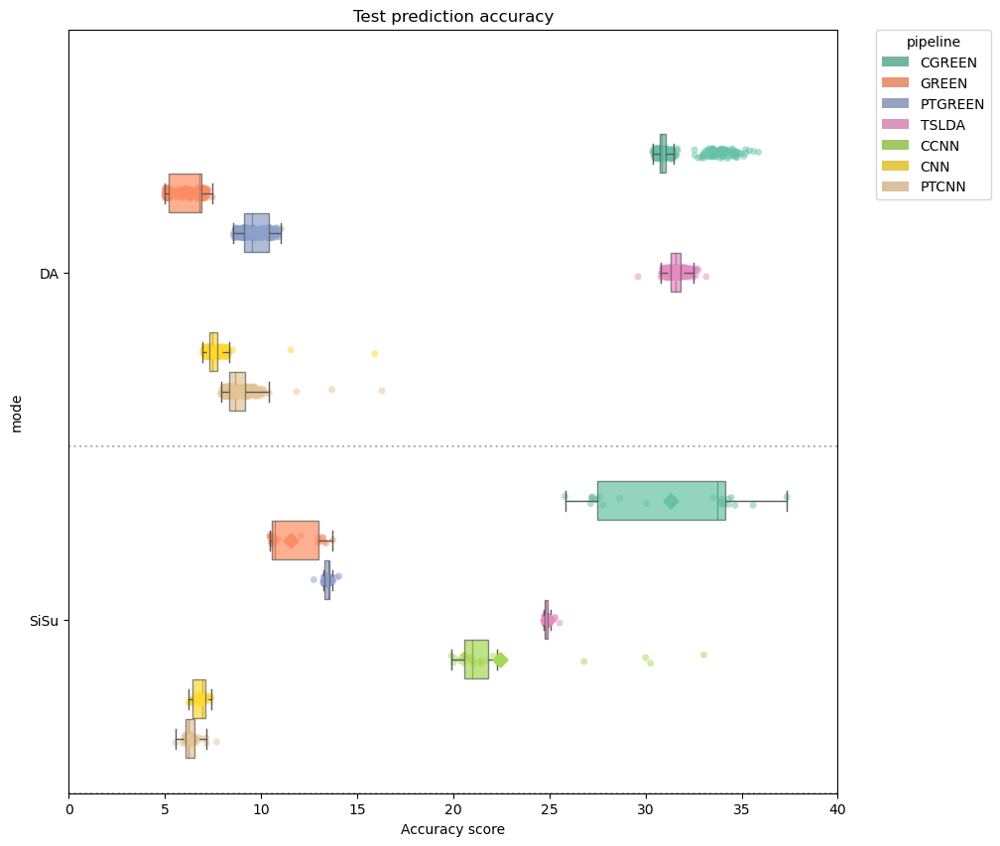

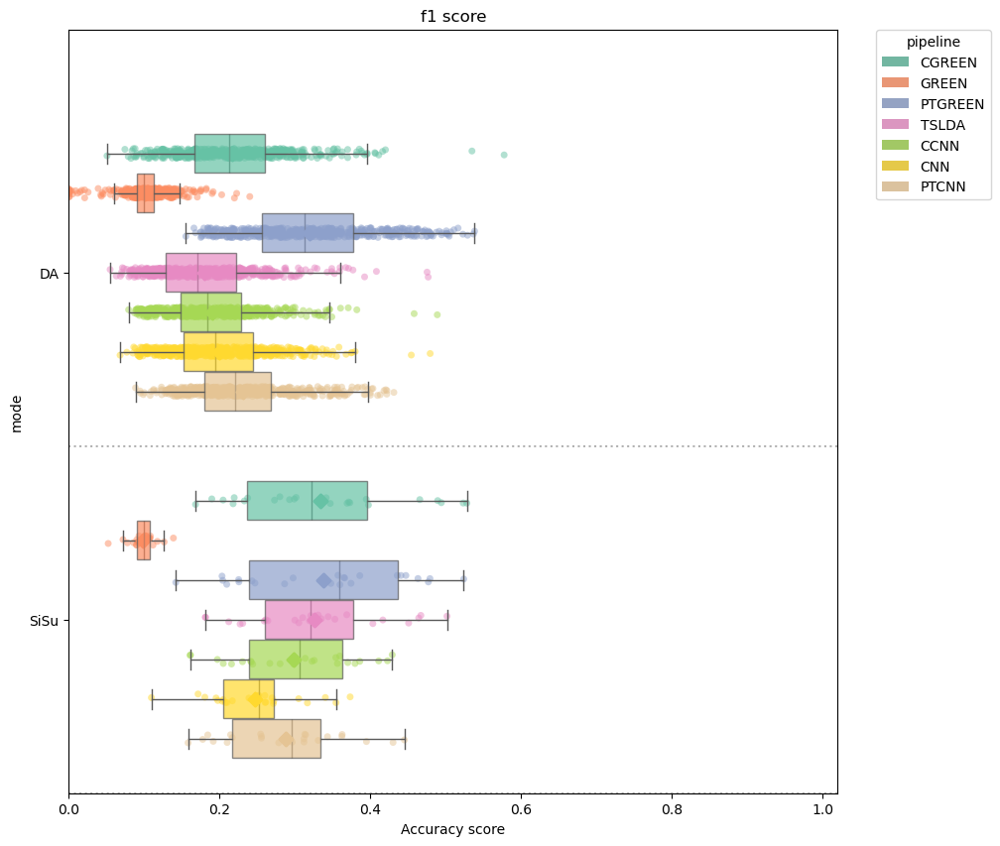

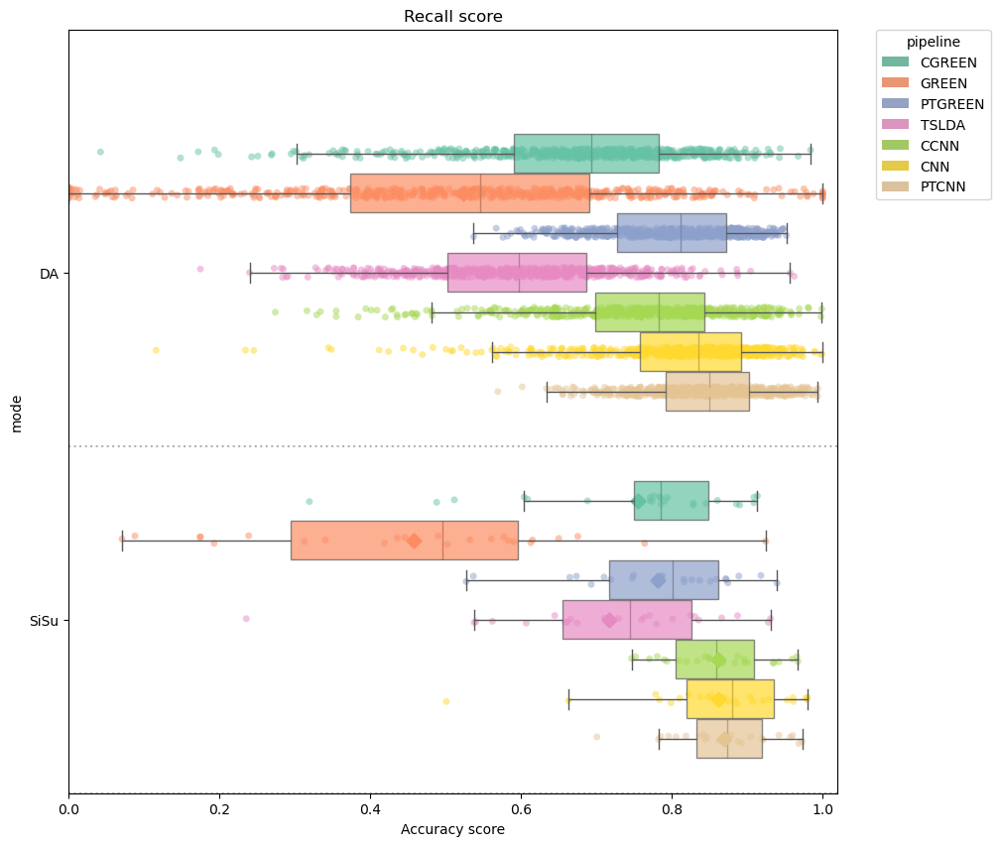

In [33]:
raincloud_graph(df_score,"Score accuracy",1.02)
raincloud_graph(df_score_code,"Code score accuracy",1.02)
raincloud_graph(df_tps_train,"Training time")
raincloud_graph(df_tps_pred,"Test prediction accuracy",40)
raincloud_graph(df_f1,"f1 score",1.02)
raincloud_graph(df_recall,"Recall score",1.02)

### STATS

In [49]:
np.mean(df_score[df_score['mode']=="SiSu"][df_score["pipeline"]=="PTCNN"]),np.mean(df_score[df_score['mode']=="DA"][df_score["pipeline"]=="PTCNN"])


C:\Users\s.velut\AppData\Local\Temp\ipykernel_26072\2599570747.py:1: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  np.mean(df_score[df_score['mode']=="SiSu"][df_score["pipeline"]=="PTCNN"]),np.mean(df_score[df_score['mode']=="DA"][df_score["pipeline"]=="PTCNN"])
c:\Users\s.velut\AppData\Local\anaconda3\Lib\site-packages\numpy\core\fromnumeric.py:3462: FutureWarning: In a future version, DataFrame.mean(axis=None) will return a scalar mean over the entire DataFrame. To retain the old behavior, use 'frame.mean(axis=0)' or just 'frame.mean()'
  return mean(axis=axis, dtype=dtype, out=out, **kwargs)
c:\Users\s.velut\AppData\Local\anaconda3\Lib\site-packages\numpy\core\fromnumeric.py:3462: FutureWarning: The default value of numeric_only in DataFrame.mean is deprecated. In a future version, it will default to False. In addition, specifying 'numeric_only=None' is deprecated. Select only valid columns or specify the value of numeric_only to silence this warning.

(subject    12.500000
 score       0.823284
 dtype: float64,
 subject    12.500000
 score       0.773588
 dtype: float64)

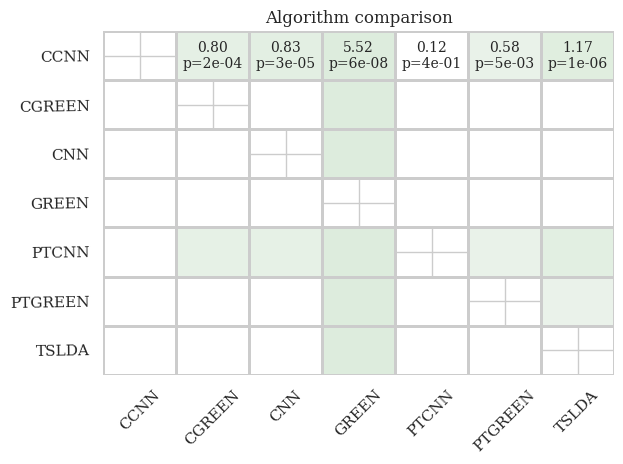

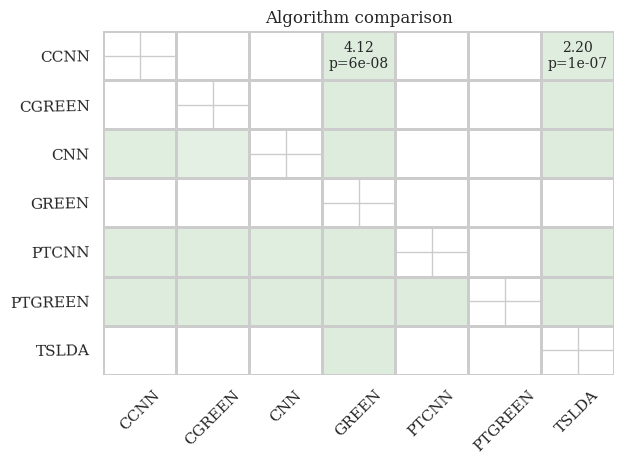

In [50]:
import moabb.analysis.plotting as moabb_plt
from moabb.analysis.meta_analysis import (  # noqa: E501
    compute_dataset_statistics,
    find_significant_differences,
)

statis = compute_dataset_statistics(df_score[df_score['mode']=="SiSu"])
P, T = find_significant_differences(statis)

moabb_plt.summary_plot(P, T)
plt.show()

statis = compute_dataset_statistics(df_score[df_score['mode']=="DA"])
P, T = find_significant_differences(statis)

moabb_plt.summary_plot(P, T)
plt.show()

## Similarity

In [80]:
similarity = np.load(files_path+"similarity.npy",allow_pickle=True).item()


### Spearman correlation

In [81]:
spearman_sim_0 = np.zeros((len(participants),len(participants)))
spearman_sim_1 = np.zeros((len(participants),len(participants)))

for i,pt in enumerate(participants):
    for j,ps in enumerate(participants):

        if pt!=ps:
            sim = similarity[pt][ps]['Spearman Correlation']

            # calcul to change
            spearman_sim_0[i][j] = np.mean(sim[1])
            spearman_sim_1[i][j] = np.mean(sim[0])

Text(0.5, 1.0, 'Spearman correlation label 0')

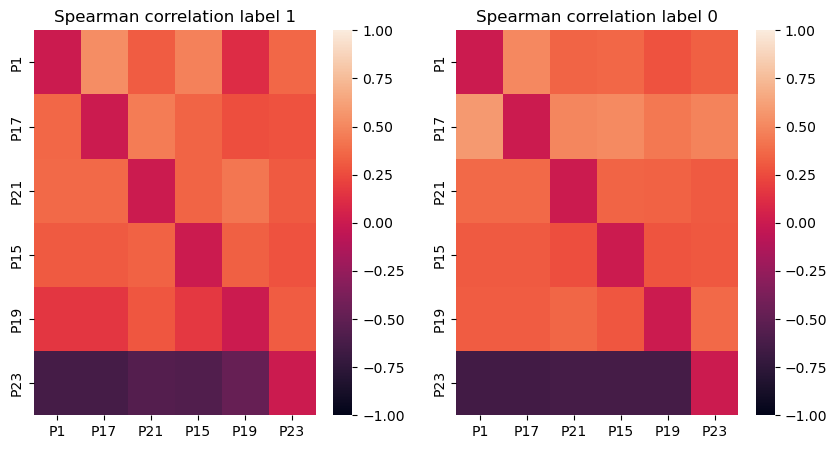

In [82]:
plt.figure(figsize=(10,5))
plt.subplot(1,2,1)
sns.heatmap(spearman_sim_1,xticklabels=participants,yticklabels=participants, vmin=-1, vmax=1)
plt.title("Spearman correlation label 1")
plt.subplot(1,2,2)
sns.heatmap(spearman_sim_0,xticklabels=participants,yticklabels=participants, vmin=-1, vmax=1)
plt.title("Spearman correlation label 0")


### Pearson correlation

In [83]:
pearson_sim_0 = np.zeros((len(participants),len(participants)))
pearson_sim_1 = np.zeros((len(participants),len(participants)))

for i,pt in enumerate(participants):
    for j,ps in enumerate(participants):

        if pt!=ps:
            sim = similarity[pt][ps]['Pearson Correlation']

            # calcul to change
            pearson_sim_0[i][j] = np.mean(sim[1][:,0])
            pearson_sim_1[i][j] = np.mean(sim[0][:,0])

Text(0.5, 1.0, 'pearson correlation label 0')

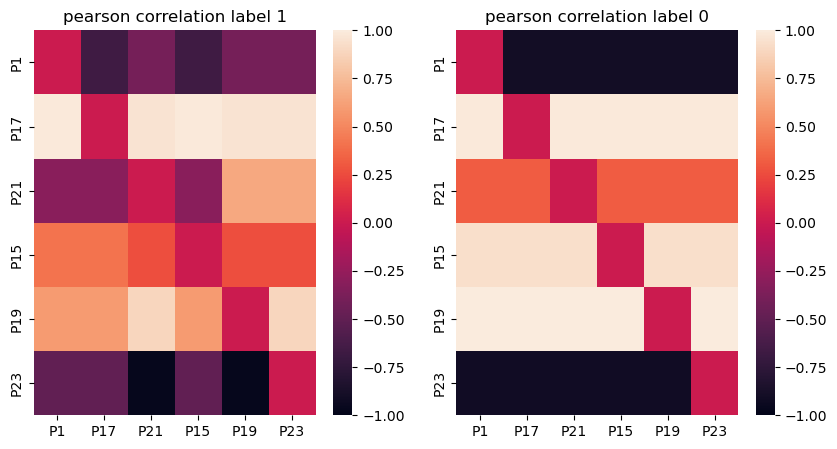

In [84]:
plt.figure(figsize=(10,5))
plt.subplot(1,2,1)
sns.heatmap(pearson_sim_1,xticklabels=participants,yticklabels=participants, vmin=-1, vmax=1)
plt.title("pearson correlation label 1")
plt.subplot(1,2,2)
sns.heatmap(pearson_sim_0,xticklabels=participants,yticklabels=participants, vmin=-1, vmax=1)
plt.title("pearson correlation label 0")


### Cosine similarity

In [85]:
cosine_sim_0 = np.zeros((len(participants),len(participants)))
cosine_sim_1 = np.zeros((len(participants),len(participants)))

for i,pt in enumerate(participants):
    for j,ps in enumerate(participants):

        if pt!=ps:
            sim = similarity[pt][ps]['Cosine Similarity']

            # calcul to change
            cosine_sim_0[i][j] = np.mean(np.diagonal(sim[1]))
            cosine_sim_1[i][j] = np.mean(np.diagonal(sim[0]))

In [86]:
cosine_sim_1

array([[  0.        ,  80.46396025,  66.92240267,  66.97830981,
         66.67726726,  66.92483288],
       [ 49.94087789,   0.        ,  38.31419011,  37.94370949,
         37.96650373,  38.05219337],
       [ 41.5848409 ,  41.5848409 ,   0.        ,  41.65983911,
         41.67111261,  41.50674864],
       [ 33.20261089,  33.20261089,  33.3044072 ,   0.        ,
         33.21905418,  33.16106241],
       [ 37.38488338,  37.38488338,  37.61939558,  37.51100547,
          0.        ,  37.67491347],
       [-49.8740492 , -49.8740492 , -49.79641219, -49.82211463,
        -49.74062018,   0.        ]])

Text(0.5, 1.0, 'cosine correlation label 0')

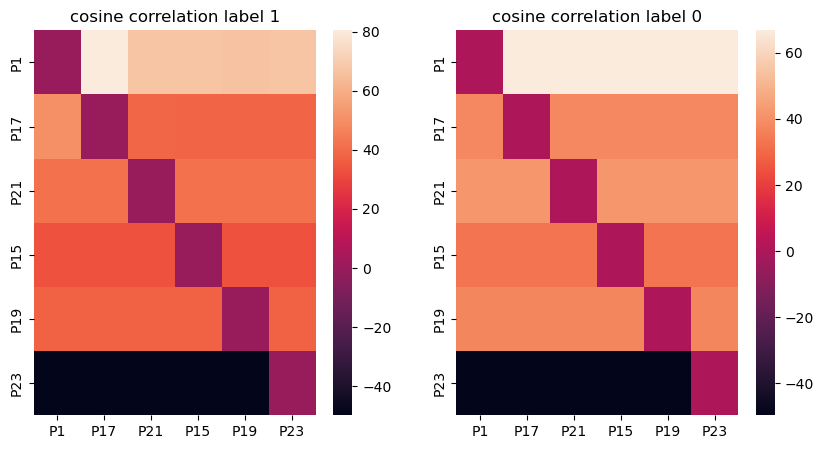

In [87]:
plt.figure(figsize=(10,5))
plt.subplot(1,2,1)
sns.heatmap(cosine_sim_1,xticklabels=participants,yticklabels=participants)
plt.title("cosine correlation label 1")
plt.subplot(1,2,2)
sns.heatmap(cosine_sim_0,xticklabels=participants,yticklabels=participants)
plt.title("cosine correlation label 0")


### Riemannian distance similarity

In [88]:
rieman_sim_0 = np.zeros((len(participants),len(participants)))
rieman_sim_1 = np.zeros((len(participants),len(participants)))

for i,pt in enumerate(participants):
    for j,ps in enumerate(participants):

        if pt!=ps:
            sim = similarity[pt][ps]['Riemannian Similarity']

            # calcul to change
            rieman_sim_0[i][j] = sim[1]
            rieman_sim_1[i][j] = sim[0]

Text(0.5, 1.0, 'rieman correlation label 0')

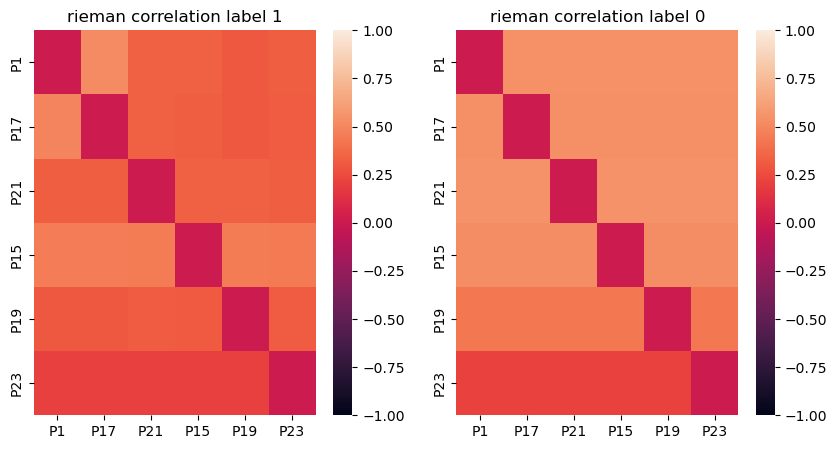

In [89]:
plt.figure(figsize=(10,5))
plt.subplot(1,2,1)
sns.heatmap(rieman_sim_1,xticklabels=participants,yticklabels=participants, vmin=-1, vmax=1)
plt.title("rieman correlation label 1")
plt.subplot(1,2,2)
sns.heatmap(rieman_sim_0,xticklabels=participants,yticklabels=participants, vmin=-1, vmax=1)
plt.title("rieman correlation label 0")


### Riemannian distance similarity

In [90]:
euclid_sim_0 = np.zeros((len(participants),len(participants)))
euclid_sim_1 = np.zeros((len(participants),len(participants)))

for i,pt in enumerate(participants):
    for j,ps in enumerate(participants):

        if pt!=ps:
            sim = similarity[pt][ps]['Euclidian Similarity']

            # calcul to change
            euclid_sim_0[i][j] = sim[1]
            euclid_sim_1[i][j] = sim[0]

Text(0.5, 1.0, 'euclid correlation label 0')

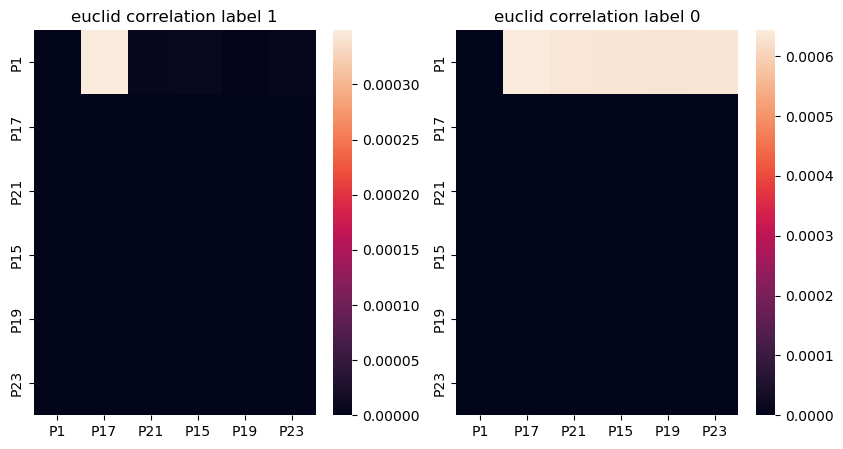

In [91]:
plt.figure(figsize=(10,5))
plt.subplot(1,2,1)
sns.heatmap(euclid_sim_1,xticklabels=participants,yticklabels=participants)
plt.title("euclid correlation label 1")
plt.subplot(1,2,2)
sns.heatmap(euclid_sim_0,xticklabels=participants,yticklabels=participants)
plt.title("euclid correlation label 0")


# VISUALISATION

## TSNE

In [62]:
files_path = "D:/s.velut/Documents/Thèse/Protheus_PHD/Data/STL/ws0.35/time_sample/Visualisation/"
n_sample = 100
data = np.load(files_path+"visualisation_soloprepoc_"+str(n_sample)+".npy")
data

array([[0.00650306, 0.8325898 ],
       [0.37189537, 0.56026113],
       [0.41419232, 0.31694224],
       ...,
       [0.27095565, 0.4925585 ],
       [0.84937966, 0.40190735],
       [0.72462004, 0.4190679 ]], dtype=float32)

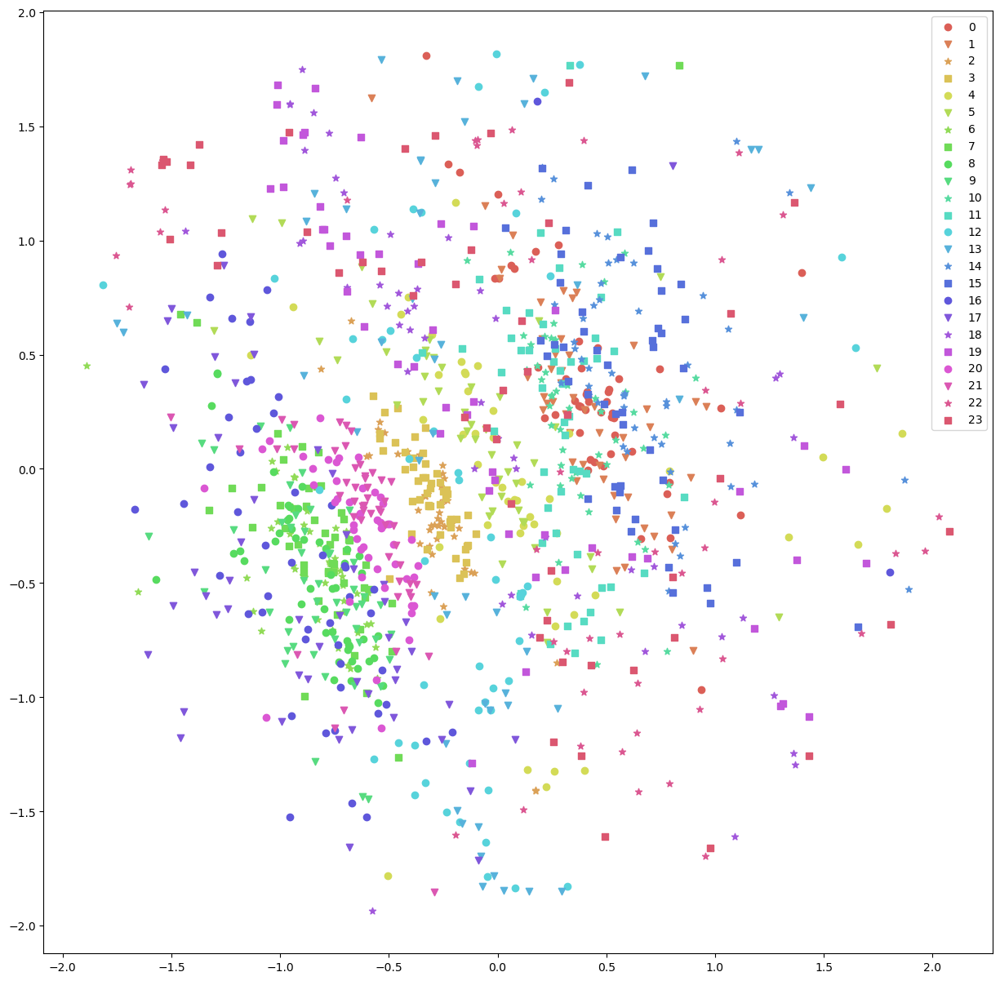

In [28]:
shape = {'0':'o','1':'v','2':'*','3':'s'}
plt.figure(figsize=(15,15))
for i,c in zip(range(24),sns.color_palette("hls", 24)):
    plt.scatter(data[i*n_sample:(i+1)*n_sample-n_sample//2,0],data[i*n_sample:(i+1)*n_sample-n_sample//2,1], color=c,label=i,marker=shape[str(i%4)])

plt.legend()

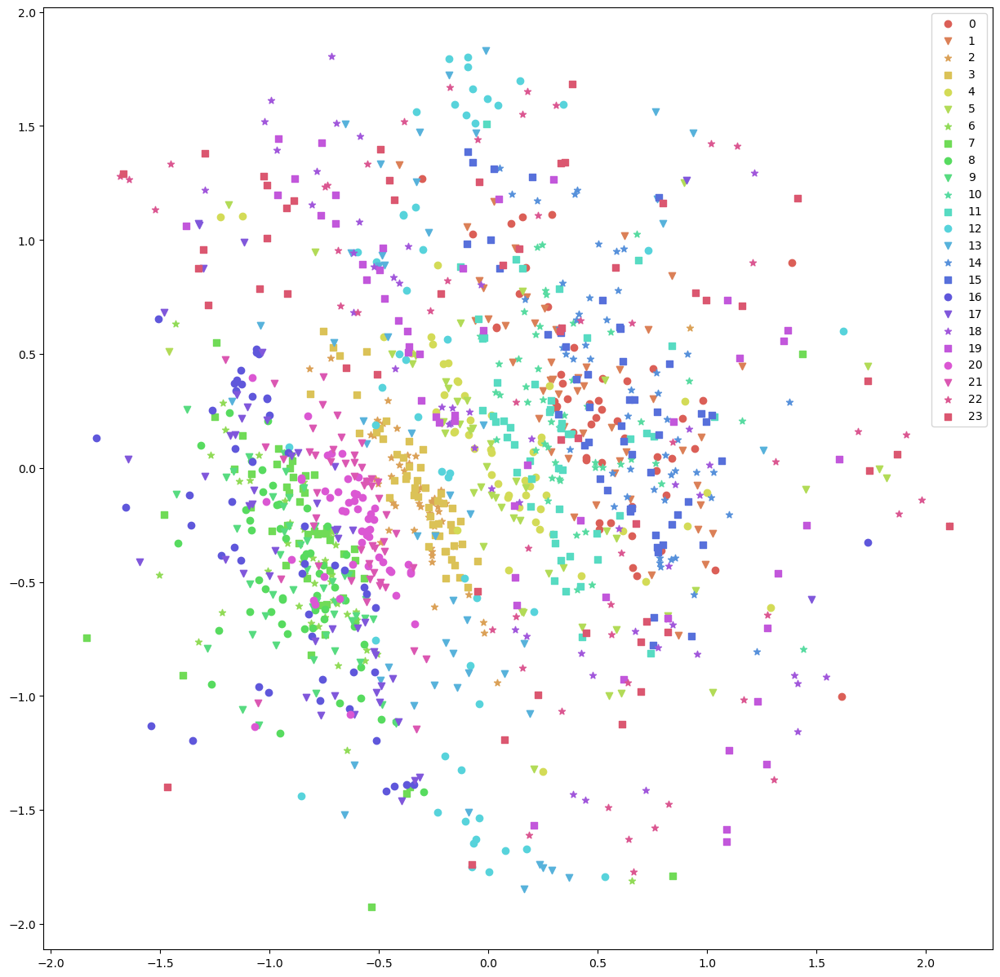

In [78]:
shape = {'0':'o','1':'v','2':'*','3':'s'}
plt.figure(figsize=(15,15))
for i,c in zip(range(24),sns.color_palette("hls", 24)):
    plt.scatter(data[i*n_sample+n_sample//2:(i+1)*n_sample,0],data[i*n_sample+n_sample//2:(i+1)*n_sample,1], color=c,label=i,marker=shape[str(i%4)])

plt.legend()

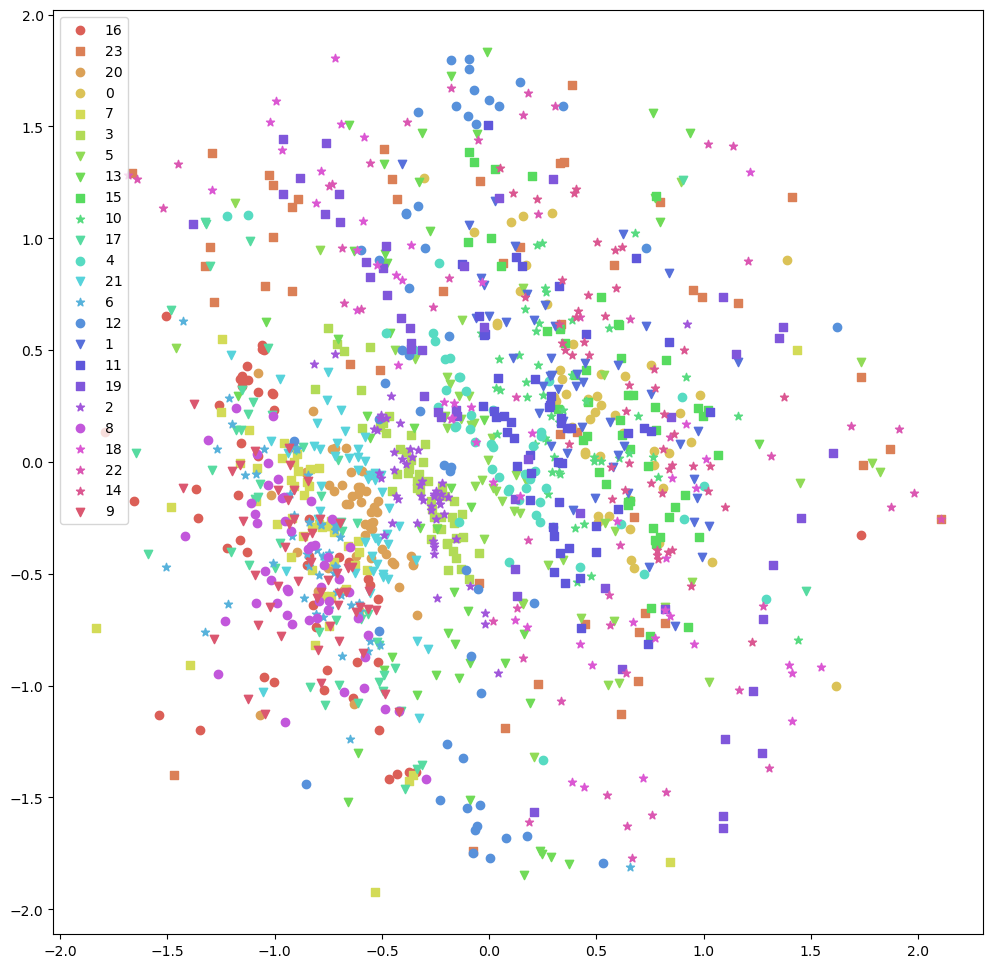

In [63]:
index_GREEN = np.argsort(-score_GREEN.sum(axis=1))
shape = {'0':'o','1':'v','2':'*','3':'s'}
plt.figure(figsize=(12,12))
for i,c in zip(index_GREEN,sns.color_palette("hls", 24)):
    plt.scatter(data[i*n_sample+n_sample//2:(i+1)*n_sample,0],data[i*n_sample+n_sample//2:(i+1)*n_sample,1], color=c,label=i,marker=shape[str(i%4)])

plt.legend()

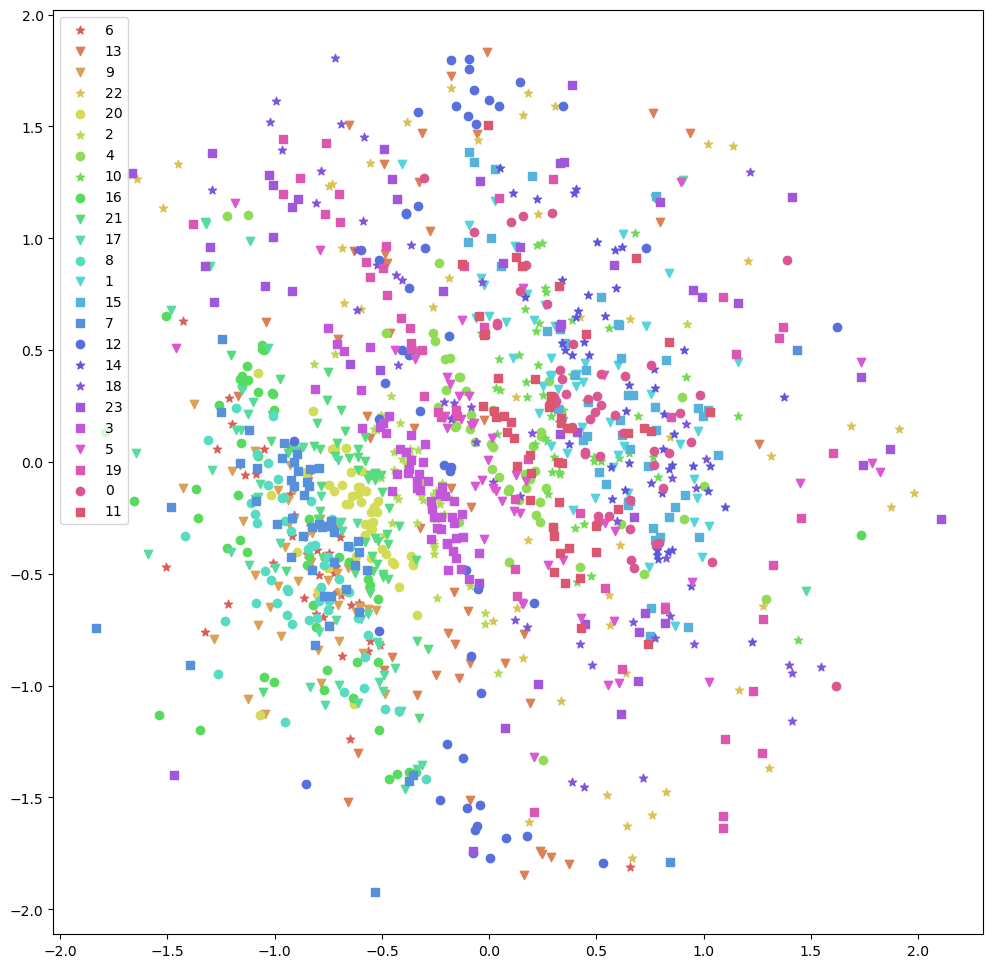

In [64]:
index_GREEN = np.argsort(-score_GREEN.sum(axis=0))
shape = {'0':'o','1':'v','2':'*','3':'s'}
plt.figure(figsize=(12,12))
for i,c in zip(index_GREEN,sns.color_palette("hls", 24)):
    plt.scatter(data[i*n_sample+n_sample//2:(i+1)*n_sample,0],data[i*n_sample+n_sample//2:(i+1)*n_sample,1], color=c,label=i,marker=shape[str(i%4)])

plt.legend()

## EPOCHS

In [39]:
files_path = "D:/s.velut/Documents/Thèse/Protheus_PHD/Data/STL/ws0.35/time_sample/data/cal_2/"
datas = np.array([np.load(files_path+"full_solo_preprocess_data_P"+str(i)+".npy") for i in range(1,25) if i!=2])
# datas[1,:,0,:] = datas[1,:,1,:]
n_subjects = datas.shape[0]


In [40]:
datas.shape

(23, 69375, 8, 175)

In [41]:
from STLDataLoader import STLDataLoader

# participants = ['P1','P2,'P3','P4','P5','P6','P7','P8','P9','P10','P11','P12','P13','P14','P15','P16','P17','P18','P19','P20','P21','P22','P23','P24']
participants = ['P1','P3','P4','P5','P6','P7','P8','P9','P10','P11','P12','P13','P14','P15','P16','P17','P18','P19','P20','P21','P22','P23','P24']
dl = STLDataLoader('D:/s.velut/Documents/Thèse/Protheus_PHD/Data/Dry_Ricker/', 1, 45, 0.35, 500, 60, "time_sample", participants, 5)
raw_data = dl.load_data()
X_parent, Y, domains, codes, labels_code = dl.get_epochs(raw_data)

Sampling frequency of the instance is already 500.0, returning unmodified.
Sampling frequency of the instance is already 500.0, returning unmodified.
Sampling frequency of the instance is already 500.0, returning unmodified.


d:\s.velut\Documents\Thèse\Protheus_PHD\Scripts\Sim_Trans_Link\STLDataLoader.py:101: RuntimeWarning: Limited 1 annotation(s) that were expanding outside the data range.
  raw_eeglab = [mne.io.read_raw_eeglab(os.path.join(self.path, '_'.join([self.participants[i], 'dryburst100.set'])), preload=True, verbose=False).resample(sfreq=self.sfreq)
d:\s.velut\Documents\Thèse\Protheus_PHD\Scripts\Sim_Trans_Link\STLDataLoader.py:101: RuntimeWarning: The data contains 'boundary' events, indicating data discontinuities. Be cautious of filtering and epoching around these events.
  raw_eeglab = [mne.io.read_raw_eeglab(os.path.join(self.path, '_'.join([self.participants[i], 'dryburst100.set'])), preload=True, verbose=False).resample(sfreq=self.sfreq)
d:\s.velut\Documents\Thèse\Protheus_PHD\Scripts\Sim_Trans_Link\STLDataLoader.py:101: RuntimeWarning: Limited 1 annotation(s) that were expanding outside the data range.
  raw_eeglab = [mne.io.read_raw_eeglab(os.path.join(self.path, '_'.join([self.particip

Sampling frequency of the instance is already 500.0, returning unmodified.
Sampling frequency of the instance is already 500.0, returning unmodified.
Sampling frequency of the instance is already 500.0, returning unmodified.


d:\s.velut\Documents\Thèse\Protheus_PHD\Scripts\Sim_Trans_Link\STLDataLoader.py:101: RuntimeWarning: Limited 1 annotation(s) that were expanding outside the data range.
  raw_eeglab = [mne.io.read_raw_eeglab(os.path.join(self.path, '_'.join([self.participants[i], 'dryburst100.set'])), preload=True, verbose=False).resample(sfreq=self.sfreq)
d:\s.velut\Documents\Thèse\Protheus_PHD\Scripts\Sim_Trans_Link\STLDataLoader.py:101: RuntimeWarning: The data contains 'boundary' events, indicating data discontinuities. Be cautious of filtering and epoching around these events.
  raw_eeglab = [mne.io.read_raw_eeglab(os.path.join(self.path, '_'.join([self.participants[i], 'dryburst100.set'])), preload=True, verbose=False).resample(sfreq=self.sfreq)
d:\s.velut\Documents\Thèse\Protheus_PHD\Scripts\Sim_Trans_Link\STLDataLoader.py:101: RuntimeWarning: The data contains 'boundary' events, indicating data discontinuities. Be cautious of filtering and epoching around these events.
  raw_eeglab = [mne.io.re

Sampling frequency of the instance is already 500.0, returning unmodified.
Sampling frequency of the instance is already 500.0, returning unmodified.
Sampling frequency of the instance is already 500.0, returning unmodified.


d:\s.velut\Documents\Thèse\Protheus_PHD\Scripts\Sim_Trans_Link\STLDataLoader.py:101: RuntimeWarning: Limited 1 annotation(s) that were expanding outside the data range.
  raw_eeglab = [mne.io.read_raw_eeglab(os.path.join(self.path, '_'.join([self.participants[i], 'dryburst100.set'])), preload=True, verbose=False).resample(sfreq=self.sfreq)
d:\s.velut\Documents\Thèse\Protheus_PHD\Scripts\Sim_Trans_Link\STLDataLoader.py:101: RuntimeWarning: The data contains 'boundary' events, indicating data discontinuities. Be cautious of filtering and epoching around these events.
  raw_eeglab = [mne.io.read_raw_eeglab(os.path.join(self.path, '_'.join([self.participants[i], 'dryburst100.set'])), preload=True, verbose=False).resample(sfreq=self.sfreq)
d:\s.velut\Documents\Thèse\Protheus_PHD\Scripts\Sim_Trans_Link\STLDataLoader.py:101: RuntimeWarning: Limited 1 annotation(s) that were expanding outside the data range.
  raw_eeglab = [mne.io.read_raw_eeglab(os.path.join(self.path, '_'.join([self.particip

Sampling frequency of the instance is already 500.0, returning unmodified.
Sampling frequency of the instance is already 500.0, returning unmodified.
Sampling frequency of the instance is already 500.0, returning unmodified.


d:\s.velut\Documents\Thèse\Protheus_PHD\Scripts\Sim_Trans_Link\STLDataLoader.py:101: RuntimeWarning: Limited 1 annotation(s) that were expanding outside the data range.
  raw_eeglab = [mne.io.read_raw_eeglab(os.path.join(self.path, '_'.join([self.participants[i], 'dryburst100.set'])), preload=True, verbose=False).resample(sfreq=self.sfreq)
d:\s.velut\Documents\Thèse\Protheus_PHD\Scripts\Sim_Trans_Link\STLDataLoader.py:101: RuntimeWarning: The data contains 'boundary' events, indicating data discontinuities. Be cautious of filtering and epoching around these events.
  raw_eeglab = [mne.io.read_raw_eeglab(os.path.join(self.path, '_'.join([self.participants[i], 'dryburst100.set'])), preload=True, verbose=False).resample(sfreq=self.sfreq)
d:\s.velut\Documents\Thèse\Protheus_PHD\Scripts\Sim_Trans_Link\STLDataLoader.py:101: RuntimeWarning: Limited 1 annotation(s) that were expanding outside the data range.
  raw_eeglab = [mne.io.read_raw_eeglab(os.path.join(self.path, '_'.join([self.particip

Sampling frequency of the instance is already 500.0, returning unmodified.
Sampling frequency of the instance is already 500.0, returning unmodified.
Sampling frequency of the instance is already 500.0, returning unmodified.


d:\s.velut\Documents\Thèse\Protheus_PHD\Scripts\Sim_Trans_Link\STLDataLoader.py:101: RuntimeWarning: Limited 1 annotation(s) that were expanding outside the data range.
  raw_eeglab = [mne.io.read_raw_eeglab(os.path.join(self.path, '_'.join([self.participants[i], 'dryburst100.set'])), preload=True, verbose=False).resample(sfreq=self.sfreq)
d:\s.velut\Documents\Thèse\Protheus_PHD\Scripts\Sim_Trans_Link\STLDataLoader.py:101: RuntimeWarning: The data contains 'boundary' events, indicating data discontinuities. Be cautious of filtering and epoching around these events.
  raw_eeglab = [mne.io.read_raw_eeglab(os.path.join(self.path, '_'.join([self.participants[i], 'dryburst100.set'])), preload=True, verbose=False).resample(sfreq=self.sfreq)
d:\s.velut\Documents\Thèse\Protheus_PHD\Scripts\Sim_Trans_Link\STLDataLoader.py:101: RuntimeWarning: Limited 1 annotation(s) that were expanding outside the data range.
  raw_eeglab = [mne.io.read_raw_eeglab(os.path.join(self.path, '_'.join([self.particip

Sampling frequency of the instance is already 500.0, returning unmodified.
Sampling frequency of the instance is already 500.0, returning unmodified.
Sampling frequency of the instance is already 500.0, returning unmodified.
Sampling frequency of the instance is already 500.0, returning unmodified.


d:\s.velut\Documents\Thèse\Protheus_PHD\Scripts\Sim_Trans_Link\STLDataLoader.py:101: RuntimeWarning: Limited 1 annotation(s) that were expanding outside the data range.
  raw_eeglab = [mne.io.read_raw_eeglab(os.path.join(self.path, '_'.join([self.participants[i], 'dryburst100.set'])), preload=True, verbose=False).resample(sfreq=self.sfreq)
d:\s.velut\Documents\Thèse\Protheus_PHD\Scripts\Sim_Trans_Link\STLDataLoader.py:101: RuntimeWarning: The data contains 'boundary' events, indicating data discontinuities. Be cautious of filtering and epoching around these events.
  raw_eeglab = [mne.io.read_raw_eeglab(os.path.join(self.path, '_'.join([self.participants[i], 'dryburst100.set'])), preload=True, verbose=False).resample(sfreq=self.sfreq)
d:\s.velut\Documents\Thèse\Protheus_PHD\Scripts\Sim_Trans_Link\STLDataLoader.py:101: RuntimeWarning: Limited 1 annotation(s) that were expanding outside the data range.
  raw_eeglab = [mne.io.read_raw_eeglab(os.path.join(self.path, '_'.join([self.particip

Sampling frequency of the instance is already 500.0, returning unmodified.
Sampling frequency of the instance is already 500.0, returning unmodified.
Sampling frequency of the instance is already 500.0, returning unmodified.


d:\s.velut\Documents\Thèse\Protheus_PHD\Scripts\Sim_Trans_Link\STLDataLoader.py:101: RuntimeWarning: Limited 1 annotation(s) that were expanding outside the data range.
  raw_eeglab = [mne.io.read_raw_eeglab(os.path.join(self.path, '_'.join([self.participants[i], 'dryburst100.set'])), preload=True, verbose=False).resample(sfreq=self.sfreq)
d:\s.velut\Documents\Thèse\Protheus_PHD\Scripts\Sim_Trans_Link\STLDataLoader.py:101: RuntimeWarning: The data contains 'boundary' events, indicating data discontinuities. Be cautious of filtering and epoching around these events.
  raw_eeglab = [mne.io.read_raw_eeglab(os.path.join(self.path, '_'.join([self.participants[i], 'dryburst100.set'])), preload=True, verbose=False).resample(sfreq=self.sfreq)
d:\s.velut\Documents\Thèse\Protheus_PHD\Scripts\Sim_Trans_Link\STLDataLoader.py:101: RuntimeWarning: Limited 1 annotation(s) that were expanding outside the data range.
  raw_eeglab = [mne.io.read_raw_eeglab(os.path.join(self.path, '_'.join([self.particip

Sampling frequency of the instance is already 500.0, returning unmodified.


d:\s.velut\Documents\Thèse\Protheus_PHD\Scripts\Sim_Trans_Link\STLDataLoader.py:101: RuntimeWarning: Limited 1 annotation(s) that were expanding outside the data range.
  raw_eeglab = [mne.io.read_raw_eeglab(os.path.join(self.path, '_'.join([self.participants[i], 'dryburst100.set'])), preload=True, verbose=False).resample(sfreq=self.sfreq)
d:\s.velut\Documents\Thèse\Protheus_PHD\Scripts\Sim_Trans_Link\STLDataLoader.py:101: RuntimeWarning: The data contains 'boundary' events, indicating data discontinuities. Be cautious of filtering and epoching around these events.
  raw_eeglab = [mne.io.read_raw_eeglab(os.path.join(self.path, '_'.join([self.participants[i], 'dryburst100.set'])), preload=True, verbose=False).resample(sfreq=self.sfreq)


Using data from preloaded Raw for 75 events and 1101 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 75 events and 1101 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 75 events and 1101 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 75 events and 1101 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 75 events and 1101 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 75 events and 1101 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 75 events and 1101 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 75 events and 1101 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 75 events and 1101 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 75 events and 1101 original time points ...
0 bad epochs dropped
Using data

In [42]:
datas = datas[:,:9250]
Y = Y[:,:9250]
channel = 0

### Evoked

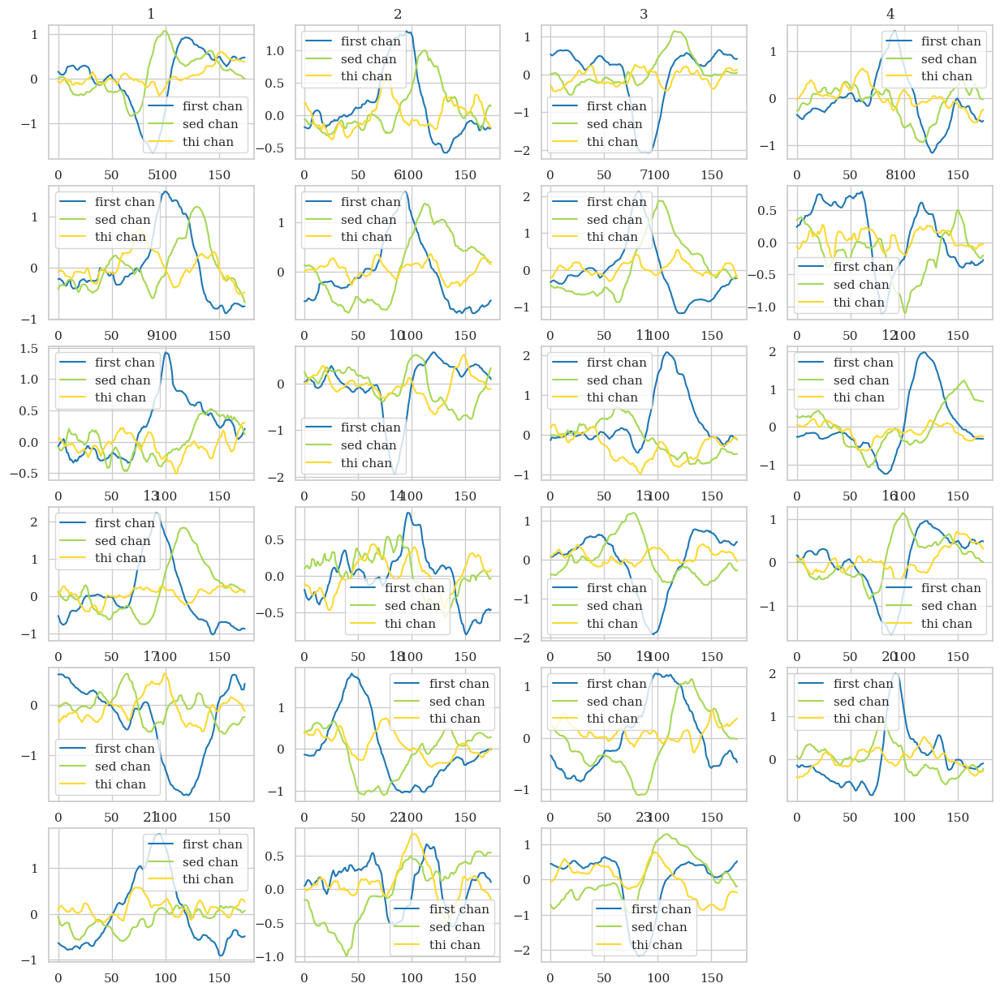

In [43]:
plt.figure(1,figsize=(15,15))
for i in range(n_subjects):
    plt.subplot(6,4,i+1)
    c = sns.color_palette("tab20", 20)[0]
    c2 = sns.color_palette("tab20", 20)[10]
    col = sns.color_palette('Set2')
    
    # plt.plot(np.median(datas[i][Y[i]==0][:18500],axis=0)[channel],c=c2)
    # plt.plot(np.median(datas[i][Y[i]==0],axis=0)[channel+1],c=col[0])
    # plt.plot(np.median(datas[i][Y[i]==0],axis=0)[channel+2],c=col[1])
    plt.plot(np.median(datas[i][Y[i]==1],axis=0)[channel],c=c,label="first chan")
    plt.plot(np.median(datas[i][Y[i]==1],axis=0)[channel+1],c=col[4],label="sed chan")
    plt.plot(np.median(datas[i][Y[i]==1],axis=0)[channel+2],c=col[5],label="thi chan")
    plt.title(i+1)
    plt.legend()

In [44]:
datas.shape

(23, 9250, 8, 175)

<Axes: >

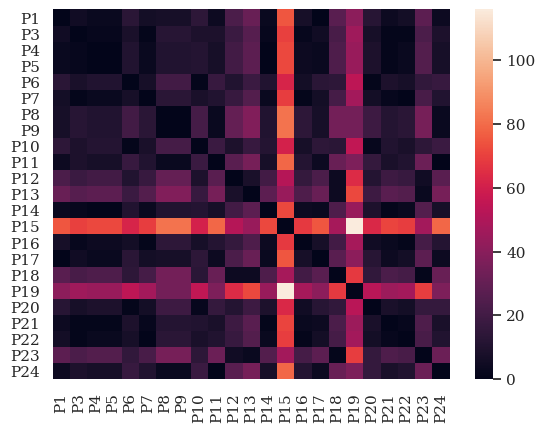

In [45]:
dpicmax = np.zeros((n_subjects,n_subjects))
dpicmin = np.zeros((n_subjects,n_subjects))

for i in range(n_subjects):
    for j in range(n_subjects):
        dpicmax[i,j] = np.abs(np.argmax(np.abs(np.mean(datas[i][Y[i]==1,channel,:],axis=0))) - np.argmax(np.abs(np.mean(datas[j][Y[j]==1,channel,:],axis=0))))
        dpicmin[i,j] = np.abs(np.argmin(np.mean(datas[i][Y[i]==1,channel,:],axis=0)) - np.argmin(np.mean(datas[j][Y[j]==1,channel,:],axis=0)))
sns.heatmap(dpicmax,xticklabels=participants,yticklabels=participants)

<Axes: >

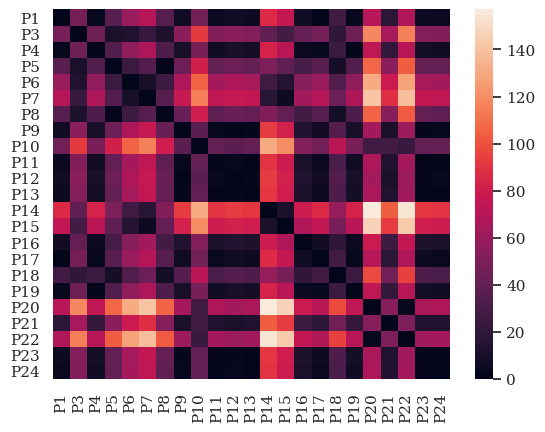

In [46]:
sns.heatmap(dpicmin,xticklabels=participants,yticklabels=participants)

<Axes: >

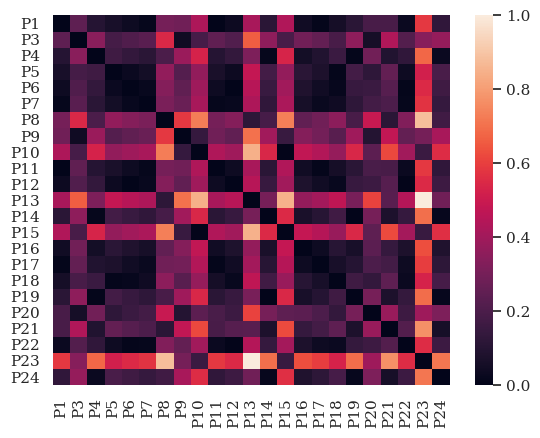

In [47]:
damp = np.zeros((n_subjects,n_subjects))

for i in range(n_subjects):
    for j in range(n_subjects):
        damp[i,j] = np.abs((np.max(np.mean(datas[i][Y[i]==1,channel,:],axis=0)) - np.min(np.mean(datas[i][Y[i]==1,channel,:],axis=0))) - (np.max(np.mean(datas[j][Y[j]==1,channel,:],axis=0)) - np.min(np.mean(datas[j][Y[j]==1,channel,:],axis=0))))

sns.heatmap(damp/np.max(damp),xticklabels=participants,yticklabels=participants)

In [48]:
# depochs = np.zeros((24,24))

# for i in range(24):
#     for j in range(24):
#         depochs[i,j] = 1/np.log(np.mean(stats.spearmanr(np.median(datas[i,Y[i]==1,:],axis=0),np.median(datas[j,Y[j]==1,:],axis=0),axis=1).statistic))
#         # depochs[i,j] = distance(np.cov(datas[i,Y[i]==1,0]),
#         #                         np.cov(datas[j,Y[j]==1,0]),metric="euclid")
# sns.heatmap(depochs,xticklabels=participants,yticklabels=participants)

### Inter Quartile Range

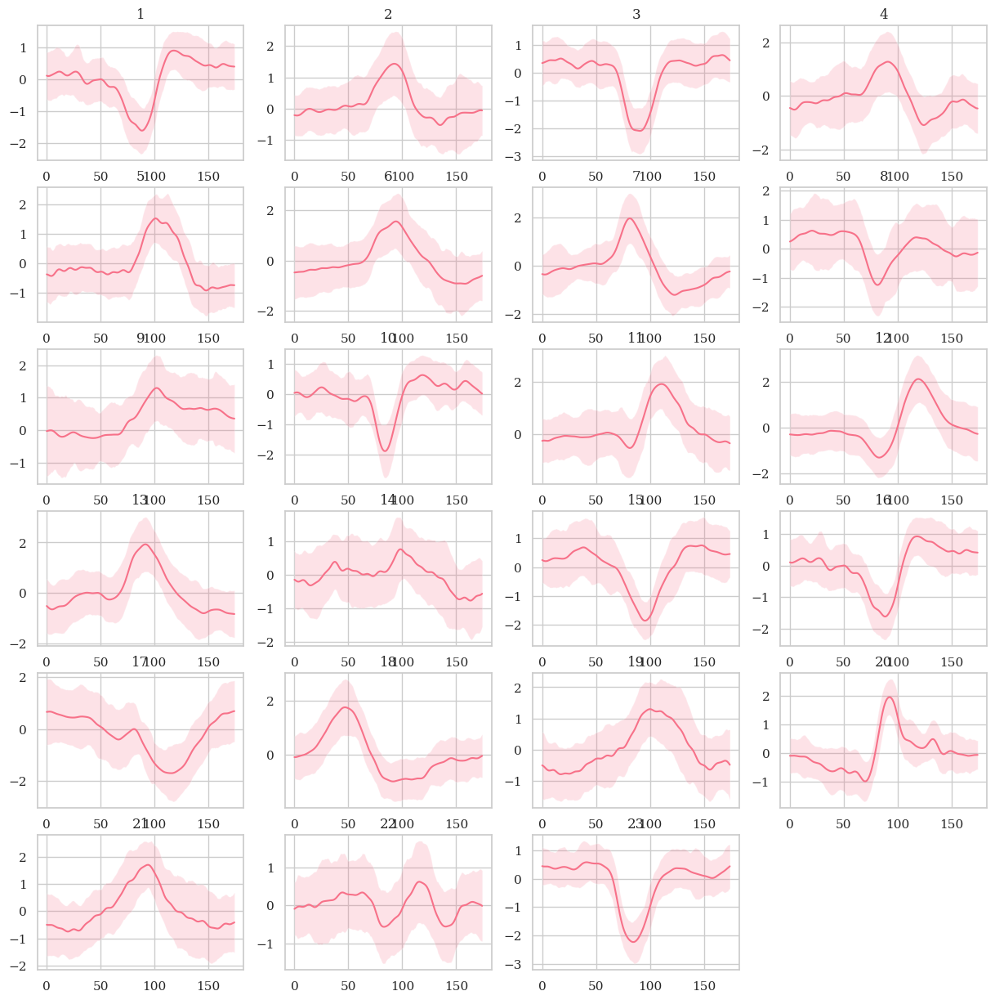

In [49]:
plt.figure(1,figsize=(15,15))
s = np.zeros((n_subjects,datas.shape[-1]))
iqr = np.zeros((n_subjects,datas.shape[-1]))
# iqr_c2 = np.zeros((n_subjects,datas.shape[-1]))
# iqr_c3 = np.zeros((n_subjects,datas.shape[-1]))
# iqr_c4 = np.zeros((n_subjects,datas.shape[-1]))
for i in range(n_subjects):
    axes = plt.subplot(6,4,i+1)
    c = sns.color_palette("tab20", 20)[0]
    c2 = sns.color_palette("tab20", 20)[1]
    col = sns.color_palette('Set2')

    d = np.mean(datas[i][Y[i]==1][:,channel,:],axis=0)
    std = np.std(datas[i][Y[i]==1][:,channel,:],axis=0)
    dist_iq = np.percentile(datas[i][Y[i]==1][:,channel,:], 75,axis=0) - np.percentile(datas[i][Y[i]==1][:,channel,:], 25,axis=0)
    cis = (d-dist_iq/2,d+dist_iq/2)
    plt.fill_between(np.arange(175),cis[0],cis[1], alpha=0.2)
    plt.plot(d)
    plt.title(i+1)

    s[i] = std
    iqr[i] = dist_iq
    # iqr_c2[i] = np.percentile(datas[i][Y[i]==1,1,:], 75,axis=0) - np.percentile(datas[i][Y[i]==1,1,:], 25,axis=0)
    # iqr_c3[i] = np.percentile(datas[i][Y[i]==1,2,:], 75,axis=0) - np.percentile(datas[i][Y[i]==1,2,:], 25,axis=0)
    # iqr_c4[i] = np.percentile(datas[i][Y[i]==1,3,:], 75,axis=0) - np.percentile(datas[i][Y[i]==1,3,:], 25,axis=0)


In [50]:
# riqr = compute_covariances(np.concatenate([iqr,iqr_c2,iqr_c3,iqr_c4],axis=0).reshape(-1,4,175))
# diqr = np.zeros((n_subjects,n_subjects))

# for i in range(n_subjects):
#     diqr[:,i] = distance(riqr,riqr[i])[:,0]
# sns.heatmap(normalize(normalize(diqr),axis=0), xticklabels=participants,yticklabels=participants)

<Axes: >

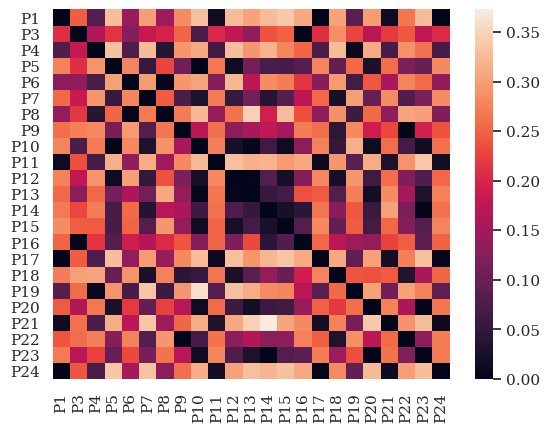

In [51]:
diqr = np.zeros((n_subjects,n_subjects))
for i in range(n_subjects):
    for j in range((n_subjects)):
        diqr[i,j] = np.abs(np.median(iqr[i]-iqr[j]))

sns.heatmap(normalize(normalize(diqr),axis=0), xticklabels=participants,yticklabels=participants)

### Correlation matrix

In [52]:
datas[i][Y[i]==1][:,0]

array([[ 2.14875507,  1.90282188,  1.64610818, ..., -1.90892326,
        -1.99622873, -1.99550584],
       [ 1.89406767,  1.63974256,  1.36399893, ..., -1.99175435,
        -1.9917594 , -1.89905907],
       [ 1.63225638,  1.35827751,  1.06631925, ..., -1.98786256,
        -1.89616893, -1.71909299],
       ...,
       [-0.04541782,  0.20806016,  0.5529406 , ...,  0.60397102,
         0.85046905,  1.16770466],
       [ 0.20788455,  0.55287186,  0.90418876, ...,  0.85052193,
         1.16750972,  1.44328523],
       [ 0.55269319,  0.903944  ,  1.16564508, ...,  1.16714338,
         1.44213079,  1.58268218]])

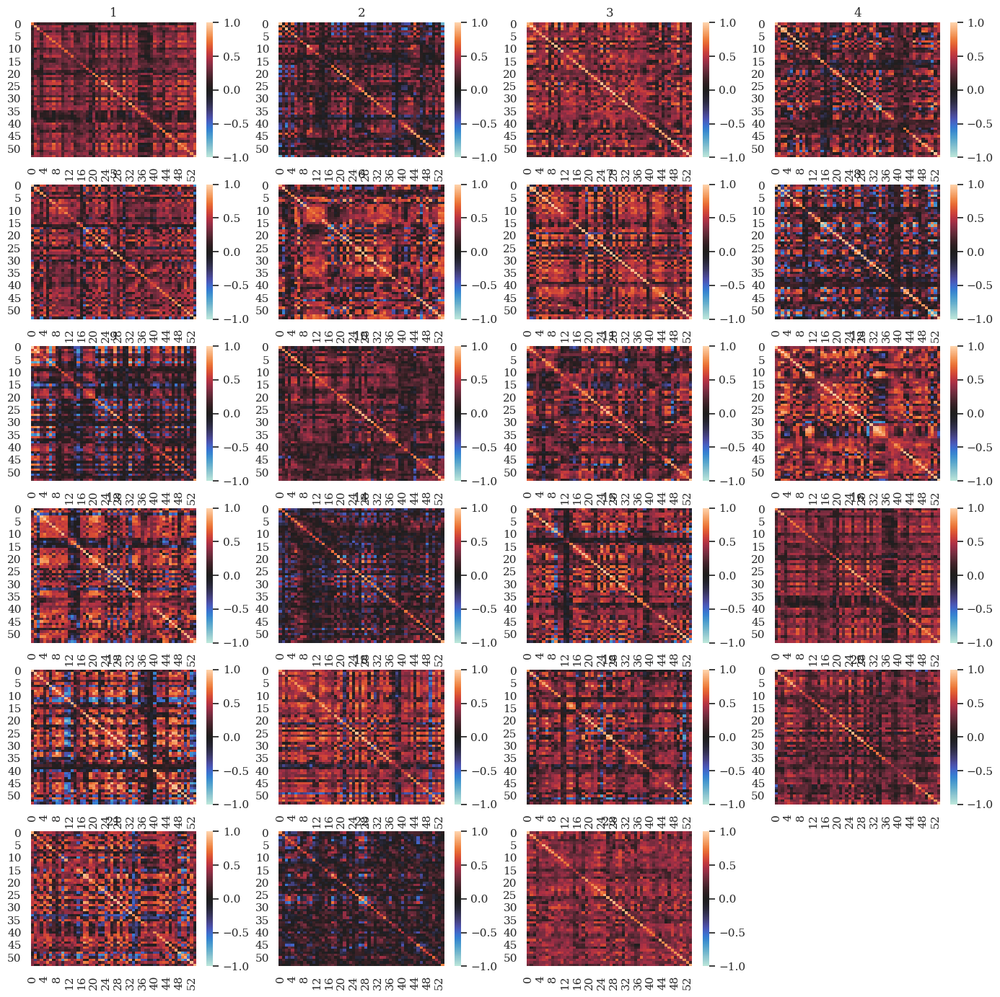

In [53]:
import math


m = np.zeros(n_subjects)
# m2 = np.zeros(n_subjects)
all_m = np.zeros((n_subjects,math.ceil(datas[0][Y[i]==1].shape[0]/8)))
all_cm = np.zeros((n_subjects,math.ceil(datas[0][Y[i]==1].shape[0]/8),math.ceil(datas[0][Y[i]==1].shape[0]/8)))
# all_cm2 = np.zeros((n_subjects,math.ceil(datas[0][Y[i]==1].shape[0]/8),math.ceil(datas[0][Y[i]==1].shape[0]/8)))
# all_cm3 = np.zeros((n_subjects,math.ceil(datas[0][Y[i]==1].shape[0]/8),math.ceil(datas[0][Y[i]==1].shape[0]/8))) 
# all_cm4 = np.zeros((n_subjects,math.ceil(datas[0][Y[i]==1].shape[0]/8),math.ceil(datas[0][Y[i]==1].shape[0]/8))) 
all_m2 = np.zeros((n_subjects,math.ceil(datas[0][Y[i]==1].shape[0]/8),math.ceil(datas[0][Y[i]==1].shape[0]/8)))
plt.figure(1,figsize=(17,17))
for i in range(n_subjects):
    plt.subplot(6,4,i+1)
    
    corr = stats.spearmanr(datas[i][Y[i]==1][:,channel],axis=1)
    # corr_c2 = stats.spearmanr(datas[i][Y[i]==1][:,1],axis=1)
    # corr_c3 = stats.spearmanr(datas[i][Y[i]==1][:,2],axis=1)
    # corr_c4 = stats.spearmanr(datas[i][Y[i]==1][:,3],axis=1)

    arr_reduced = block_reduce(corr.statistic, block_size=(8,8), func=np.median, cval=np.median(corr))
    sns.heatmap(arr_reduced,cmap='icefire', vmin=-1.0,vmax=1.0)

    m[i] = np.median(arr_reduced)
    all_cm[i] = arr_reduced
    # m2[i] = np.mean(np.abs(arr_reduced))
    all_m[i] = np.median(arr_reduced, axis=0)
    # all_cm2[i] = block_reduce(corr_c2.statistic, block_size=(8,8), func=np.median, cval=np.median(corr_c2))
    # all_cm3[i] = block_reduce(corr_c3.statistic, block_size=(8,8), func=np.median, cval=np.median(corr_c3))
    # all_cm4[i] = block_reduce(corr_c4.statistic, block_size=(8,8), func=np.median, cval=np.median(corr_c4))
    all_m2[i] = np.median(np.abs(arr_reduced), axis=0)
    
    plt.title(str(i+1))

plt.show()

<Axes: >

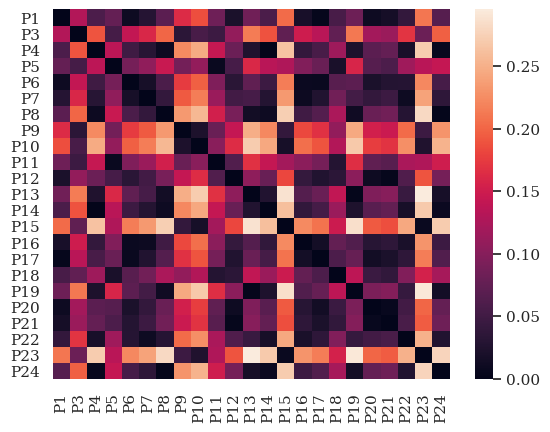

In [54]:
dicmdif = np.zeros((n_subjects,n_subjects))

for i in range(n_subjects):
    for j in range(n_subjects):
        dicmdif[i,j] = np.abs(np.median((all_cm[i])) - np.median((all_cm[j])))
sns.heatmap(dicmdif,xticklabels=participants,yticklabels=participants)

In [55]:
# ricmr = compute_covariances(np.concatenate([all_cm,all_cm2,all_cm3,all_cm4],axis=0).reshape(-1,4,405*405))
# dicmr = np.zeros((n_subjects,n_subjects))

# for i in range(n_subjects):
#     dicmr[:,i] = distance(ricmr,ricmr[i])[:,0]
# sns.heatmap(normalize(normalize(dicmr),axis=0), xticklabels=participants,yticklabels=participants)

<Axes: >

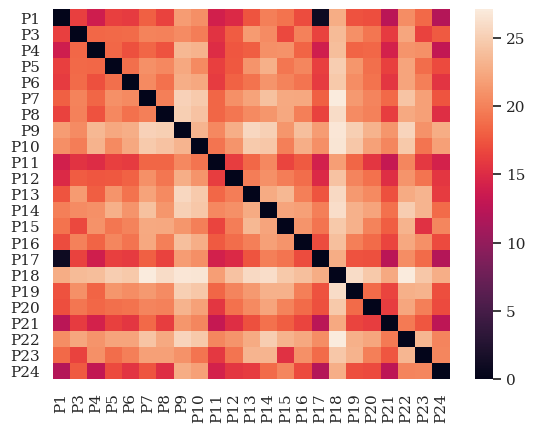

In [56]:
dicm = np.zeros((n_subjects,n_subjects))
for i in range(n_subjects):
    dicm[i,:] = distance(all_cm,all_cm[i],metric="euclid")[:,0]

sns.heatmap(dicm,xticklabels=participants,yticklabels=participants)

In [57]:
print(np.argsort(m)+1)#,np.argsort(m2)+1)

[22 14  9  8  2 10  4 17 11 20 19  1 16  5 15  6 21 13  3 23  7 18 12]


In [58]:
m[np.argsort(m)]

array([0.07397727, 0.08119514, 0.09904445, 0.12120242, 0.15468428,
       0.20087998, 0.2082266 , 0.22895656, 0.26327866, 0.26783139,
       0.27447828, 0.28487965, 0.28880934, 0.29595555, 0.30447604,
       0.31434057, 0.32522503, 0.34277653, 0.34475034, 0.35107199,
       0.3541133 , 0.36673421, 0.36908195])

### GIF

MovieWriter ffmpeg unavailable; using Pillow instead.


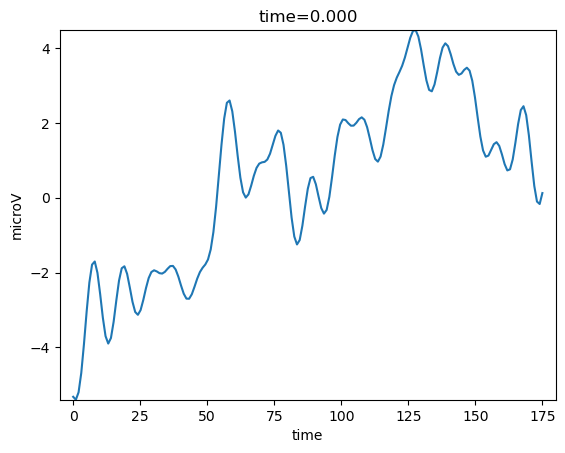

In [50]:
import functools
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation

sujet = 12


fig, ax = plt.subplots()
ax.set_xlabel("time")
ax.set_xlim([-5, 180])

ax.set_ylabel("microV")
# ax.set_ylim([-2.5, 2.5])
d = datas[sujet-1][Y[sujet-1]==1]

def update2d(frame, ax, line, xdata, ydata, tdata, anim=False):
    if line is None:
        line, = ax.plot(xdata, ydata[frame, :])
    line.set_data(xdata, ydata[frame, :])
    ax.set_ylim(ydata[frame, :].min(),ydata[frame, :].max())
    ax.set_title(f"time={tdata[frame]:.3f}")
    return line,

line, = update2d(0, ax, None, np.linspace(0,d.shape[2],d.shape[2]), d[:,0,:], np.linspace(0,d.shape[0],d.shape[0]), True)

update_anim = functools.partial(update2d, ax=ax, line=line, 
                                xdata=np.linspace(0,d.shape[2],d.shape[2]), ydata=d[:,0,:], tdata=np.linspace(0,d.shape[0],d.shape[0]), anim=True)
ani = FuncAnimation(fig, update_anim, 400, interval=50, blit=False)
ani.save('D:/s.velut/Documents/Thèse/Protheus_PHD/Scripts/Sim_Trans_Link/gif/test'+str(sujet)+'.gif')
# plt.show()

In [51]:
from IPython.display import HTML
HTML(ani.to_jshtml())

### Riemannian distance

In [59]:


mr = np.zeros((n_subjects,8,8))
dmr = np.zeros((n_subjects,n_subjects))
for i in range(n_subjects):
    mr[i] = mean_covariance(compute_covariances(datas[i,Y[i]==1], estimator='lwf'), metric='riemann')

for i in range(n_subjects):
    dmr[:,i] = distance(mr,mr[i])[:,0]



<Axes: >

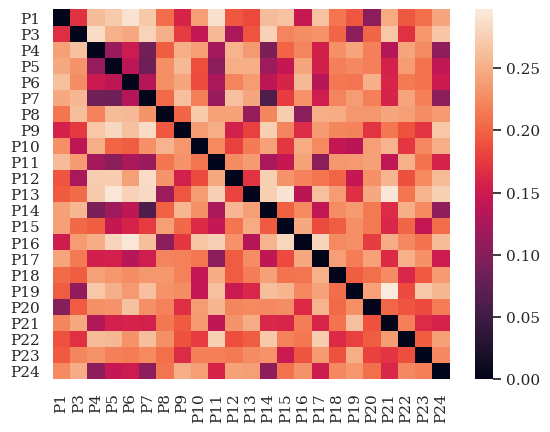

In [60]:
sns.heatmap(normalize(normalize(dmr),axis=0), xticklabels=participants,yticklabels=participants)

# Affinity Propagation

In [325]:
# files_path = "D:/s.velut/Documents/Thèse/Protheus_PHD/Data/STL/ws0.35/time_sample/data/"
# datas = np.array([np.load(files_path+"full_solo_preprocess_data_P"+str(i)+".npy") for i in range(1,25)])
# datas[1,:,0,:] = datas[1,:,1,:]

# from STLDataLoader import STLDataLoader

# participants = ['P1','P2','P3','P4','P5','P6','P7','P8','P9','P10','P11','P12','P13','P14','P15','P16','P17','P18','P19','P20','P21','P22','P23','P24']
# dl = STLDataLoader('D:/s.velut/Documents/Thèse/Protheus_PHD/Data/Dry_Ricker/', 1, 45, 0.35, 500, 60, "time_sample", participants, 5)
# raw_data = dl.load_data()
# X, Y, domains, codes, labels_code = dl.get_epochs(raw_data)

In [ ]:
sujet = 10
af = AffinityPropagation(preference=None, random_state=2, max_iter=1000,affinity='precomputed')
# temp = np.array([np.mean(datas[i][Y[i]==1,0,:],axis=0) for i in range(24)])

# temp = np.concatenate([np.array([np.mean(datas[i][Y[i]==1,0,:],axis=0) for i in range(24)]),np.array([np.mean(datas[i][Y[i]==1,1,:],axis=0) for i in range(24)]),np.array([np.mean(datas[i][Y[i]==1,2,:],axis=0) for i in range(24)])],axis=1)
# temp = np.concatenate([np.array([np.mean(datas[i][Y[i]==1,0,:],axis=0) for i in range(24)]),np.array([np.std(datas[i][Y[i]==1,0,:],axis=0) for i in range(24)])],axis=1)

# temp = np.concatenate([all_m,np.array([np.mean(datas[i][Y[i]==1,0,:],axis=0) for i in range(24)])],axis=1)
# temp = np.concatenate([normalize(all_m,axis=0),
#                        normalize(iqr,axis=0),
#                        normalize(np.array([np.median(datas[i][Y[i]==1,0,:],axis=0) for i in range(24)]),axis=0), 
#                        ],axis=1)

# temp = normalize(normalize(dmr),axis=0)+normalize(normalize(diqr),axis=0)+normalize(normalize(dicm),axis=0)+normalize(normalize(dpicmax),axis=0)+normalize(normalize(dpicmin),axis=0)+normalize(normalize(damp),axis=0)
# temp = normalize(normalize(depochs),axis=0)+normalize(normalize(dmr),axis=0)+normalize(normalize(diqr),axis=0)+normalize(normalize(dicm),axis=0)7
temp = 1/np.exp(dmr/np.max(dmr))+1/np.exp(diqr/np.max(diqr))+1/np.exp(dicmdif/np.max(dicmdif))+1/np.exp(damp/np.max(damp))

# temp[1] = np.mean(datas[i][Y[i]==1,1,:],axis=0)
# temp = np.concatenate([normalize(np.array(s).reshape(-1,1),axis=0),normalize(np.array(m2).reshape(-1,1),axis=0),time_max,time_min, amp,max, min],axis=1)

af = af.fit(temp)

cluster_centers_indices = af.cluster_centers_indices_
labels = af.labels_

n_clusters_ = len(cluster_centers_indices)
print(n_clusters_)
temp.shape

6


(24, 24)

In [ ]:
info = [(labels[i],participants[i]) for i in range(24)]
info

[(4, 'P1'),
 (0, 'P2'),
 (1, 'P3'),
 (5, 'P4'),
 (1, 'P5'),
 (5, 'P6'),
 (1, 'P7'),
 (4, 'P8'),
 (2, 'P9'),
 (2, 'P10'),
 (1, 'P11'),
 (1, 'P12'),
 (3, 'P13'),
 (1, 'P14'),
 (2, 'P15'),
 (3, 'P16'),
 (4, 'P17'),
 (1, 'P18'),
 (3, 'P19'),
 (1, 'P20'),
 (5, 'P21'),
 (3, 'P22'),
 (2, 'P23'),
 (5, 'P24')]

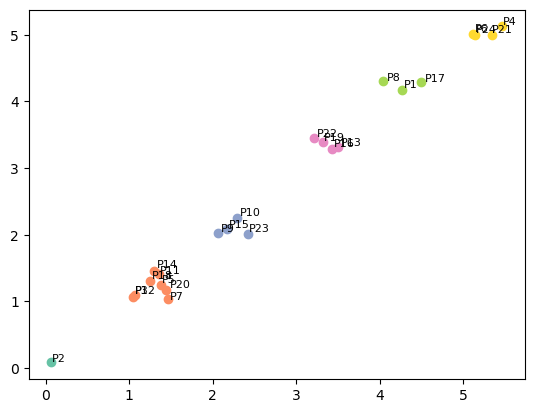

In [ ]:
plt.close("all")
plt.figure(2)

colors = sns.color_palette('Set2', n_clusters_)


for i,cluster_info in enumerate(info):
    cluster,p = cluster_info
    point = (cluster+np.random.random()*0.5,cluster+np.random.random()*0.5)
    plt.scatter(point[0],point[1],color=colors[cluster])
    plt.annotate(p,(point[0]+np.random.random()*0.05,point[1]+np.random.random()*0.05),fontsize=8)

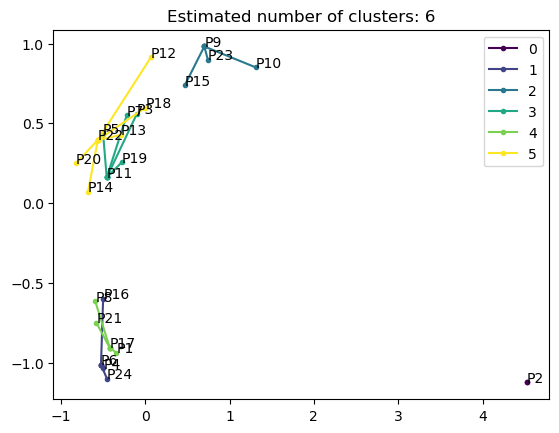

In [278]:
plt.close("all")
plt.figure(1)
plt.clf()

colors = plt.cycler("color", plt.cm.viridis(np.linspace(0, 1, n_clusters_)))

maPCA = sklearn.decomposition.PCA(n_components=3)
maPCA.fit(temp)
temp_trans = maPCA.transform(temp)


for k, col in zip(range(n_clusters_), colors):
    class_members = labels == k
    cluster_center = temp_trans[cluster_centers_indices[k]]
    for i,x in enumerate(temp_trans[class_members]):
        plt.plot(
            [cluster_center[0], x[0]], [cluster_center[1], x[1]], color=col["color"],label=k, marker='.'
        )
        plt.annotate(np.array(participants)[class_members][i],(x[0],x[1]+0.001))
handles, lab = plt.gca().get_legend_handles_labels()
by_label = dict(zip(lab, handles))
plt.legend(by_label.values(), by_label.keys())

plt.title("Estimated number of clusters: %d" % n_clusters_)
# plt.legend()
plt.show()

<Axes: >

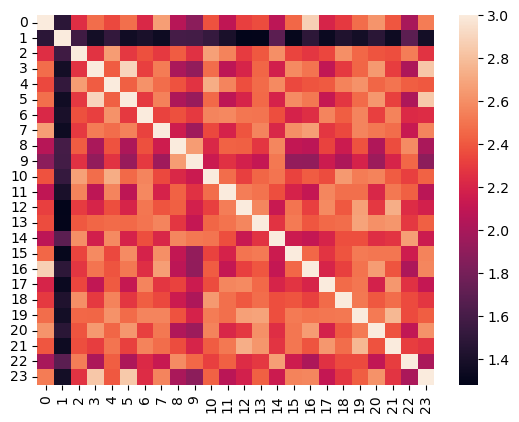

In [279]:
sns.heatmap(temp)

# Dendogramme

C:\Users\s.velut\AppData\Local\Temp\ipykernel_32964\1059742496.py:7: ClusterWarning: scipy.cluster: The symmetric non-negative hollow observation matrix looks suspiciously like an uncondensed distance matrix
  Z = hierarchy.linkage(temp, 'average')


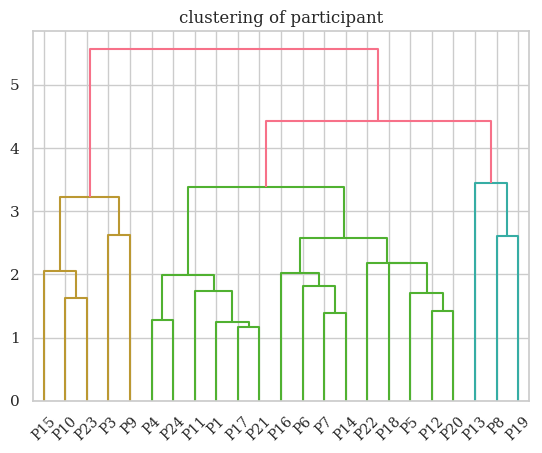

In [67]:
from scipy.cluster import hierarchy


# temp = 1/np.exp(dmr/np.max(dmr))+1/np.exp(diqr/np.max(diqr))+1/np.exp(dicmdif/np.max(dicmdif))+1/np.exp(damp/np.max(damp))+1/np.exp(dpicmax/np.max(dpicmax))
temp =(dmr/np.max(dmr))+(diqr/np.max(diqr))+(dicmdif/np.max(dicmdif))+(damp/np.max(damp))+(dpicmax/np.max(dpicmax))

Z = hierarchy.linkage(temp, 'average')
fig, ax = plt.subplots()
dn = hierarchy.dendrogram(Z)
ax.set_xticklabels([participants[int(item.get_text())] for item in ax.get_xticklabels()])
plt.title("clustering of participant")
plt.show()

# Predict score

In [93]:
from STLDataLoader import STLDataLoader

files_path = "D:/s.velut/Documents/Thèse/Protheus_PHD/Data/STL/ws0.35/time_sample/data/"
datas = np.array([np.load(files_path+"full_solo_preprocess_data_P"+str(i)+".npy") for i in range(1,25)])

participants = ['P1','P2','P3','P4','P5','P6','P7','P8','P9','P10','P11','P12','P13','P14','P15','P16','P17','P18','P19','P20','P21','P22','P23','P24']
dl = STLDataLoader('D:/s.velut/Documents/Thèse/Protheus_PHD/Data/Dry_Ricker/', 1, 45, 0.35, 500, 60, "time_sample", participants, 5)
raw_data = dl.load_data()
X_parent, Y, domains, codes, labels_code = dl.get_epochs(raw_data)
nb_sample = 500*(2.2-0.35)*5*1

part_datas = np.concatenate(np.array([datas[:,int(i*nb_sample):int((i+1)*nb_sample)] for i in range(15)]),axis=0)
part_Y = np.concatenate(np.array([Y[:,int(i*nb_sample):int((i+1)*nb_sample)] for i in range(15)]),axis=0)

Sampling frequency of the instance is already 500.0, returning unmodified.
Sampling frequency of the instance is already 500.0, returning unmodified.


d:\s.velut\Documents\Thèse\Protheus_PHD\Scripts\Sim_Trans_Link\STLDataLoader.py:101: RuntimeWarning: Limited 1 annotation(s) that were expanding outside the data range.
  raw_eeglab = [mne.io.read_raw_eeglab(os.path.join(self.path, '_'.join([self.participants[i], 'dryburst100.set'])), preload=True, verbose=False).resample(sfreq=self.sfreq)
d:\s.velut\Documents\Thèse\Protheus_PHD\Scripts\Sim_Trans_Link\STLDataLoader.py:101: RuntimeWarning: The data contains 'boundary' events, indicating data discontinuities. Be cautious of filtering and epoching around these events.
  raw_eeglab = [mne.io.read_raw_eeglab(os.path.join(self.path, '_'.join([self.participants[i], 'dryburst100.set'])), preload=True, verbose=False).resample(sfreq=self.sfreq)
d:\s.velut\Documents\Thèse\Protheus_PHD\Scripts\Sim_Trans_Link\STLDataLoader.py:101: RuntimeWarning: Limited 1 annotation(s) that were expanding outside the data range.
  raw_eeglab = [mne.io.read_raw_eeglab(os.path.join(self.path, '_'.join([self.particip

Sampling frequency of the instance is already 500.0, returning unmodified.
Sampling frequency of the instance is already 500.0, returning unmodified.
Sampling frequency of the instance is already 500.0, returning unmodified.


d:\s.velut\Documents\Thèse\Protheus_PHD\Scripts\Sim_Trans_Link\STLDataLoader.py:101: RuntimeWarning: Limited 1 annotation(s) that were expanding outside the data range.
  raw_eeglab = [mne.io.read_raw_eeglab(os.path.join(self.path, '_'.join([self.participants[i], 'dryburst100.set'])), preload=True, verbose=False).resample(sfreq=self.sfreq)
d:\s.velut\Documents\Thèse\Protheus_PHD\Scripts\Sim_Trans_Link\STLDataLoader.py:101: RuntimeWarning: The data contains 'boundary' events, indicating data discontinuities. Be cautious of filtering and epoching around these events.
  raw_eeglab = [mne.io.read_raw_eeglab(os.path.join(self.path, '_'.join([self.participants[i], 'dryburst100.set'])), preload=True, verbose=False).resample(sfreq=self.sfreq)
d:\s.velut\Documents\Thèse\Protheus_PHD\Scripts\Sim_Trans_Link\STLDataLoader.py:101: RuntimeWarning: Limited 1 annotation(s) that were expanding outside the data range.
  raw_eeglab = [mne.io.read_raw_eeglab(os.path.join(self.path, '_'.join([self.particip

Sampling frequency of the instance is already 500.0, returning unmodified.
Sampling frequency of the instance is already 500.0, returning unmodified.
Sampling frequency of the instance is already 500.0, returning unmodified.


d:\s.velut\Documents\Thèse\Protheus_PHD\Scripts\Sim_Trans_Link\STLDataLoader.py:101: RuntimeWarning: The data contains 'boundary' events, indicating data discontinuities. Be cautious of filtering and epoching around these events.
  raw_eeglab = [mne.io.read_raw_eeglab(os.path.join(self.path, '_'.join([self.participants[i], 'dryburst100.set'])), preload=True, verbose=False).resample(sfreq=self.sfreq)
d:\s.velut\Documents\Thèse\Protheus_PHD\Scripts\Sim_Trans_Link\STLDataLoader.py:101: RuntimeWarning: Limited 1 annotation(s) that were expanding outside the data range.
  raw_eeglab = [mne.io.read_raw_eeglab(os.path.join(self.path, '_'.join([self.participants[i], 'dryburst100.set'])), preload=True, verbose=False).resample(sfreq=self.sfreq)
d:\s.velut\Documents\Thèse\Protheus_PHD\Scripts\Sim_Trans_Link\STLDataLoader.py:101: RuntimeWarning: The data contains 'boundary' events, indicating data discontinuities. Be cautious of filtering and epoching around these events.
  raw_eeglab = [mne.io.re

Sampling frequency of the instance is already 500.0, returning unmodified.
Sampling frequency of the instance is already 500.0, returning unmodified.


d:\s.velut\Documents\Thèse\Protheus_PHD\Scripts\Sim_Trans_Link\STLDataLoader.py:101: RuntimeWarning: Limited 1 annotation(s) that were expanding outside the data range.
  raw_eeglab = [mne.io.read_raw_eeglab(os.path.join(self.path, '_'.join([self.participants[i], 'dryburst100.set'])), preload=True, verbose=False).resample(sfreq=self.sfreq)
d:\s.velut\Documents\Thèse\Protheus_PHD\Scripts\Sim_Trans_Link\STLDataLoader.py:101: RuntimeWarning: The data contains 'boundary' events, indicating data discontinuities. Be cautious of filtering and epoching around these events.
  raw_eeglab = [mne.io.read_raw_eeglab(os.path.join(self.path, '_'.join([self.participants[i], 'dryburst100.set'])), preload=True, verbose=False).resample(sfreq=self.sfreq)
d:\s.velut\Documents\Thèse\Protheus_PHD\Scripts\Sim_Trans_Link\STLDataLoader.py:101: RuntimeWarning: Limited 1 annotation(s) that were expanding outside the data range.
  raw_eeglab = [mne.io.read_raw_eeglab(os.path.join(self.path, '_'.join([self.particip

Sampling frequency of the instance is already 500.0, returning unmodified.
Sampling frequency of the instance is already 500.0, returning unmodified.
Sampling frequency of the instance is already 500.0, returning unmodified.


d:\s.velut\Documents\Thèse\Protheus_PHD\Scripts\Sim_Trans_Link\STLDataLoader.py:101: RuntimeWarning: Limited 1 annotation(s) that were expanding outside the data range.
  raw_eeglab = [mne.io.read_raw_eeglab(os.path.join(self.path, '_'.join([self.participants[i], 'dryburst100.set'])), preload=True, verbose=False).resample(sfreq=self.sfreq)
d:\s.velut\Documents\Thèse\Protheus_PHD\Scripts\Sim_Trans_Link\STLDataLoader.py:101: RuntimeWarning: The data contains 'boundary' events, indicating data discontinuities. Be cautious of filtering and epoching around these events.
  raw_eeglab = [mne.io.read_raw_eeglab(os.path.join(self.path, '_'.join([self.participants[i], 'dryburst100.set'])), preload=True, verbose=False).resample(sfreq=self.sfreq)
d:\s.velut\Documents\Thèse\Protheus_PHD\Scripts\Sim_Trans_Link\STLDataLoader.py:101: RuntimeWarning: Limited 1 annotation(s) that were expanding outside the data range.
  raw_eeglab = [mne.io.read_raw_eeglab(os.path.join(self.path, '_'.join([self.particip

Sampling frequency of the instance is already 500.0, returning unmodified.
Sampling frequency of the instance is already 500.0, returning unmodified.
Sampling frequency of the instance is already 500.0, returning unmodified.


d:\s.velut\Documents\Thèse\Protheus_PHD\Scripts\Sim_Trans_Link\STLDataLoader.py:101: RuntimeWarning: Limited 1 annotation(s) that were expanding outside the data range.
  raw_eeglab = [mne.io.read_raw_eeglab(os.path.join(self.path, '_'.join([self.participants[i], 'dryburst100.set'])), preload=True, verbose=False).resample(sfreq=self.sfreq)
d:\s.velut\Documents\Thèse\Protheus_PHD\Scripts\Sim_Trans_Link\STLDataLoader.py:101: RuntimeWarning: The data contains 'boundary' events, indicating data discontinuities. Be cautious of filtering and epoching around these events.
  raw_eeglab = [mne.io.read_raw_eeglab(os.path.join(self.path, '_'.join([self.participants[i], 'dryburst100.set'])), preload=True, verbose=False).resample(sfreq=self.sfreq)
d:\s.velut\Documents\Thèse\Protheus_PHD\Scripts\Sim_Trans_Link\STLDataLoader.py:101: RuntimeWarning: Limited 1 annotation(s) that were expanding outside the data range.
  raw_eeglab = [mne.io.read_raw_eeglab(os.path.join(self.path, '_'.join([self.particip

Sampling frequency of the instance is already 500.0, returning unmodified.
Sampling frequency of the instance is already 500.0, returning unmodified.
Sampling frequency of the instance is already 500.0, returning unmodified.


d:\s.velut\Documents\Thèse\Protheus_PHD\Scripts\Sim_Trans_Link\STLDataLoader.py:101: RuntimeWarning: Limited 1 annotation(s) that were expanding outside the data range.
  raw_eeglab = [mne.io.read_raw_eeglab(os.path.join(self.path, '_'.join([self.participants[i], 'dryburst100.set'])), preload=True, verbose=False).resample(sfreq=self.sfreq)
d:\s.velut\Documents\Thèse\Protheus_PHD\Scripts\Sim_Trans_Link\STLDataLoader.py:101: RuntimeWarning: The data contains 'boundary' events, indicating data discontinuities. Be cautious of filtering and epoching around these events.
  raw_eeglab = [mne.io.read_raw_eeglab(os.path.join(self.path, '_'.join([self.participants[i], 'dryburst100.set'])), preload=True, verbose=False).resample(sfreq=self.sfreq)
d:\s.velut\Documents\Thèse\Protheus_PHD\Scripts\Sim_Trans_Link\STLDataLoader.py:101: RuntimeWarning: Limited 1 annotation(s) that were expanding outside the data range.
  raw_eeglab = [mne.io.read_raw_eeglab(os.path.join(self.path, '_'.join([self.particip

Sampling frequency of the instance is already 500.0, returning unmodified.
Sampling frequency of the instance is already 500.0, returning unmodified.
Sampling frequency of the instance is already 500.0, returning unmodified.


d:\s.velut\Documents\Thèse\Protheus_PHD\Scripts\Sim_Trans_Link\STLDataLoader.py:101: RuntimeWarning: Limited 1 annotation(s) that were expanding outside the data range.
  raw_eeglab = [mne.io.read_raw_eeglab(os.path.join(self.path, '_'.join([self.participants[i], 'dryburst100.set'])), preload=True, verbose=False).resample(sfreq=self.sfreq)
d:\s.velut\Documents\Thèse\Protheus_PHD\Scripts\Sim_Trans_Link\STLDataLoader.py:101: RuntimeWarning: The data contains 'boundary' events, indicating data discontinuities. Be cautious of filtering and epoching around these events.
  raw_eeglab = [mne.io.read_raw_eeglab(os.path.join(self.path, '_'.join([self.participants[i], 'dryburst100.set'])), preload=True, verbose=False).resample(sfreq=self.sfreq)
d:\s.velut\Documents\Thèse\Protheus_PHD\Scripts\Sim_Trans_Link\STLDataLoader.py:101: RuntimeWarning: Limited 1 annotation(s) that were expanding outside the data range.
  raw_eeglab = [mne.io.read_raw_eeglab(os.path.join(self.path, '_'.join([self.particip

Sampling frequency of the instance is already 500.0, returning unmodified.
Sampling frequency of the instance is already 500.0, returning unmodified.


d:\s.velut\Documents\Thèse\Protheus_PHD\Scripts\Sim_Trans_Link\STLDataLoader.py:101: RuntimeWarning: Limited 1 annotation(s) that were expanding outside the data range.
  raw_eeglab = [mne.io.read_raw_eeglab(os.path.join(self.path, '_'.join([self.participants[i], 'dryburst100.set'])), preload=True, verbose=False).resample(sfreq=self.sfreq)
d:\s.velut\Documents\Thèse\Protheus_PHD\Scripts\Sim_Trans_Link\STLDataLoader.py:101: RuntimeWarning: The data contains 'boundary' events, indicating data discontinuities. Be cautious of filtering and epoching around these events.
  raw_eeglab = [mne.io.read_raw_eeglab(os.path.join(self.path, '_'.join([self.participants[i], 'dryburst100.set'])), preload=True, verbose=False).resample(sfreq=self.sfreq)
d:\s.velut\Documents\Thèse\Protheus_PHD\Scripts\Sim_Trans_Link\STLDataLoader.py:101: RuntimeWarning: Limited 1 annotation(s) that were expanding outside the data range.
  raw_eeglab = [mne.io.read_raw_eeglab(os.path.join(self.path, '_'.join([self.particip

Using data from preloaded Raw for 75 events and 1101 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 75 events and 1101 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 75 events and 1101 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 75 events and 1101 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 75 events and 1101 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 75 events and 1101 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 75 events and 1101 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 75 events and 1101 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 75 events and 1101 original time points ...
0 bad epochs dropped
Using data from preloaded Raw for 75 events and 1101 original time points ...
0 bad epochs dropped
Using data

In [94]:
iqr = np.zeros(part_Y.shape[0])
tiqr = np.zeros(part_Y.shape[0])
m = np.zeros(part_Y.shape[0])
picmax = np.zeros(part_Y.shape[0])
picmin = np.zeros(part_Y.shape[0])
amp = np.zeros(part_Y.shape[0])
channel = 0

for i in range(part_Y.shape[0]):

    d = np.mean(part_datas[i][part_Y[i]==1][:,channel,:],axis=0)
    dist_iq = np.percentile(part_datas[i][part_Y[i]==1][:,channel,:], 75,axis=0) - np.percentile(part_datas[i][part_Y[i]==1][:,channel,:], 25,axis=0)
    tiqr[i] = np.median(np.percentile(part_datas[i][part_Y[i]==1][:,channel,:], 75,axis=0))
    iqr[i] = np.median(np.percentile(part_datas[i][part_Y[i]==1][:,channel,:], 25,axis=0))

    corr = stats.spearmanr(part_datas[i][part_Y[i]==1][:,channel],axis=1)
    arr_reduced = block_reduce(corr.statistic, block_size=(8,8), func=np.median, cval=np.median(corr))
    m[i] = np.median(arr_reduced)

    picmax[i] = np.argmax((np.mean(part_datas[i][part_Y[i]==1,channel,:],axis=0)))
    picmin[i] = np.argmin((np.mean(part_datas[i][part_Y[i]==1,channel,:],axis=0)))

    amp[i] = np.abs(np.max(np.mean(part_datas[i][part_Y[i]==1,channel,:],axis=0)) - np.min(np.mean(part_datas[i][part_Y[i]==1,channel,:],axis=0)))

features = np.transpose(np.array([iqr,tiqr,m,picmax,picmin,amp]))
labels = np.repeat(score_PTGREEN.sum(axis=1),15)
labels_clf = np.repeat(score_PTGREEN.sum(axis=1)>0.8*24,15)

## Regression

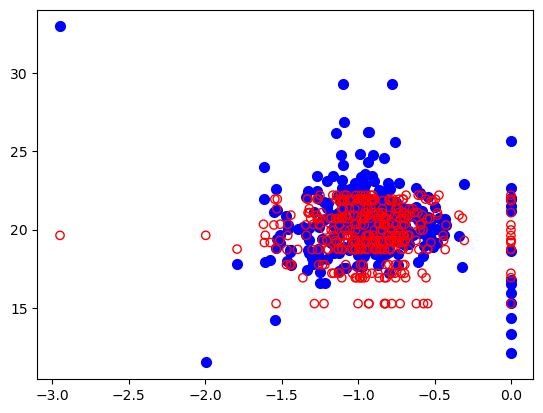

In [89]:
from sklearn.svm import SVR

reg = SVR(kernel='poly', C=1, gamma='scale', degree=5, epsilon=.0001, coef0=25)
reg.fit(features,labels)
pred = reg.predict(features)

ordonne = np.linspace(1,24,24)
fig, ax = plt.subplots()
ax.scatter(features[:,0], pred[:], lw=2,color='b')
ax.scatter(features[reg.support_][:,0], labels[reg.support_][:], facecolor="none", color='r')

In [74]:
features[13:18]

array([[-1.34256598e+00,  9.28282636e-01,  2.92597403e-01,
         1.03000000e+02,  1.71000000e+02,  2.40831397e+00],
       [-1.04913054e+00,  9.61172327e-01,  9.79265562e-02,
         9.90000000e+01,  1.54000000e+02,  1.63369577e+00],
       [-6.33503890e-01,  1.10217747e+00,  2.51146440e-01,
         1.35000000e+02,  9.60000000e+01,  2.42969402e+00],
       [-8.39675389e-01,  5.88664265e-01,  2.73331841e-01,
         8.90000000e+01,  1.22000000e+02,  2.43031145e+00],
       [-1.18048824e+00,  1.07520833e+00,  2.08078818e-01,
         1.10000000e+02,  1.74000000e+02,  2.22227751e+00]])

## Classification

In [97]:
from sklearn.svm import SVC
from sklearn.discriminant_analysis import LinearDiscriminantAnalysis as LDA
from sklearn.metrics import balanced_accuracy_score

clf = SVC(C=1000,kernel="poly")
# clf = LDA()
clf = clf.fit(features,labels_clf)

pred_clf = clf.predict(features)
balanced_accuracy_score(pred_clf,labels_clf)

c:\Users\s.velut\AppData\Local\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


0.6666666666666666

## Classification with epochs

In [97]:
part_datas.shape

(360, 4625, 8, 175)

In [99]:
temp_data = np.zeros((part_datas.shape[0],part_datas.shape[2],part_datas.shape[3]))

for i in range(part_Y.shape[0]):

    temp_data[i][0] = np.mean(part_datas[i][part_Y[i]==1][0],axis=0)
    temp_data[i][1] = np.mean(part_datas[i][part_Y[i]==1][1],axis=0)
    temp_data[i][2] = np.mean(part_datas[i][part_Y[i]==1][2],axis=0)
    temp_data[i][3] = np.mean(part_datas[i][part_Y[i]==1][3],axis=0)
    temp_data[i][4] = np.percentile(part_datas[i][part_Y[i]==1][:,0,:], 75,axis=0)-np.percentile(part_datas[i][part_Y[i]==1][:,0,:], 25,axis=0)
    temp_data[i][5] = np.percentile(part_datas[i][part_Y[i]==1][:,1,:], 75,axis=0)-np.percentile(part_datas[i][part_Y[i]==1][:,1,:], 25,axis=0)
    temp_data[i][6] = np.percentile(part_datas[i][part_Y[i]==1][:,2,:], 75,axis=0)-np.percentile(part_datas[i][part_Y[i]==1][:,2,:], 25,axis=0)
    temp_data[i][7] = np.percentile(part_datas[i][part_Y[i]==1][:,3,:], 75,axis=0)-np.percentile(part_datas[i][part_Y[i]==1][:,3,:], 25,axis=0)

In [122]:
from sklearn.model_selection import train_test_split
from sklearn.metrics import balanced_accuracy_score
from EEG2CodeKeras import EEG2Code
import keras

x_train,x_test,y_train,y_test = train_test_split(temp_data,labels_clf,test_size=0.2,shuffle=True)
model=SVC()
x_train = x_train.reshape(-1,8*175)
x_test = x_test.reshape(-1,8*175)
# optimizer = keras.optimizers.Adam(learning_rate=0.001, amsgrad=True)
# model = EEG2Code(windows_size = x_train[0].shape[-1],
#                                          n_channel_input = x_train[0].shape[-2],
#                                          optimizer=optimizer,
#                                          num_epochs=100)
model = model.fit(x_train, (y_train))


balanced_accuracy_score(model.predict(x_test)>0.5,y_test)

c:\Users\s.velut\AppData\Local\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:2480: UserWarning: y_pred contains classes not in y_true
  warnings.warn("y_pred contains classes not in y_true")


0.6666666666666666